## Single-cell signaling and morphodynamic analysis 2D pipeline

In [47]:
%%capture
#load up packages needed
import numpy as np
import matplotlib.pyplot as plt
import sys
sys.path.insert(0,'/home/groups/ZuckermanLab/copperma/cell/celltraj/celltraj')
import os
import pathlib
import imageprep as imprep
import trajectory as trajectory
import utilities as utilities
import features as features
import translate as translate
import model
import pyemma.coordinates as coor
np.float=np.dtype(float)
np.int=int
import msmtools
import umap
import scipy
from scipy.sparse import csr_matrix
from scipy.sparse.csgraph import connected_components
import pickle
import matplotlib
import sklearn
import skimage.io
from IPython.display import clear_output
import os
import pandas
import seaborn as sns
import string
import ray #comment out this line, and any @ray decorators and use commented non-ray commands, if you would like to run this serially without ray parallelization
import nd2
from cellpose import models

#### Step 1: Load and organize the image data
##### Establish channels, imaging parameters, and object parameters-- use NIS AR or other software first to gather info

In [2]:
imagefile = '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/density.nd2' #path to nd2 image file

In [ ]:
imgs = nd2.imread(imagefile,dask=True)
print(imgs.shape) #image from NIS is t,xy,channel,x,y
imgs=np.swapaxes(imgs,0,1) #nd2 comes with an awkward channel order, rearranging
print(imgs.shape)
imgs=np.swapaxes(imgs,2,4) #nd2 comes with an awkward channel order, rearranging
print(imgs.shape) #image is now xy,t,x,y,channel
nxy,nt,nx,ny,nchannel=imgs.shape

In [3]:
#if you already deleted nd2 file and are rerunning
nxy=128

In [4]:
modelName = f'20240620_T4density2D_MCL1_N2' #results will be saved/named using this string
ind_xy = np.arange(nxy).astype(int)
#ind_xy = np.array([0,1,2,3]).astype(int) #choose xys for analysis. If all, use ind_xy = np.arange(nxy).astype(int)
nuc_channel=0 #nuclear channel
rep_channel=2 #reporter channel (ERK here)
bf_channel=None #bright-field channel
channels = ['DAPI','mCherry','YFP'] #names for channels in plots
channel_colors = ['blue','red','green'] #colors for channels in plots
channel_dict=dict([(x, i) for i, x in enumerate(channels)])
micron_per_pixel=.67 #lateral resolution (image pixel size)
nucl=20 #typical nucleus linear diameter pixels
timestep=.16666 #time between frames in hours

#### Step 2: Create cellpose training data
Probably in 2D, you can skip this, models are pretty robust, but worth checking

In [54]:
trainpath='/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/cellpose_trainingdata'
bf_channel=1 #(in this example it isn't bright-field, but we will just use it for the extra signaling channel for cellpose)
nt_train=2;
train_times=np.linspace(0,nt-1,nt_train).astype(int)
pathexists = os.path.isdir(trainpath) #create training folder if it doesn't exist already
if not pathexists:
    os.mkdir(trainpath)

itrain=0

In [ ]:
for ixy in range(ind_xy.size):
    for itt in range(nt_train):
        iframe=train_times[itt]
        img=imgs[ixy,itt,:,:,:].compute()
        cellpose_img=np.zeros((3,nx,ny)).astype(np.uint16)
        cellpose_img[0,:,:]=img[:,:,bf_channel]
        cellpose_img[1,:,:]=img[:,:,rep_channel]
        cellpose_img[2,:,:]=img[:,:,nuc_channel]
        fname=f'{trainpath}/train{itrain}_{modelName}_xy{ixy+1}_t{iframe+1}.tif'
        skimage.io.imsave(fname,cellpose_img.T)
        itrain=itrain+1
    print(f'saved training images for xy {ixy}')

#### Step 3: Segmentation and h5 file creation

In [5]:
visual=True; live_render=True #setting parameters and paths for segmentation
vizpath='/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/seg_imgs'
pathexists = os.path.isdir(vizpath) #create viz folder if it doesn't exist already
if not pathexists:
    os.mkdir(vizpath)
    
cellpose_modelpath_mb='cyto2' #'/home/groups/CEDAR/copperma/dyn-cell-sys/mammary_organoid/20240214_T4mammaryorganoid_FA/cellpose_trainingdata_mb/models/livecell_2000E_T4mammaryorganoid_4apr24_5'
#model_mb = models.CellposeModel(gpu=True,pretrained_model=cellpose_modelpath_mb)
model_mb = models.Cellpose(model_type='cyto2')
cellpose_diam_mb=52.5 #from mean mask size in training
cellpose_channels_mb = [[2,3]]
cellprob_threshold_mb=0.
flow_threshold_mb=0.
cellpose_modelpath_nuc='/home/groups/CEDAR/copperma/dyn-cell-sys/dynamical-cell-systems-group/cellpose_models/GT_20240717_5000E'
model_nuc = models.CellposeModel(gpu=True,pretrained_model=cellpose_modelpath_nuc)
cellpose_diam_nuc=22.6
cellpose_channels_nuc = [[2,3]]
cellprob_threshold_nuc=0.
flow_threshold_nuc=.4
minsize=int(.1*np.pi*(nucl/2.)**2) #at least a portion of a nuclear slice
maxsize=int(((8*nucl)**2))
rsmooth=nucl/4
rsmooth_nuc=nucl/10
visual=True
viz_save_interval=10 #number of frames between saving visual
zcut=1.0
zcut_nuc=2.
mask_channels=['cyto']
mskchannel=0
nmaskchannels=len(mask_channels)
fmask_channels=['foreground','nuc']

In [91]:
def show_segmentation(fig,img,labels,fmap=None,fmapscale=None,labels2=None,fmsk=None):
    plt.imshow(img,cmap=plt.cm.gray_r)
    plt.contour(labels,levels=np.arange(np.max(labels)),colors='blue',linewidths=1)
    if fmap is not None:
        #plt.contour(np.max(fmap,axis=0),levels=np.linspace(np.min(fmap),np.max(fmap),21),cmap=plt.cm.PiYG_r)
        plt.imshow(np.max(fmap,axis=0),cmap=plt.cm.YlOrRd,alpha=.33,clim=fmapscale)
    if labels2 is not None:
        plt.contour(labels2,levels=np.arange(np.max(labels2)),colors='green',linewidths=1)
    if fmsk is not None:
        plt.contour(fmsk,levels=np.arange(np.max(fmsk)),colors='red',linewidths=1)    
    plt.axis('equal');plt.axis('off')

list index out of range


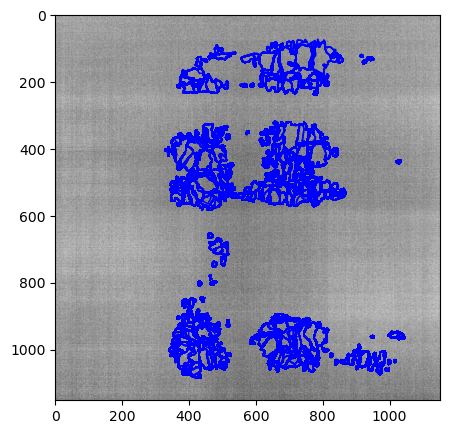

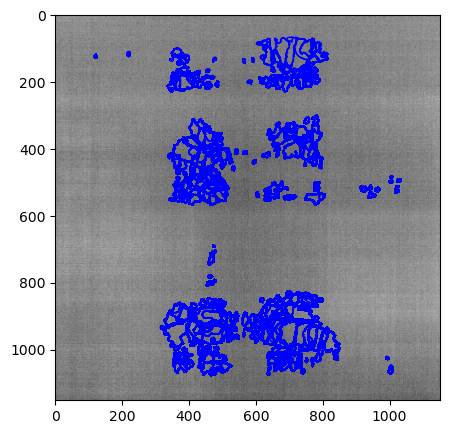

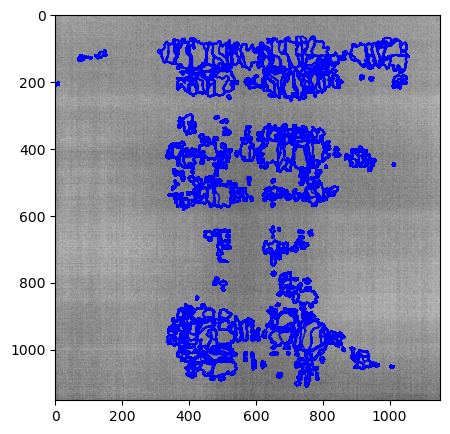

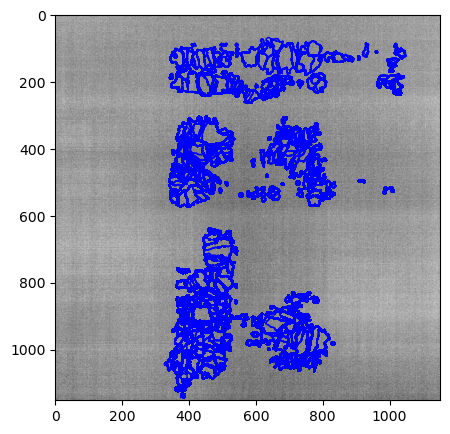

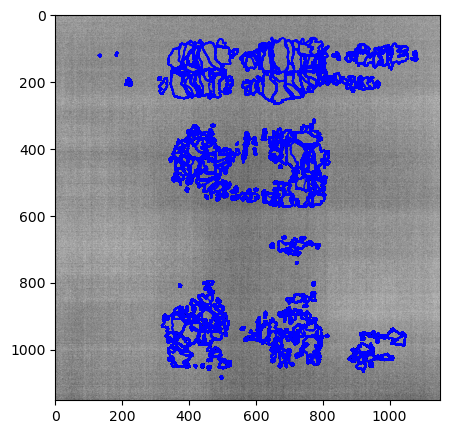

...

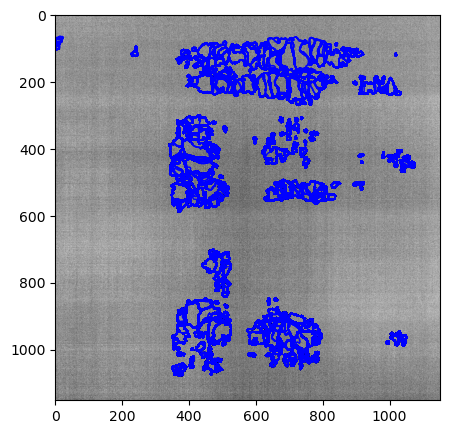

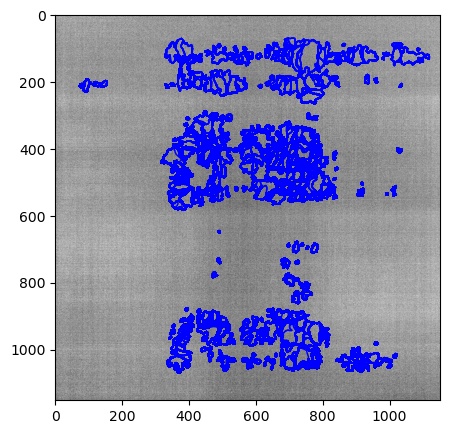

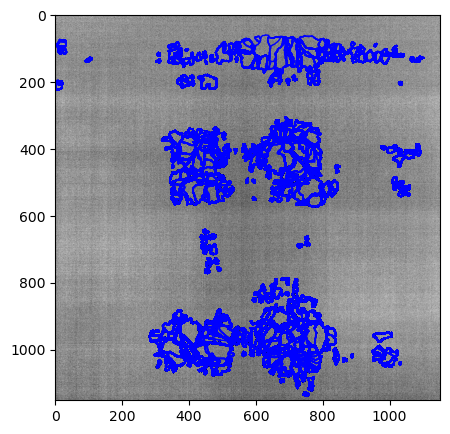

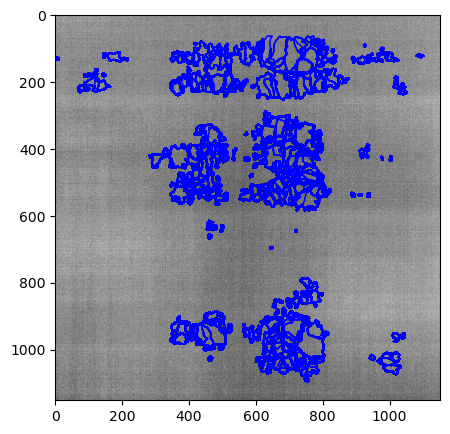

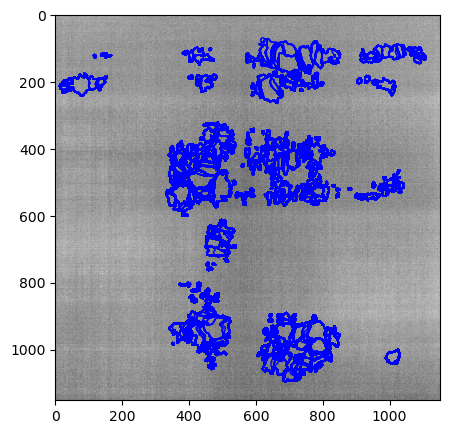

In [96]:
for ixy in ind_xy:
    moviename=f'{modelName}_xy{ixy}'
    h5filename=f'{moviename}.h5'
    metadata_dict = {
      "axes": 'xyc',
      "nt": nt,
      "nx": nx,
      "ny": ny,
      "channels": np.array(channels),
      "mask_channels": np.array(mask_channels),
      "micron_per_pixel": micron_per_pixel,
      "timestep": timestep,
      "figid": moviename,
      "imagelist": imagefile,
      "nuc_channel": nuc_channel,
      "rep_channel": rep_channel,
      "bf_channel": bf_channel,
      "cellpose_modelpath_mb": cellpose_modelpath_mb,
      "cellpose_channels_mb": cellpose_channels_mb,
      "cellpose_modelpath_nuc": cellpose_modelpath_nuc,
      "cellpose_channels_nuc": cellpose_channels_nuc,
      "minsize": minsize,
      "maxsize": maxsize,
      "cellpose_diam": cellpose_diam_mb,
      "cellpose_diam_nuc": cellpose_diam_nuc,
      "mask_channels": mask_channels,
      "mskchannel": mskchannel,
      "nmaskchannels": nmaskchannels,
      "fmask_channels": np.array(fmask_channels)
    }
    imprep.create_h5(h5filename,metadata_dict)
    for iS in range(0,nt):
        print(f'segmenting xy {ixy} frame {iS}')
        img=imgs[ixy,iS,...].compute()
        cellpose_img=np.zeros((3,nx,ny)).astype(np.uint16)
        cellpose_img[0,:,:]=img[:,:,bf_channel]
        cellpose_img[1,:,:]=img[:,:,rep_channel]
        cellpose_img[2,:,:]=img[:,:,nuc_channel]
        output_cyto = model_mb.eval(cellpose_img, diameter=cellpose_diam_mb, channels=cellpose_channels_mb,min_size=minsize,cellprob_threshold=cellprob_threshold_mb,flow_threshold=flow_threshold_mb)
        masks_cyto=output_cyto[0]
        output_nuc = model_nuc.eval(cellpose_img, diameter=cellpose_diam_nuc, channels=cellpose_channels_nuc,min_size=minsize,cellprob_threshold=cellprob_threshold_nuc,flow_threshold=flow_threshold_nuc)
        masks_nuc=output_nuc[0]
        img_mb_smth=imprep.znorm(skimage.filters.gaussian(np.sum(img,axis=2),sigma=rsmooth))
        fmsk=img_mb_smth>zcut
        nucmsk=masks_nuc>0
        labels_cyto=masks_cyto.astype(int)
        label=np.zeros((nx,ny,len(mask_channels))).astype('uint16')
        label[:,:,0]=labels_cyto
        fmasks=np.zeros((nx,ny,len(fmask_channels))).astype('bool')
        fmasks[:,:,0]=fmsk
        fmasks[:,:,1]=nucmsk.astype('bool')
        #imprep.save_frame_h5(h5filename,iS,img=imgs_roi[iS,...],msks=label,fmsk=None,overwrite=True,timestamp=None)
        imprep.save_frame_h5(h5filename,iS,img=img,msks=label,fmsk=fmasks,overwrite=True,timestamp=None)
        if visual:
            clear_output(wait=True);
            try:
                fig=plt.figure(figsize=(5,5))
                fig.clear()
                show_segmentation(fig,img[:,:,rep_channel],labels_cyto,labels2=masks_nuc,fmsk=fmsk)
                #plt.title(f'{moviename} frame {iS}');
                if iS%viz_save_interval==0:
                    plt.savefig(f'{vizpath}/slices_{moviename}_f{iS:04d}.png')
                if live_render:
                    plt.pause(.1)
                del fig
            except Exception as e:
                print(e)

In [149]:
np.unique(masks_nuc)

array([0], dtype=uint16)

#### Step 4: Featurize and track cells
As of 7/23/24 the combined cellpose_celltraj_env isn't working for featurization, you may need to restart with the celltraj_env kernel, rerun step 1, and then come back to run the reaturize and track and the rest of the analysis.

In [6]:
modelList=[]
for ixy in ind_xy:
    moviename=f'{modelName}_xy{ixy}'
    h5filename=f'{moviename}.h5'
    modelList.append(h5filename)

print(modelList)

['20240620_T4density2D_MCL1_N2_xy0.h5', '20240620_T4density2D_MCL1_N2_xy1.h5', '20240620_T4density2D_MCL1_N2_xy2.h5', '20240620_T4density2D_MCL1_N2_xy3.h5', '20240620_T4density2D_MCL1_N2_xy4.h5', '20240620_T4density2D_MCL1_N2_xy5.h5', '20240620_T4density2D_MCL1_N2_xy6.h5', '20240620_T4density2D_MCL1_N2_xy7.h5', '20240620_T4density2D_MCL1_N2_xy8.h5', '20240620_T4density2D_MCL1_N2_xy9.h5', '20240620_T4density2D_MCL1_N2_xy10.h5', '20240620_T4density2D_MCL1_N2_xy11.h5', '20240620_T4density2D_MCL1_N2_xy12.h5', '20240620_T4density2D_MCL1_N2_xy13.h5', '20240620_T4density2D_MCL1_N2_xy14.h5', '20240620_T4density2D_MCL1_N2_xy15.h5', '20240620_T4density2D_MCL1_N2_xy16.h5', '20240620_T4density2D_MCL1_N2_xy17.h5', '20240620_T4density2D_MCL1_N2_xy18.h5', '20240620_T4density2D_MCL1_N2_xy19.h5', '20240620_T4density2D_MCL1_N2_xy20.h5', '20240620_T4density2D_MCL1_N2_xy21.h5', '20240620_T4density2D_MCL1_N2_xy22.h5', '20240620_T4density2D_MCL1_N2_xy23.h5', '20240620_T4density2D_MCL1_N2_xy24.h5', '20240620

In [7]:
ray.init() #load parallel server

Python version:,3.8.19
Ray version:,2.10.0
Dashboard:,http://127.0.0.1:8265


In [7]:
@ray.remote
def get_cellfeatures_reporter2D_distributed(h5filename):
    output_message=f'featurizing {h5filename}...'
    sctm=trajectory.Trajectory(h5filename=h5filename)
    sctm.get_image_shape()
    sctm.nmaskchannels=len(sctm.mask_channels)
    print(f'{sctm.nmaskchannels}')
    cyto_msk_channel=np.where(sctm.mask_channels==np.array(['cyto']).astype('S32'))[0][0]
    nuc_img_channel=np.where(sctm.channels==np.array(['DAPI']).astype('S32'))[0][0]
    rep_img_channel=np.where(sctm.channels==np.array(['YFP']).astype('S32'))[0][0]
    erk_img_channel=np.where(sctm.channels==np.array(['YFP']).astype('S32'))[0][0]
    akt_img_channel=np.where(sctm.channels==np.array(['mCherry']).astype('S32'))[0][0]
    foreground_fmskchannel=np.where(sctm.fmask_channels==np.array(['foreground']).astype('S32'))[0][0]
    nuc_fmskchannel=np.where(sctm.fmask_channels==np.array(['nuc']).astype('S32'))[0][0]
    mskchannel=cyto_msk_channel; sctm.mskchannel=mskchannel
    sctm.load_from_h5('/cell_data_m0/')
    output_message=f'{h5filename} loaded cell data...'
    #sctm.get_frames()
    #sctm.get_cell_index(verbose=True,save_h5=True,overwrite=True)
    #ntrans=[1,1,1]
    #maxt=[0.,0.,0.]
    #tf_matrix_set=sctm.get_stack_trans(mskchannel=sctm.mskchannel,ntrans=ntrans,maxt=maxt,dist_function=utilities.get_pairwise_distance_sum,save_h5=True,overwrite=True,do_global=False) #,contact_transform=True,r0=100.,d0=100.,n=6,m=12)
    #clear_output(wait=True)
    #x=sctm.get_cell_positions(mskchannel=sctm.mskchannel,save_h5=True,overwrite=True)
    #clear_output(wait=True)
    #tf_matrix_set_pad,pad_dims=imprep.get_registration_expansions(sctm.tf_matrix_set,sctm.nx,sctm.ny)
    #clear_output(wait=True)
    ##linSet=sctm.get_lineage_btrack(mskchannel=0,distcut=3*sctm.cellpose_diam,framewindow=6,visual=True,max_search_radius=5*sctm.cellpose_diam,save_h5=True,overwrite=True)
    #linSet=sctm.get_lineage_mindist(distcut=3*sctm.cellpose_diam,visual=True,save_h5=True,overwrite=True)
    #output_message=f'{output_message} tracked...'
    #clear_output(wait=True)
    #Bright field features with cyto masks
    #Xf,feature_list=sctm.get_cell_features((features.featBoundary),indcells=None,imgchannel=erk_img_channel,mskchannel=cyto_msk_channel,return_feature_list=True,save_h5=True,overwrite=True)
    #foreground mask boundary features
    #clear_output(wait=True)
    #bordersize=int(sctm.cellpose_diam/5.)
    #Xf,feature_list=sctm.get_cell_features((features.featBoundaryCB),indcells=None,imgchannel=0,mskchannel=cyto_msk_channel,use_fmask_for_intensity_image=True,fmskchannel=foreground_fmskchannel,bordersize=bordersize,return_feature_list=True,save_h5=True,overwrite=True,concatenate_features=True)
    #clear_output(wait=True)
    #output_message=f'{output_message} shape and contact features...'
    #clear_output(wait=True)
    #motility features
    #Xf_com=sctm.get_motility_features(mskchannel=cyto_msk_channel,save_h5=True,overwrite=True)
    #output_message=f'{output_message} motility features...'
    #clear_output(wait=True)
    #signaling features
    #corrc_erk=sctm.get_cell_channel_crosscorr(mskchannel=cyto_msk_channel,imgchannel1=nuc_img_channel,imgchannel2=erk_img_channel,save_h5=True,overwrite=True)
    #corrc_erk=1.-corrc_erk
    #clear_output(wait=True)
    cratio_erk=sctm.get_cell_compartment_ratio(imgchannel=erk_img_channel,mskchannel1=cyto_msk_channel,mskchannel2=None,fmask_channel=nuc_fmskchannel,make_disjoint=True,remove_background_perframe=True,inverse_ratio=False,save_h5=True,overwrite=True)
    clear_output(wait=True)
    corrc_akt=sctm.get_cell_channel_crosscorr(mskchannel=cyto_msk_channel,imgchannel1=nuc_img_channel,imgchannel2=akt_img_channel,save_h5=True,overwrite=True)
    corrc_akt=1.-corrc_akt
    clear_output(wait=True)
    cratio_akt=sctm.get_cell_compartment_ratio(imgchannel=akt_img_channel,mskchannel1=cyto_msk_channel,mskchannel2=None,fmask_channel=nuc_fmskchannel,make_disjoint=True,remove_background_perframe=True,inverse_ratio=False,save_h5=True,overwrite=True)
    clear_output(wait=True)
    output_message=f'{output_message} signaling features...'
    return output_message

In [95]:
#it is always good to remove the @ray decorator from the featurize and track function and test it on one well first
result=get_cellfeatures_reporter2D_distributed(modelList[0])

featurizing cells from frame 0
getting foreground mask from /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 fmask channel 1
getting foreground mask from /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 fmask channel 0
frame 0 removing background level 385.0
featurizing cells from frame 1
getting foreground mask from /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 fmask channel 1
getting foreground mask from /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 fmask channel 0
frame 1 removing background level 381.0
featurizing cells from frame 2
getting foreground mask from /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 fmask channel 1
getting foreground mask from /ho

In [12]:
results = ray.get([get_cellfeatures_reporter2D_distributed.remote(h5filename) for h5filename in modelList]) #now run in parallel with ray

(pid=3418535) Solver suite is scipy
(get_cellfeatures_reporter2D_distributed pid=3418535) loading 20240620_T4density2D_MCL1_N2_xy3.h5
(get_cellfeatures_reporter2D_distributed pid=3418535) interpreting image as xyc
(get_cellfeatures_reporter2D_distributed pid=3418535) interpreting image as xyc
(get_cellfeatures_reporter2D_distributed pid=3418535) 1
(get_cellfeatures_reporter2D_distributed pid=3418535) loading 20240620_T4density2D_MCL1_N2_xy3.h5:/cell_data_m0/
(get_cellfeatures_reporter2D_distributed pid=3418535) featurizing cells from frame 0
(get_cellfeatures_reporter2D_distributed pid=3418535) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy3.h5 fmask channel 1
(get_cellfeatures_reporter2D_distributed pid=3418535) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy3.h5 fmask channel 0
(get_cellfeatures_reporter2D_distributed pid=3418535) frame 0 removing background level 416.0
(get_cellfeatures_reporter2D_distributed pid=3418535) Warning: there are 27 labels in ms

(get_cellfeatures_reporter2D_distributed pid=3418520) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/trajectory.py:1034: RuntimeWarning: divide by zero encountered in divide
(get_cellfeatures_reporter2D_distributed pid=3418520)   cratio_frame[indcommon0]=np.divide(props1['intensity_mean'],props2['intensity_mean'])


(get_cellfeatures_reporter2D_distributed pid=3418513) error saving img2_m0m1_ratio to 20240620_T4density2D_MCL1_N2_xy83.h5//cell_data_m0/: The data representation in the HDF5 file does not match the original dict. [repeated 2x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418527) saved m0_img0img1_crosscorr to 20240620_T4density2D_MCL1_N2_xy89.h5//cell_data_m0/ [repeated 6x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418527) saving attributes ['m0_img0img1_crosscorr'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy89.h5 [repeated 7x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418514) featurizing cells from frame 37 [repeated 823x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418560) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy93.h5 fmask channel 1 [repeated 845x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418529) frame 120 removing background level 385.0 [repeated 428x across clus

(get_cellfeatures_reporter2D_distributed pid=3418550) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/trajectory.py:1034: RuntimeWarning: divide by zero encountered in divide
(get_cellfeatures_reporter2D_distributed pid=3418550)   cratio_frame[indcommon0]=np.divide(props1['intensity_mean'],props2['intensity_mean'])


(get_cellfeatures_reporter2D_distributed pid=3418523) featurizing cells from frame 142 [repeated 832x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418520) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy118.h5 fmask channel 0 [repeated 520x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418553) frame 120 removing background level 409.0 [repeated 263x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418535) Warning: there are 223 labels in msk1 and 150 labels in msk2 [repeated 257x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418546) saved m0_img0img1_crosscorr to 20240620_T4density2D_MCL1_N2_xy99.h5//cell_data_m0/ [repeated 7x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418515) 
(get_cellfeatures_reporter2D_distributed pid=3418546) saving attributes ['m0_img0img1_crosscorr'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy99.h5 [repeated 9x across cluster]
(get_cellfeatures_reporter2D_distri

(get_cellfeatures_reporter2D_distributed pid=3418535) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/trajectory.py:1034: RuntimeWarning: divide by zero encountered in divide
(get_cellfeatures_reporter2D_distributed pid=3418535)   cratio_frame[indcommon0]=np.divide(props1['intensity_mean'],props2['intensity_mean'])


(get_cellfeatures_reporter2D_distributed pid=3418515) featurizing cells from frame 59 [repeated 678x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418514) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy82.h5 fmask channel 0 [repeated 818x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418552) frame 58 removing background level 384.0 [repeated 407x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418552) 
(get_cellfeatures_reporter2D_distributed pid=3418537) Warning: there are 16 labels in msk1 and 15 labels in msk2 [repeated 392x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418525) saved m0_img0img1_crosscorr to 20240620_T4density2D_MCL1_N2_xy106.h5//cell_data_m0/ [repeated 2x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418553) saving attributes ['m0_img0img1_crosscorr'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy107.h5 [repeated 2x across cluster]
(get_cellfeatures_reporter2D_distribut

(get_cellfeatures_reporter2D_distributed pid=3418522) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/numpy/lib/function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
(get_cellfeatures_reporter2D_distributed pid=3418522)   c = cov(x, y, rowvar, dtype=dtype)
(get_cellfeatures_reporter2D_distributed pid=3418522)   c *= np.true_divide(1, fact)
(get_cellfeatures_reporter2D_distributed pid=3418522) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/numpy/lib/function_base.py:2705: RuntimeWarning: invalid value encountered in multiply
(get_cellfeatures_reporter2D_distributed pid=3418522)   c *= np.true_divide(1, fact)
(get_cellfeatures_reporter2D_distributed pid=3418522) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/numpy/lib/function_base.py:2705: RuntimeWarning: divide by zero encountered in divide


(get_cellfeatures_reporter2D_distributed pid=3418518) saving attributes ['m0_img0img1_crosscorr'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy110.h5 [repeated 2x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418522) featurizing cells from frame 84 [repeated 148x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418512) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy115.h5 fmask channel 0 [repeated 148x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418518) frame 22 removing background level 393.0 [repeated 74x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418512) Warning: there are 629 labels in msk1 and 450 labels in msk2 [repeated 73x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418527) saving attributes ['m0_img0img1_crosscorr'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy111.h5
(get_cellfeatures_reporter2D_distributed pid=3418527) saved m0_img0img1_crosscorr to 20240620_T4densit

(get_cellfeatures_reporter2D_distributed pid=3418511) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/trajectory.py:1034: RuntimeWarning: divide by zero encountered in divide
(get_cellfeatures_reporter2D_distributed pid=3418511)   cratio_frame[indcommon0]=np.divide(props1['intensity_mean'],props2['intensity_mean'])


(get_cellfeatures_reporter2D_distributed pid=3418522) featurizing cells from frame 52 [repeated 74x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418511) getting foreground mask from 20240620_T4density2D_MCL1_N2_xy112.h5 fmask channel 0 [repeated 144x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418518) frame 136 removing background level 396.0 [repeated 71x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418518) Warning: there are 528 labels in msk1 and 336 labels in msk2 [repeated 69x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3418518) saving attributes ['img1_m0m1_ratio'] to /cell_data_m0/ in 20240620_T4density2D_MCL1_N2_xy110.h5
(get_cellfeatures_reporter2D_distributed pid=3418518) error saving img1_m0m1_ratio to 20240620_T4density2D_MCL1_N2_xy110.h5//cell_data_m0/: The data representation in the HDF5 file does not match the original dict.
m(get_cellfeatures_reporter2D_distributed pid=3418518) 
(get_cellfeatures_repor

In [10]:
ray.shutdown()

(get_cellfeatures_reporter2D_distributed pid=3415440) interpreting image as xyc [repeated 148x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3415440) 1 [repeated 78x across cluster]
(get_cellfeatures_reporter2D_distributed pid=3415440) loading 20240620_T4density2D_MCL1_N2_xy126.h5:/cell_data_m0/ [repeated 136x across cluster]


### Step 5: specify conditions, loop through model files and load cell data

In [26]:
date = '29aug24'
os.system(f'mkdir -p {date}')
modelNames = [modelName] #results will be saved/named using this string
datapaths=['/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2']

In [9]:
modelLists = [None]*len(modelNames)
inds_imagingSet=[]
import itertools
for idataset in range(len(modelNames)):
    modelLists[idataset]=imprep.list_images(f'{datapaths[idataset]}/{modelNames[idataset]}_xy*.h5')
    inds_dataset=[idataset]*len(modelLists[idataset])
    inds_imagingSet.append(inds_dataset)

inds_imagingSet=list(itertools.chain(*inds_imagingSet))
print(f'movies: {modelLists}')

movies: [['/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy1.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy10.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy100.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy101.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy102.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy103.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy104.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/v

In [17]:
print(f'movies: {modelLists}')

movies: [['/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy1.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy10.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy100.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy101.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy102.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy103.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy104.h5', '/home/groups/CEDAR/copperma/dyn-cell-sys/v

In [ ]:
#manual specification if no excel file
#tmSet=['ctrl-d0','ctrl-d4','ctrl_d14','AKTi-d0','AKTi-d4','AKTi_d14','MEKi-d0','MEKi-d4','MEKi_d14'] #,'ctrl2','IGF1','FGF2','AKTi+MEKi','MEKi','AKTi']
#colorSet =np.array(['black','dimgray','lightgrey','purple','mediumorchid','violet','blue','cornflowerblue','lightsteelblue'])
#inds_tmSet=[0]*12+[0]*1+[3]*6+[6]*3+[0]*8+[3]*4+[6]*1+[4]*5+[7]*4+[1]*5+[4]*4+[7]*6+[2]*3+[2]*5+[5]*2+[8]*3+[2]*5+[5]*4+[8]*1
#print(f'specified {np.sum(nxySet)} wells and {len(inds_tmSet)} treatments provided')
#print(np.array(tmSet)[inds_tmSet])

In [10]:
conditions_files=['6.20.2024-T4ERKmVenusDensityDependenceMCL1InhibitorPlateMap.xlsx']
import pandas as pd
tmSet=[]
inds_tmSet=np.zeros(nxy).astype(int)
nxySet=[]
for ifile in range(len(conditions_files)):
    conditions_file=conditions_files[ifile]
    dfs = pd.read_excel(conditions_file,header=None)
    nxySet.append(dfs[0].size)
    tmSet_file=np.unique(dfs[1]).tolist()
    tmSet.append(tmSet_file)
    nf=len(tmSet_file)
    for i_tm in range(nf):
        indstm=np.where(dfs[1]==tmSet_file[i_tm])[0]
        inds_tmSet[indstm]=i_tm

inds_tmSet=inds_tmSet.tolist()
tmSet=list(itertools.chain(*tmSet))
print(tmSet)
#inds_tmSet=list(itertools.chain(*inds_tmSet))
print(inds_tmSet)
print(f'specified {np.sum(nxySet)} wells and {len(inds_tmSet)} treatments provided')
cmap=plt.get_cmap('Dark2')
colorSet = cmap(np.linspace(0, 1, len(tmSet)))
#colorSet =np.array(['black','dimgray','lightgrey','purple','mediumorchid','violet','blue','cornflowerblue','lightsteelblue'])

['AREG High', 'AREG Low', 'Control High', 'Control Low', 'EGFRi High', 'EGFRi Low', 'Etoposide 0.5 High', 'Etoposide 0.5 Low', 'Etoposide 5 High', 'Etoposide 5 Low', 'MCL1i High', 'MCL1i Low', 'MCL1i+AREG High', 'MCL1i+AREG Low', 'MCL1i+EGFRi High', 'MCL1i+EGFRi Low']
[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 12, 12, 12, 12, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 6, 6, 6, 6, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9]
specified 128 wells and 128 treatments provided


In [12]:
nf=len(tmSet)
inds_imagingSet_models=[]
inds_tmSet_models=[]
modelList=[]
i_tm=0
for idataset in range(len(modelNames)):
    nxy=nxySet[idataset]
    ind_xy=np.arange(nxy).astype(int)
    for ii in range(nxy):
        ixy=ind_xy[ii]
        modelName=modelNames[idataset]
        datapath=datapaths[idataset]
        mlist = imprep.list_images(f'{datapath}/{modelName}_xy{ixy}.h5')
        for mstring in mlist:
            modelList.append(mstring)
            inds_imagingSet_models.append(inds_imagingSet[ii])
            inds_tmSet_models.append(inds_tmSet[i_tm])
            print(f'found model {mstring} cond: {tmSet[inds_tmSet[i_tm]]}')
        i_tm=i_tm+1
        print(i_tm)

inds_imagingSet_models=np.array(inds_imagingSet_models)
inds_tmSet_models=np.array(inds_tmSet_models)
nmodels=len(modelList)
print(f'{nmodels} models found')

found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 cond: Control Low
1
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy1.h5 cond: Control Low
2
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy2.h5 cond: Control Low
3
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy3.h5 cond: Control Low
4
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy4.h5 cond: Control Low
5
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy5.h5 cond: Control Low
6
found model /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy6.h

In [13]:
modelSet=[None]*nmodels
indgood_models=np.array([]).astype(int)
for i in range(nmodels): #now go back through and try to load data
    try:
        modelSet[i]=trajectory.Trajectory(h5filename=modelList[i])
        sctm=modelSet[i]
        modelSet[i].get_image_shape()#some missing info, add in to metadata in future
        nuc_fmsk_channel=np.where(sctm.fmask_channels==np.array(['nuc']).astype('S32'))[0][0]
        fore_fmsk_channel=np.where(sctm.fmask_channels==np.array(['foreground']).astype('S32'))[0][0]
        cyto_msk_channel=np.where(sctm.mask_channels==np.array(['cyto']).astype('S32'))[0][0]
        nuc_img_channel=np.where(sctm.channels==np.array(['DAPI']).astype('S32'))[0][0]
        rep_img_channel=np.where(sctm.channels==np.array(['YFP']).astype('S32'))[0][0]
        #bf_img_channel=np.where(sctm.channels==np.array(['BF']).astype('S32'))[0][0]
        erk_img_channel=np.where(sctm.channels==np.array(['YFP']).astype('S32'))[0][0]
        akt_img_channel=np.where(sctm.channels==np.array(['mCherry']).astype('S32'))[0][0]
        mskchannel=cyto_msk_channel;sctm.mskchannel=mskchannel
        status=modelSet[i].load_from_h5(f'/cell_data_m{mskchannel}/')
        if status:
            print(f'loaded {sctm.h5filename} with {sctm.mask_channels} mask channels, {sctm.channels} image channels, cell index on {mskchannel}') 
        else:
            print(f'cell info on {mskchannel} not found') 
        if status and np.sum(np.logical_not(np.isfinite(modelSet[i].Xf)))==0:
            print('has morphology features')
            ind_cbc_start=np.where(modelSet[i].Xf_feature_list==b'featBoundaryCB-0_msk0img0_fmsk')[0][0]
            print(f'cb: {np.mean(modelSet[i].Xf[:,ind_cbc_start])}')
            if hasattr(modelSet[i],f'm{mskchannel}_img{nuc_img_channel}img{rep_img_channel}_crosscorr'):
                print('has ERK features')
                if hasattr(modelSet[i],f'm{mskchannel}_img{nuc_img_channel}img{akt_img_channel}_crosscorr'):
                    print('has AKT features')
                    indgood_models=np.append(indgood_models,i)
                    if hasattr(modelSet[i],f'm{mskchannel}_comdx_feat'):
                        print('has motility features')
    except Exception as e:
        print(e)
        pass

loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5
interpreting image as xyc
interpreting image as xyc
loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5:/cell_data_m0/
loaded /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5 with [b'cyto'] mask channels, [b'DAPI' b'mCherry' b'YFP'] image channels, cell index on 0
has morphology features
cb: 0.3243928849111949
has ERK features
has AKT features
has motility features
loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy1.h5
interpreting image as xyc
interpreting image as xyc
loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy1.h5:/cell_data_m0/
loaded /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620

In [14]:
#do a quick filtering on models on segmentation stability
import csaps
nframes=modelSet[0].nt
cellnumber_stdSet=np.ones(nmodels)*np.inf
cellnumber_frames=np.arange(int(nframes/2),nframes).astype(int)
cellnumber_std_cut=100.
meancellSet=np.zeros(nmodels)
cellnumber_set=np.ones((nmodels,nframes))*np.nan
for i in indgood_models:
    ncells=np.zeros(nframes)
    ncells_smooth=np.zeros_like(ncells)
    for iS in range(nframes):
        ncells[iS]=np.sum(modelSet[i].cells_frameSet==iS)
    cellnumber_set[i,:]=ncells
    print(f'model {i} mean cellnumber {np.nanmean(ncells)}')
    meancellSet[i]=np.nanmean(ncells)
    splfov=csaps.CubicSmoothingSpline(np.arange(nframes), ncells/ncells[0], smooth=5.e-2)
    ncells_smooth=splfov(np.arange(nframes))*ncells[0]
    cellnumber_std=np.std(ncells[cellnumber_frames]-ncells_smooth[cellnumber_frames])/np.mean(ncells[cellnumber_frames])
    cellnumber_stdSet[i]=cellnumber_std

indhigh_std=np.where(cellnumber_stdSet>cellnumber_std_cut)[0]
ind_enoughcells=np.where(meancellSet>0.2)[0]
indgood_models=np.intersect1d(indgood_models,ind_enoughcells)

model 0 mean cellnumber 18.53103448275862
model 1 mean cellnumber 12.972413793103449
model 4 mean cellnumber 17.682758620689654
model 7 mean cellnumber 27.675862068965518
model 8 mean cellnumber 18.28965517241379
model 10 mean cellnumber 23.8
model 11 mean cellnumber 19.744827586206895
model 12 mean cellnumber 123.53793103448275
model 14 mean cellnumber 680.9586206896552
model 15 mean cellnumber 726.5793103448276
model 16 mean cellnumber 592.5172413793103
model 19 mean cellnumber 541.2413793103449
model 20 mean cellnumber 79.38620689655173
model 21 mean cellnumber 80.30344827586207
model 22 mean cellnumber 15.068965517241379
model 24 mean cellnumber 87.13103448275862
model 25 mean cellnumber 70.2551724137931
model 26 mean cellnumber 98.69655172413793
model 29 mean cellnumber 89.37241379310345
model 30 mean cellnumber 93.8
model 32 mean cellnumber 83.08275862068966
model 33 mean cellnumber 91.23448275862069
model 34 mean cellnumber 111.93103448275862
model 35 mean cellnumber 63.84827586

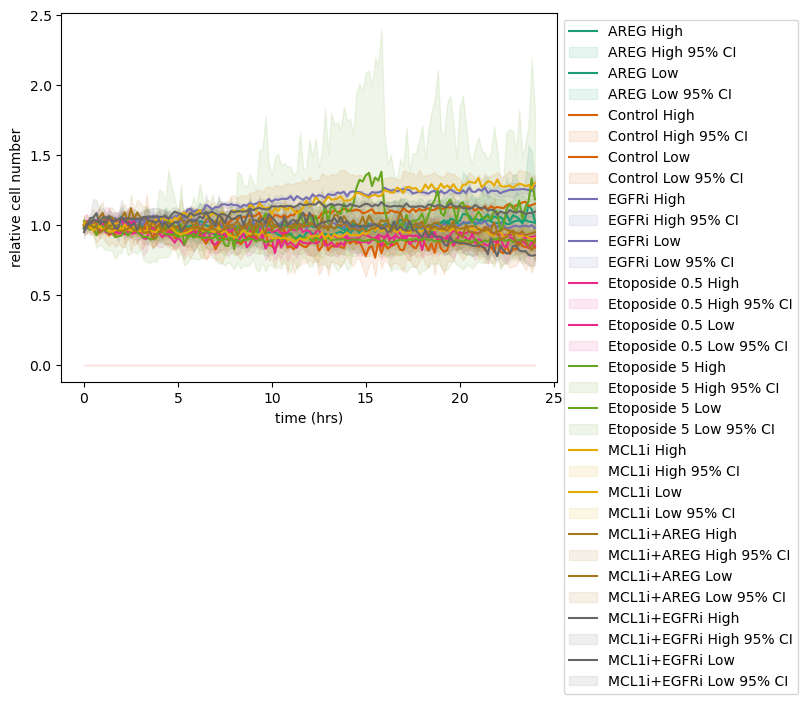

In [15]:
sys.path.append('/home/groups/ZuckermanLab/copperma/msmWE/BayesianBootstrap')
import bootstrap
scipy.average=np.mean
scipy.percentile=np.percentile
cellnumber_set_norm=np.zeros_like(cellnumber_set)
for imodel in range(nmodels):
    cellnumber_set_norm[imodel,:]=np.divide(cellnumber_set[imodel,:],np.mean(cellnumber_set[imodel,0:3]))

cellnumber_set_norm[cellnumber_set_norm==np.inf]=np.nan
cellnumber_tmSet=np.zeros((nf,nframes))
cellnumber_bounds=np.zeros((nf,nframes,2))
plt.figure()
ax=plt.gca()
for i_tm in range(nf):
    indmodels=np.where(inds_tmSet_models==i_tm)[0]
    indmodels=np.intersect1d(indmodels,indgood_models)
    cellnumber_tmSet[i_tm,:]=np.nanmean(cellnumber_set_norm[indmodels,:],axis=0)
    for iframe in range(nframes):
        cns=cellnumber_set_norm[indmodels,iframe]
        cns=cns[np.isfinite(cns)]
        cellnumber_bounds[i_tm,iframe,:]=bootstrap.get_CI(cns,1000)
    ax.plot(np.arange(nframes)*sctm.timestep,cellnumber_tmSet[i_tm,:],'-',color=colorSet[i_tm],label=tmSet[i_tm])
    ax.fill_between(np.arange(nframes)*sctm.timestep,cellnumber_bounds[i_tm,:,0],cellnumber_bounds[i_tm,:,1],color=colorSet[i_tm],alpha=.1,label=f'{tmSet[i_tm]} 95% CI')

plt.ylabel('relative cell number')
plt.xlabel('time (hrs)')
plt.legend(bbox_to_anchor=(1.5, 1.0))
plt.savefig(f'{date}/cellnumber.png')

In [ ]:
#move bad models to their own folder-- can remove later if sure they aren't worth keeping --BE SURE YOU WANT TO DO THIS!!
badfolder='./bad_models'
os.system(f'mkdir {badfolder}')
for h5filename in np.array(modelList)[indbad_models]:
    cmd_str=f'mv {h5filename} {badfolder}/'
    os.system(cmd_str)

#### Select features

In [16]:
print(modelSet[indgood_models[0]].Xf_feature_list)
ilast=np.where(modelSet[indgood_models[0]].Xf_feature_list==b'featBoundaryCB-14_msk0img0_fmsk')[0][0]
print(modelSet[indgood_models[0]].Xf_feature_list[0:ilast])

[b'featBoundary-0_msk0img2' b'featBoundary-1_msk0img2'
 b'featBoundary-2_msk0img2' b'featBoundary-3_msk0img2'
 b'featBoundary-4_msk0img2' b'featBoundary-5_msk0img2'
 b'featBoundary-6_msk0img2' b'featBoundary-7_msk0img2'
 b'featBoundary-8_msk0img2' b'featBoundary-9_msk0img2'
 b'featBoundary-10_msk0img2' b'featBoundary-11_msk0img2'
 b'featBoundary-12_msk0img2' b'featBoundary-13_msk0img2'
 b'featBoundary-14_msk0img2' b'featBoundaryCB-0_msk0img0_fmsk'
 b'featBoundaryCB-1_msk0img0_fmsk' b'featBoundaryCB-2_msk0img0_fmsk'
 b'featBoundaryCB-3_msk0img0_fmsk' b'featBoundaryCB-4_msk0img0_fmsk'
 b'featBoundaryCB-5_msk0img0_fmsk' b'featBoundaryCB-6_msk0img0_fmsk'
 b'featBoundaryCB-7_msk0img0_fmsk' b'featBoundaryCB-8_msk0img0_fmsk'
 b'featBoundaryCB-9_msk0img0_fmsk' b'featBoundaryCB-10_msk0img0_fmsk'
 b'featBoundaryCB-11_msk0img0_fmsk' b'featBoundaryCB-12_msk0img0_fmsk'
 b'featBoundaryCB-13_msk0img0_fmsk' b'featBoundaryCB-14_msk0img0_fmsk']
[b'featBoundary-0_msk0img2' b'featBoundary-1_msk0img2'
 b'f

In [17]:
#image features stored in sctm.Xf, often Zernike polynomials, texture, shape, environment, etc
indkeep_features=np.arange(ilast) #modelSet[indgood_models[0]].Xf.shape[1]).astype(int)
Xf_feature_list=modelSet[indgood_models[0]].Xf_feature_list[indkeep_features]
nfeat=indkeep_features.size
Xf=np.zeros((0,nfeat))
indtreatment=np.array([]).astype(int)
indcellSet=np.array([]).astype(int)
indcells_models=np.array([]).astype(int)
for i in indgood_models:
    Xf=np.append(Xf,modelSet[i].Xf[:,indkeep_features],axis=0)
    indtreatment=np.append(indtreatment,inds_tmSet_models[i]*np.ones(modelSet[i].Xf.shape[0]).astype(int))
    indcellSet=np.append(indcellSet,modelSet[i].cells_indSet)
    indcells_models=np.append(indcells_models,i*np.ones(modelSet[i].Xf.shape[0]).astype(int))

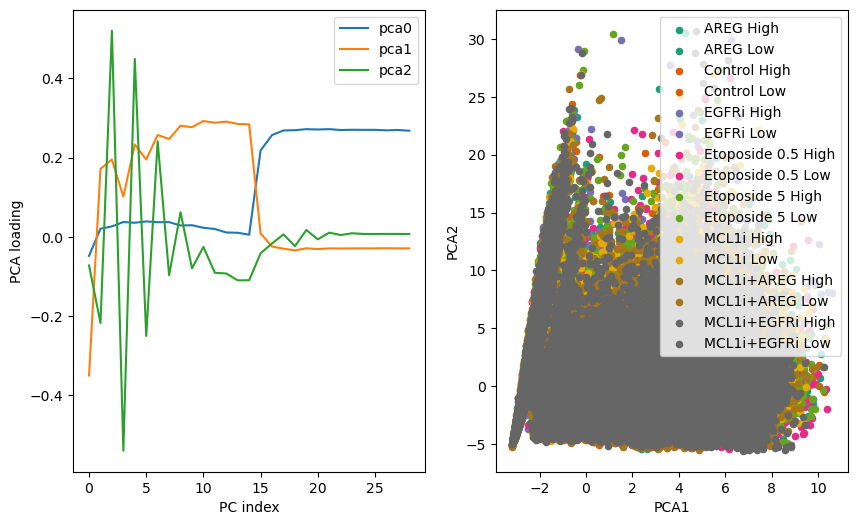

In [18]:
#PCA of image features
#z-norm features
for ifeat in range(Xf.shape[1]): #z-norm all of motility features
    Xf[:,ifeat]=imprep.znorm(Xf[:,ifeat])

Xpca,pca=features.get_pca_fromdata(Xf,var_cutoff=.6); pca.ndim=Xpca.shape[1]

plt.figure(figsize=(10,6))
plt.subplot(1,2,1)
for ipca in range(pca.n_components_):
    plt.plot(pca.components_[ipca,:],label=f'pca{ipca}')

plt.ylabel('PCA loading')
plt.xlabel('PC index')
plt.legend(loc='upper right')

plt.subplot(1,2,2)
for i_tm in range(len(tmSet)):
    inds=np.where(indtreatment==i_tm)[0]
    plt.scatter(Xpca[inds,0],Xpca[inds,1],s=20,label=tmSet[i_tm],color=colorSet[i_tm])

plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend(loc='upper right')
plt.savefig(f'{date}/pca_plot.png')

In [19]:
#motility features
nfeat_com=3
com_feature_list=np.array(['speed','beta','alpha']).astype('S32')
Xf_com=np.zeros((0,nfeat_com))
for i in indgood_models:
    Xf_com=np.append(modelSet[i].m0_comdx_feat,Xf_com,axis=0)

for icom in range(Xf_com.shape[1]): #z-norm all of motility features
    Xf_com[:,icom]=imprep.znorm(Xf_com[:,icom])

In [20]:
#signaling features
corrc_erk=np.array([]).astype(float)
for i in indgood_models:
    sctm=modelSet[i]
    attr_str=f'm{mskchannel}_img{sctm.nuc_channel}img{sctm.rep_channel}_crosscorr'
    cc=getattr(sctm,attr_str)
    corrc_erk=np.append(corrc_erk,1.-cc)

corrc_erk_std=np.std(corrc_erk);corrc_erk_mean=np.mean(corrc_erk);corrc_erk=imprep.znorm(corrc_erk)

for i in indgood_models:
    sctm=modelSet[i]
    attr_str=f'm{mskchannel}_img{sctm.nuc_channel}img{sctm.rep_channel}_crosscorr'
    cc=getattr(sctm,attr_str)
    corrc_z_model=(np.array([1.-cc]).T-corrc_erk_mean)/corrc_erk_std
    modelSet[i].x_signal=corrc_z_model[:,0].copy()

In [21]:
#signaling features
cratio_erk=np.array([]).astype(float)
for i in indgood_models:
    sctm=modelSet[i]
    attr_str=f'img{erk_img_channel}_m{sctm.mskchannel}m{nuc_fmsk_channel}_ratio'
    cc=getattr(sctm,attr_str)
    cratio_erk=np.append(cratio_erk,cc)

cratio_erk_std=np.std(cratio_erk);cratio_erk_mean=np.mean(cratio_erk);#cratio_erk=imprep.znorm(cratio_erk)

In [22]:
#signaling features
corrc_akt=np.array([]).astype(float)
for i in indgood_models:
    sctm=modelSet[i]
    akt_channel=np.where(sctm.channels==np.array(['mCherry']).astype('S32'))[0][0]
    attr_str=f'm{mskchannel}_img{sctm.nuc_channel}img{akt_channel}_crosscorr'
    cc=getattr(sctm,attr_str)   
    corrc_akt=np.append(corrc_akt,1.-cc)

corrc_akt_std=np.std(corrc_akt);corrc_akt_mean=np.mean(corrc_akt);corrc_akt=imprep.znorm(corrc_akt)
for i in indgood_models:
    sctm=modelSet[i]
    akt_channel=np.where(sctm.channels==np.array(['mCherry']).astype('S32'))[0][0]
    attr_str=f'm{mskchannel}_img{sctm.nuc_channel}img{akt_channel}_crosscorr'
    cc=getattr(sctm,attr_str)   
    corrc_z_model=(np.array([1.-cc]).T-corrc_akt_mean)/corrc_akt_std
    modelSet[i].x_signal_akt=corrc_z_model[:,0].copy()

In [23]:
#signaling features
cratio_akt=np.array([]).astype(float)
for i in indgood_models:
    sctm=modelSet[i]
    attr_str=f'img{akt_img_channel}_m{sctm.mskchannel}m{nuc_fmsk_channel}_ratio'
    cc=getattr(sctm,attr_str)
    cratio_akt=np.append(cratio_akt,cc)

cratio_akt_std=np.std(cratio_akt);cratio_akt_mean=np.mean(cratio_akt);#cratio_erk=imprep.znorm(cratio_erk)

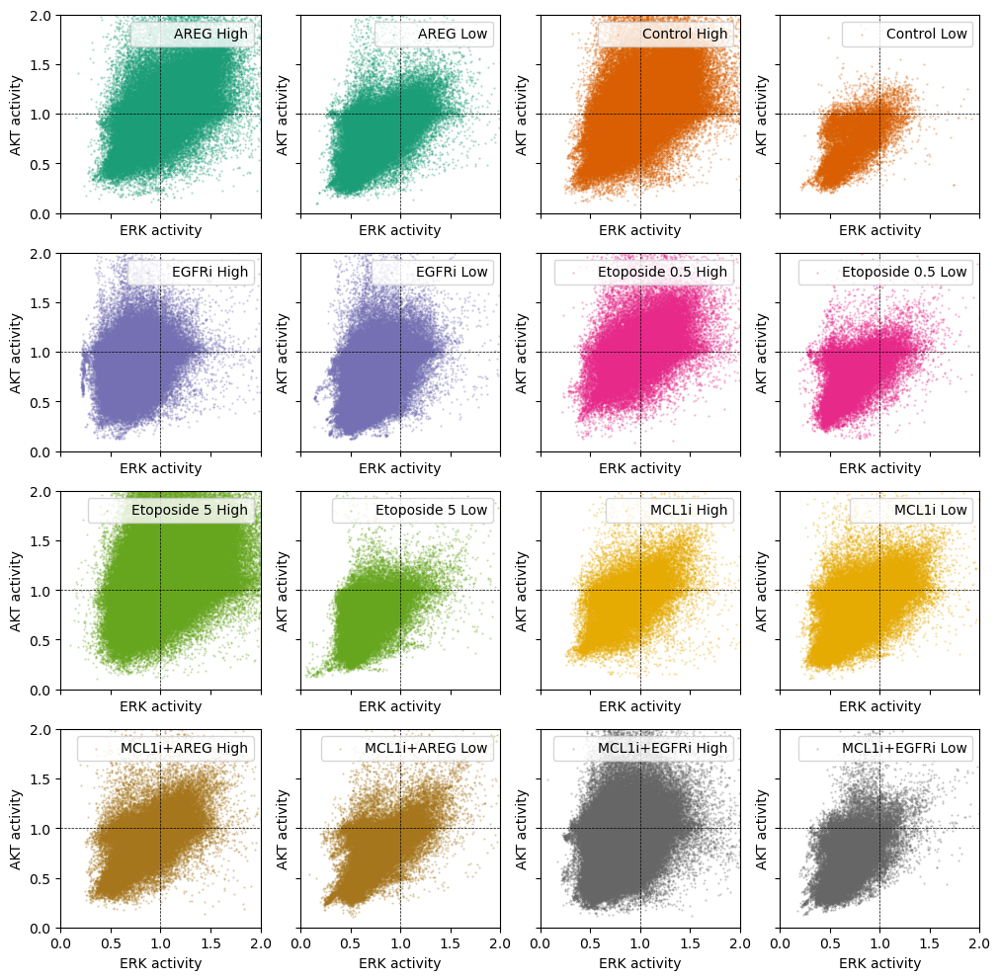

In [24]:
nplots=int(np.ceil(np.sqrt(nf)))
fig,ax=plt.subplots(nplots,nplots,sharex=True,sharey=True,figsize=(12,12))
ax=ax.flatten()
xlow=0;xhigh=2;ylow=0;yhigh=2
for i_tm in range(len(tmSet)):
    inds=np.where(indtreatment==i_tm)[0]
    ax[i_tm].scatter(cratio_erk[inds],cratio_akt[inds],s=1,marker='.',label=tmSet[i_tm],color=colorSet[i_tm],alpha=.4)
    ax[i_tm].plot([xlow,xhigh],[1,1],'k--',linewidth=.5)
    ax[i_tm].plot([1,1],[ylow,yhigh],'k--',linewidth=.5)
    ax[i_tm].set_xlim(xlow,xhigh)
    ax[i_tm].set_ylim(ylow,yhigh)
    ax[i_tm].legend(loc='upper right')
    ax[i_tm].set_xlabel('ERK activity')
    ax[i_tm].set_ylabel('AKT activity')

plt.savefig(f'{date}/signaling_cratio_plot.png')

In [25]:
#put the features for embedding into Xpca feature vector
feature_list=[]
Xpca=np.zeros((Xf.shape[0],0)) #use this if you want to leave out pca morphology features

#for i in range(pca.ndim):
#    feature_list.append(f'pca{i}')
#    Xpca[:,i]=imprep.znorm(Xpca[:,i]) #z-norm?
    
#Xpca=np.concatenate((Xpca,Xf_com),axis=1)
#for i in [0]: #range(len(com_feature_list)):
#    Xpca=np.concatenate((Xpca,Xf_com[:,i][:,np.newaxis]),axis=1)
#    feature_list.append(com_feature_list[i].decode())

Xpca=np.concatenate((Xpca,corrc_erk[:,np.newaxis]),axis=1)
feature_list.append('erk-nuc-cross-corr')

Xpca=np.concatenate((Xpca,corrc_akt[:,np.newaxis]),axis=1)
feature_list.append('akt-nuc-cross-corr')

print(feature_list)

for i in indgood_models:
   indsf=np.where(indcells_models==i)[0]
   modelSet[i].Xpca=Xpca[indsf,:]

['erk-nuc-cross-corr', 'akt-nuc-cross-corr']


#### Trajectory embedding

In [27]:
#Analysis identifiers
data_id=f'T4mammary_{date}'

In [50]:
#Map all trajectories
all_trajSet=[None]*nmodels
for i in indgood_models:
    print(f'tracing trajectories for {modelSet[i].h5filename}')
    modelSet[i].get_unique_trajectories()
    all_trajSet[i]=modelSet[i].trajectories.copy()

tracked cell 610, 33 tracks, 100 left
tracked cell 27, 1 tracks, 0 left
tracked cell 1150, 1 tracks, 600 left
tracked cell 1, 1 tracks, 0 left
tracked cell 2551, 145 tracks, 1300 left
tracked cell 1942, 1 tracks, 600 left
tracked cell 33, 1 tracks, 0 left
tracked cell 3886, 1 tracks, 1500 left
tracked cell 3076, 1 tracks, 900 left
tracked cell 2546, 2 tracks, 800 left
tracked cell 2192, 1 tracks, 700 left
tracked cell 5, 1 tracks, 0 left
tracked cell 1978, 3 tracks, 600 left
tracked cell 923, 2 tracks, 100 left
tracked cell 26, 1 tracks, 0 left
tracked cell 3286, 2 tracks, 1600 left
tracked cell 2259, 5 tracks, 1000 left
tracked cell 565, 1 tracks, 100 left
tracked cell 11, 1 tracks, 0 left
tracked cell 2677, 1 tracks, 1600 left
tracked cell 1219, 1 tracks, 500 left
tracked cell 878, 2 tracks, 300 left
tracked cell 565, 1 tracks, 200 left
tracked cell 283, 4 tracks, 100 left
tracked cell 4, 1 tracks, 0 left
tracked cell 17904, 145 tracks, 16900 left
tracked cell 16085, 1 tracks, 6000 l

KeyboardInterrupt: 

In [28]:
@ray.remote
def get_trajectories(imodel,db):
    print(f'running {imodel}')
    sctm=db[imodel]
    if hasattr(sctm,'trajectories'):
        trajectories=sctm.trajectories.copy()
    else:
        sctm.get_unique_trajectories()
        trajectories=sctm.trajectories.copy()
    return trajectories

In [29]:
#trajectory tracing-- parallel
#Map all trajectories
results = ray.get([get_trajectories.remote(imodel, modelSet) for imodel in list(indgood_models)])

(get_trajectories pid=202366) Solver suite is scipy


(get_trajectories pid=202366) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:5: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
(get_trajectories pid=202366)   def groupby_count(xyz, indices, out):
(get_trajectories pid=202366) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:12: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#depr

(get_trajectories pid=202366) running 0
(get_trajectories pid=202387) tracked cell 2551, 145 tracks, 1300 left
(get_trajectories pid=202360) Solver suite is scipy [repeated 5x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(get_trajectories pid=202385) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:19: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details. [repeated 18x across cluster]
(get_trajectories pid=202385)   def groupby_count(xyz, indices, out): [repeated 6x across cluster]
(get_trajectories pid=202385)   def groupby_sum(xyz, indices, N, out): [repeated 6x across cluster]
(get_trajectories pid=202385)   def groupby_max(xyz, indices, N, out): [repeated 6x across cluster]


(get_trajectories pid=202385) running 11 [repeated 9x across cluster]
(get_trajectories pid=202385) tracked cell 4, 1 tracks, 0 left [repeated 32x across cluster]
(get_trajectories pid=202353) Solver suite is scipy [repeated 4x across cluster]
(get_trajectories pid=202393) running 26 [repeated 8x across cluster]
(get_trajectories pid=202360) tracked cell 4836, 6 tracks, 1800 left [repeated 56x across cluster]
(get_trajectories pid=202385) running 33 [repeated 4x across cluster]
(get_trajectories pid=202360) tracked cell 3735, 1 tracks, 1000 left [repeated 57x across cluster]


(raylet) Spilled 2522 MiB, 4 objects, write throughput 562 MiB/s. Set RAY_verbose_spill_logs=0 to disable this message.
(get_trajectories pid=202353) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:19: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details. [repeated 9x across cluster]
(get_trajectories pid=202353)   def groupby_count(xyz, indices, out): [repeated 3x across cluster]
(get_trajectories pid=202353)   def groupby_sum(xyz, indices, N, out): [repeated 3x across cluster]
(get_trajectories pid=202353)   def groupby_max(xyz, indices, N, out): [repeated 3x across cluster]


(get_trajectories pid=202366) running 39 [repeated 5x across cluster]
(get_trajectories pid=202360) tracked cell 4939, 1 tracks, 1400 left [repeated 47x across cluster]


(raylet) Spilled 5045 MiB, 8 objects, write throughput 771 MiB/s.


(get_trajectories pid=202360) running 42 [repeated 2x across cluster]
(get_trajectories pid=202355) tracked cell 63011, 2 tracks, 23200 left [repeated 55x across cluster]


(raylet) Spilled 18920 MiB, 31 objects, write throughput 1346 MiB/s.


(get_trajectories pid=202361) running 59 [repeated 7x across cluster]
(get_trajectories pid=202385) tracked cell 618, 4 tracks, 100 left [repeated 45x across cluster]


(raylet) Spilled 21443 MiB, 35 objects, write throughput 1290 MiB/s.


(get_trajectories pid=202385) running 68 [repeated 6x across cluster]
(get_trajectories pid=202387) tracked cell 1347, 1 tracks, 200 left [repeated 83x across cluster]
(get_trajectories pid=202386) Solver suite is scipy


(get_trajectories pid=202386) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:5: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
(get_trajectories pid=202386)   def groupby_count(xyz, indices, out):
(get_trajectories pid=202386) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:12: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#depr

(get_trajectories pid=202386) running 55 [repeated 4x across cluster]
(get_trajectories pid=202361) tracked cell 3555, 1 tracks, 2000 left [repeated 68x across cluster]


(raylet) Spilled 32795 MiB, 51 objects, write throughput 1256 MiB/s.


(get_trajectories pid=202380) Solver suite is scipy [repeated 3x across cluster]


(get_trajectories pid=202380) /home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/pyntcloud/utils/numba.py:19: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details. [repeated 9x across cluster]
(get_trajectories pid=202380)   def groupby_count(xyz, indices, out): [repeated 3x across cluster]
(get_trajectories pid=202380)   def groupby_sum(xyz, indices, N, out): [repeated 3x across cluster]
(get_trajectories pid=202380)   def groupby_max(xyz, indices, N, out): [repeated 3x across cluster]


(get_trajectories pid=202352) running 67 [repeated 7x across cluster]
(get_trajectories pid=202385) tracked cell 30681, 5 tracks, 12000 left [repeated 83x across cluster]
(get_trajectories pid=202367) Solver suite is scipy
(get_trajectories pid=202389) running 81 [repeated 3x across cluster]
(get_trajectories pid=202366) tracked cell 23059, 1 tracks, 7300 left [repeated 75x across cluster]
(get_trajectories pid=202352) running 85 [repeated 3x across cluster]
(get_trajectories pid=202385) tracked cell 3453, 1 tracks, 600 left [repeated 63x across cluster]
(get_trajectories pid=202366) tracked cell 980, 3 tracks, 100 left [repeated 59x across cluster]
(get_trajectories pid=202355) tracked cell 8124, 1 tracks, 1700 left [repeated 47x across cluster]
(get_trajectories pid=202379) tracked cell 54051, 1 tracks, 18300 left [repeated 37x across cluster]
(get_trajectories pid=202352) running 86
(get_trajectories pid=202380) tracked cell 8, 1 tracks, 0 left [repeated 58x across cluster]
(get_tra

In [95]:
indgood_models=np.append(indgood_models,127)

In [30]:
all_trajSet=[None]*nmodels
for imodel in indgood_models:
    iresult=np.where(indgood_models==imodel)[0][0]
    print(len(results[iresult]))
    all_trajSet[imodel]=results[iresult]
    modelSet[imodel].trajectories=all_trajSet[imodel].copy()

173
251
187
310
204
374
552
1391
6765
6659
6622
5420
978
822
160
890
881
1068
879
877
1063
1139
1621
770
1408
1417
1504
787
963
3749
4387
3771
839
962
776
906
1401
906
809
647
1012
678
1097
714
2158
714
743
1148
516
1146
1146
148
3870
2529
8147
5742
2660
2906
514
511
1202
887
750
986
555
864
926
651
1715
449
494
298
1119
474
440
691
801
5530
6709
8547
7413
280
855
178
235
1066
558
100
370
330
338


/tmp/ipykernel_201779/4292102825.py:43: RuntimeWarning: Mean of empty slice
  meanSet_erk[i_tm]=np.nanmean(trajs_erk,axis=0)
/tmp/ipykernel_201779/4292102825.py:44: RuntimeWarning: Mean of empty slice
  meanSet_akt[i_tm]=np.nanmean(trajs_akt,axis=0)


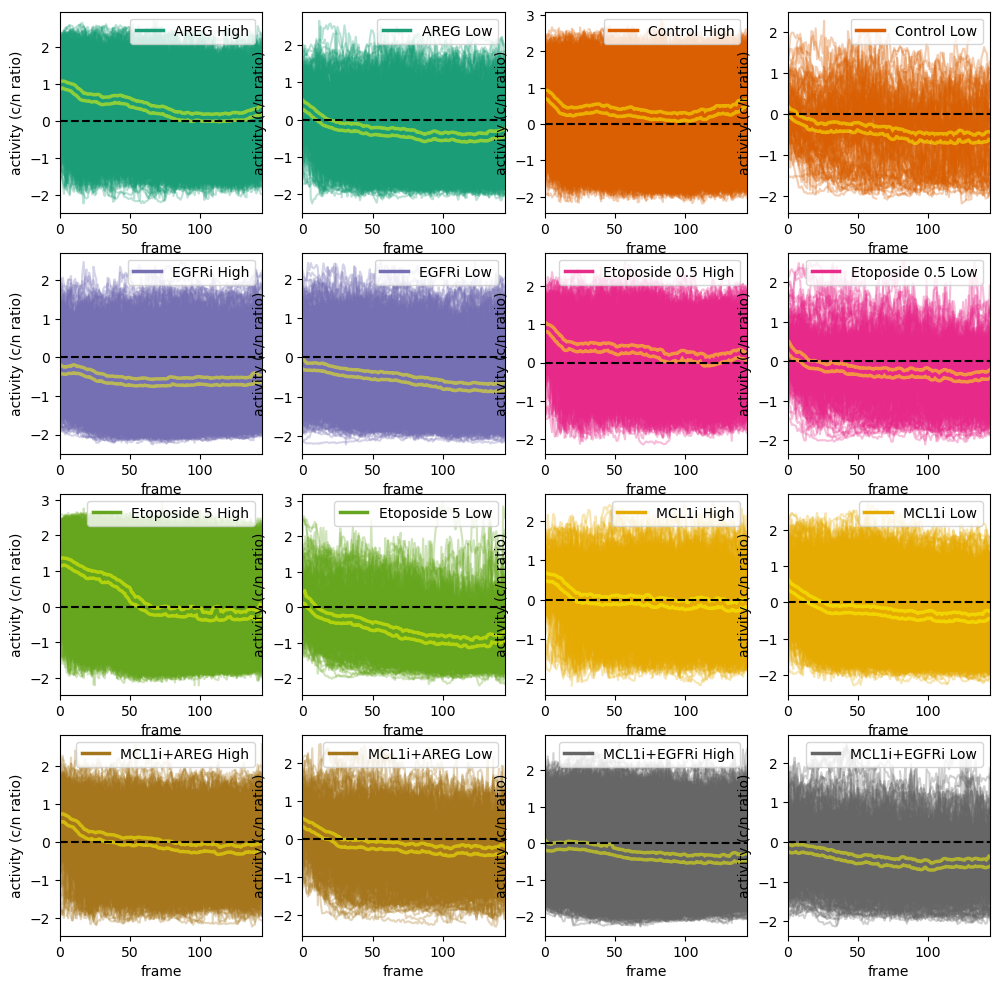

<Figure size 1000x1000 with 0 Axes>

In [34]:
#make a plot of single-cell trajectories, averages, and conditions by frame
nplots=int(np.ceil(np.sqrt(nf)))
fig,ax=plt.subplots(nplots,nplots,figsize=(12,12))
ax=ax.flatten()
min_traj_len=60
fig=plt.figure(figsize=(10,10))
trajSet_erk=[None]*len(tmSet)
trajSet_akt=[None]*len(tmSet)
#trajSet_fra1=[None]*len(tmSet)
meanSet_erk=[None]*len(tmSet)
meanSet_akt=[None]*len(tmSet)
#meanSet_fra1=[None]*len(tmSet)
nt=200
for i_tm in range(len(tmSet)):
    ind_models=np.where(inds_tmSet_models==i_tm)[0]
    ind_models=np.intersect1d(ind_models,indgood_models)
    trajs_erk=np.zeros((0,nt))
    trajs_akt=np.zeros((0,nt))
    #trajs_fra1=np.zeros((0,nt))
    frames=np.zeros((0,nt))
    for imodel in ind_models:
        for itraj in range(len(modelSet[imodel].trajectories)):
            trajlen=modelSet[imodel].trajectories[itraj].size
            if trajlen>min_traj_len:
                inds=modelSet[imodel].trajectories[itraj]
                frames=modelSet[imodel].cells_frameSet[inds]
                #cr_erk=modelSet[imodel].img2_m0m1_ratio[inds]
                #cr_akt=modelSet[imodel].img1_m0m1_ratio[inds]
                cr_erk=modelSet[imodel].x_signal[inds] #1.-modelSet[imodel].m0_img0img3_crosscorr[inds]
                cr_akt=modelSet[imodel].x_signal_akt[inds] #1.-modelSet[imodel].m0_img0img2_crosscorr[inds]
                #cr_fra1=modelSet[imodel].Xf[inds,indfra1]
                tr_erk=np.ones(nt)*np.nan
                tr_akt=np.ones(nt)*np.nan
                #tr_fra1=np.ones(nt)*np.nan
                tr_erk[frames]=cr_erk
                tr_akt[frames]=cr_akt
                #tr_fra1[frames]=cr_fra1
                trajs_erk=np.append(trajs_erk,tr_erk[np.newaxis,:],axis=0)
                trajs_akt=np.append(trajs_akt,tr_akt[np.newaxis,:],axis=0)
                #trajs_fra1=np.append(trajs_fra1,tr_fra1[np.newaxis,:],axis=0)
                ax[i_tm].plot(frames,cr_erk,'-',color=colorSet[i_tm],alpha=.3)
                #ax[i_tm].plot(frames,cr_akt,'-',color=colorSet[i_tm],alpha=.1)
    meanSet_erk[i_tm]=np.nanmean(trajs_erk,axis=0)
    meanSet_akt[i_tm]=np.nanmean(trajs_akt,axis=0)
    #meanSet_fra1[i_tm]=np.nanmean(trajs_fra1,axis=0)
    ax[i_tm].plot(np.arange(nt),meanSet_erk[i_tm],'-',color='yellow',alpha=.5,linewidth=7.5)
    #ax[i_tm].plot(np.arange(nt),meanSet_akt[i_tm],'-',color='yellow',alpha=.5,linewidth=7.5)
    ax[i_tm].plot(np.arange(nt),meanSet_erk[i_tm],'-',color=colorSet[i_tm],alpha=1.,linewidth=2.5,label=tmSet[i_tm])
    #ax[i_tm].plot(np.arange(nt),meanSet_akt[i_tm],'-',color=colorSet[i_tm],alpha=1.,linewidth=2.5,label=tmSet[i_tm])
    ax[i_tm].plot([0,nt],[0,0],'k--')
    ax[i_tm].set_xlim(0,np.max(np.where(np.isfinite(meanSet_erk[i_tm]))[0]))
    #ax[i_tm].set_ylim(0,2)
    trajSet_erk[i_tm]=trajs_erk.copy()
    trajSet_akt[i_tm]=trajs_akt.copy()
    #trajSet_fra1[i_tm]=trajs_fra1.copy()
    ax[i_tm].set_xlabel('frame')
    ax[i_tm].set_ylabel('activity (c/n ratio)')
    ax[i_tm].legend(loc='upper right')
    
plt.savefig(f'{date}/mean_erk_signalingvtime_corrc_{data_id}.png')
#plt.savefig(f'{date}/mean_akt_signalingvtime_{data_id}.png')

In [93]:
ind_models

array([110])

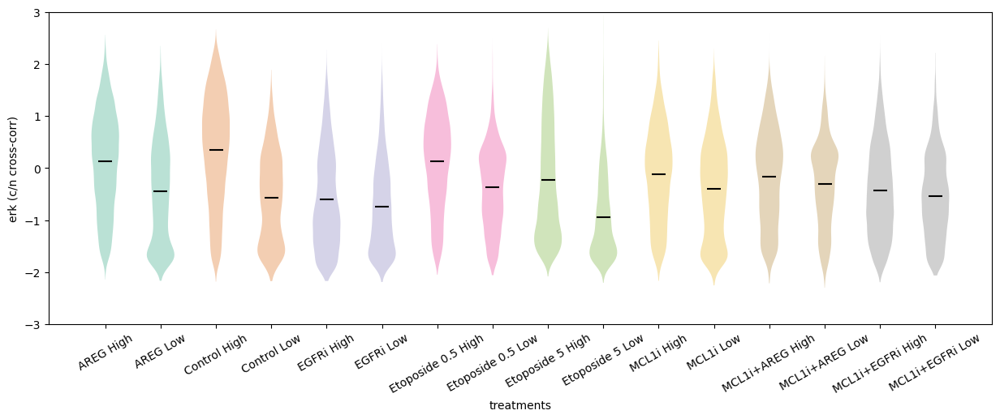

In [36]:
min_frame=100
plt.figure(figsize=(15,5))
ax=plt.gca()
n_tm=len(tmSet)
signalSet=[None]*n_tm
for i_tm in range(n_tm):
    setv=trajSet_erk[i_tm][:,min_frame:]
    setv=setv[np.isfinite(setv)]
    if setv.size>0:
        signalSet[i_tm]=setv
        vplot=ax.violinplot(setv,positions=[i_tm+1],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
        vplot['cmeans'].set_color('black')
        for pc in vplot['bodies']:
            pc.set_facecolor(colorSet[i_tm])

ax.set_xticks(range(1,n_tm+1))
ax.set_xticklabels(tmSet,rotation=30)
ax.set_ylim(-3,3)
plt.ylabel('erk (c/n cross-corr)')
plt.xlabel('treatments')
plt.savefig(f'{date}/signaling_erk_tearplot_corrc_{data_id}.png')

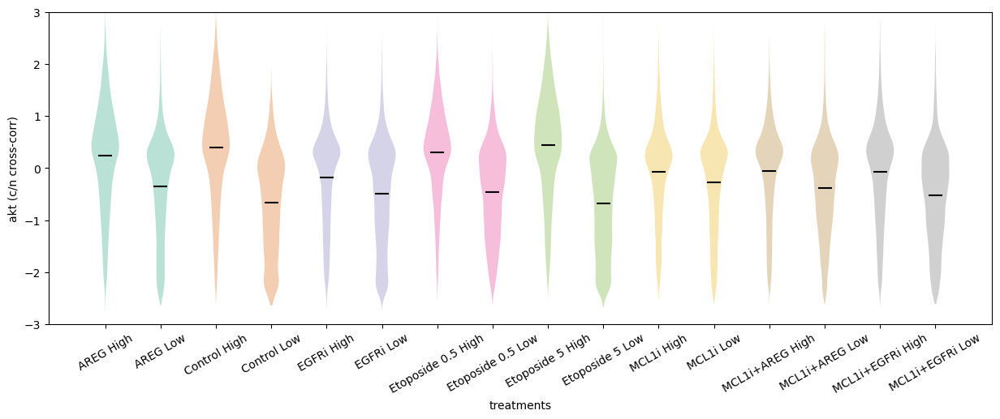

In [38]:
min_frame=0
plt.figure(figsize=(15,5))
ax=plt.gca()
n_tm=len(tmSet)
signalSet=[None]*n_tm
for i_tm in range(n_tm):
    setv=trajSet_akt[i_tm][:,min_frame:]
    setv=setv[np.isfinite(setv)]
    if setv.size>0:
        signalSet[i_tm]=setv
        vplot=ax.violinplot(setv,positions=[i_tm+1],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
        vplot['cmeans'].set_color('black')
        for pc in vplot['bodies']:
            pc.set_facecolor(colorSet[i_tm])

ax.set_xticks(range(1,n_tm+1))
ax.set_xticklabels(tmSet,rotation=30)
ax.set_ylim(-3,3)
plt.ylabel('akt (c/n cross-corr)')
plt.xlabel('treatments')
plt.savefig(f'{date}/signaling_akt_tearplot_crosscorr_{data_id}.png')

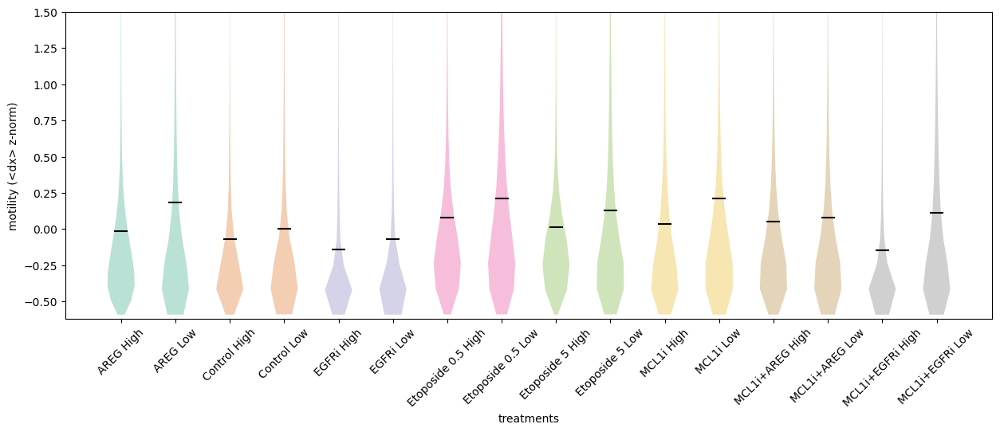

In [104]:
min_frame=0
plt.figure(figsize=(15,5))
ax=plt.gca()
n_tm=len(tmSet)
signalSet=[None]*n_tm
ifeat=0 #np.where(modelSet[0].Xf_feature_list==b'meanIntensity_msk0img1')[0][0]
for i_tm in range(n_tm):
    inds=indtreatment==i_tm
    setv=Xf_com[inds,ifeat]
    setv=setv[np.isfinite(setv)]
    if setv.size>0:
        signalSet[i_tm]=setv
        vplot=ax.violinplot(setv,positions=[i_tm+1],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
        vplot['cmeans'].set_color('black')
        for pc in vplot['bodies']:
            pc.set_facecolor(colorSet[i_tm])

ax.set_xticks(range(1,n_tm+1))
ax.set_xticklabels(tmSet,rotation=45)
plt.ylabel('motility (<dx> z-norm)')
plt.xlabel('treatments')
plt.ylim(-.62,1.5)
plt.savefig(f'{date}/motility_tearplot_{data_id}.png')

### Collective signaling

In [106]:
@ray.remote
def get_smean_csize_distributed(imodel,db):
    print(f'?, {imodel}')
    sctm=db[imodel]
    print(sctm.h5filename)
    rsmooth=sctm.cellpose_diam/4.
    zcut=2.0
    csize=np.array([]).astype(int)
    Smean_csize=np.array([]).astype(float)
    for iframe in range(sctm.nt):
        print(f'extracting cluster data for model {imodel}, frame {iframe}')
        msk=sctm.get_mask_data(iframe);
        msk_cyto=msk[...,cyto_msk_channel];
        #msk_nuc=msk[...,nuc_msk_channel];
        img_rep=sctm.get_image_data(iframe)[...,rep_img_channel];
        img_rep_smth=skimage.filters.gaussian(img_rep,sigma=rsmooth,mode='mirror')
        fmsk=imprep.znorm(img_rep_smth)>zcut
        indframe=np.where(sctm.cells_frameSet==iframe)[0]
        sigS=sctm.img2_m0m1_ratio[indframe]
        fmap=imprep.get_feature_map(sigS,msk_cyto)
        msk_clusters=imprep.get_labeled_mask(fmsk,fill_holes=False)
        for icluster in np.unique(msk_clusters)[1:]:
            #print(f'{iframe}, {icluster}')
            indc=np.unique(msk_cyto[msk_clusters==icluster])
            indc=indc[indc>0]-1 #indices one less than labeled mask, ignore 0
            if indc.size>0:
                Smean_csize=np.append(Smean_csize,np.mean(sigS[indc]))
                csize=np.append(csize,indc.size)
    sctm.Smean_csize=Smean_csize
    sctm.csize=csize
    sctm.save_to_h5('/cell_data_m0/',['Smean_csize','csize'],overwrite=True)
    return Smean_csize,csize

In [107]:
results2 = ray.get([get_smean_csize_distributed.remote(imodel, modelSet) for imodel in list(indgood_models)])

(get_smean_csize_distributed pid=3418521) ?, 0
(get_smean_csize_distributed pid=3418521) /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy0.h5
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 0
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 1
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 2
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 3
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 4
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 5
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 6
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 7
(get_smean_csize_distributed pid=3418521) extracting cluster data for model 0, frame 8
(get_smean_csi

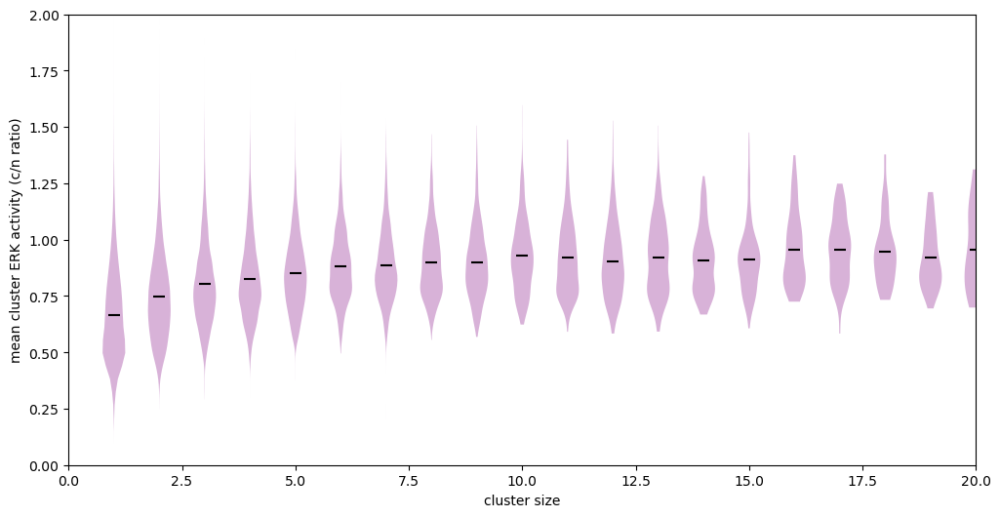

In [113]:
csize=np.array([]).astype(int)
Smean_csize=np.array([]).astype(float)
inds_csize_models=np.array([]).astype(int)
#indmodels=np.where(inds_tmSet_models==0)[0]
#indmodels=np.intersect1d(indmodels,indgood_models)
for imodel in indgood_models: #indmodels:
    iresult=np.where(indgood_models==imodel)[0][0]
    csize=np.append(csize,results2[iresult][1])
    Smean_csize=np.append(Smean_csize,results2[iresult][0])
    inds_csize_models=np.append(inds_csize_models,np.ones_like(csize)*imodel)

plt.figure(figsize=(12,6))
ax=plt.gca()
for i_size in range(np.max(csize)):
    inds=csize==i_size
    setv=Smean_csize[inds]
    setv=setv[np.isfinite(setv)]
    if setv.size>0:
        vplot=ax.violinplot(setv,positions=[i_size],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
        vplot['cmeans'].set_color('black')
        for pc in vplot['bodies']:
            pc.set_facecolor('purple')    
plt.ylabel('mean cluster ERK activity (c/n ratio)')
plt.xlabel('cluster size')
plt.ylim(0,2)
plt.xlim(0,20)
plt.savefig(f'{date}/smeans_csize_{data_id}.png')
plt.pause(.1)

In [111]:
Smean_csize_set=[None]*nf
csize_set=[None]*nf
for i_tm in range(nf):
    csize=np.array([]).astype(int)
    Smean_csize=np.array([]).astype(float)
    inds_csize_models=np.array([]).astype(int)
    indmodels=np.where(inds_tmSet_models==i_tm)[0]
    indmodels=np.intersect1d(indmodels,indgood_models)
    for imodel in indmodels:
        iresult=np.where(indgood_models==imodel)[0][0]
        csize=np.append(csize,results2[iresult][1])
        Smean_csize=np.append(Smean_csize,results2[iresult][0])
        inds_csize_models=np.append(inds_csize_models,np.ones_like(csize)*imodel)
    Smean_csize_set[i_tm]=Smean_csize.copy()
    csize_set[i_tm]=csize.copy()

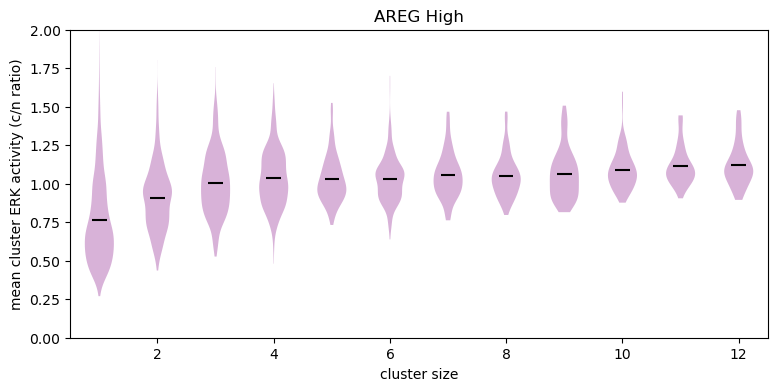

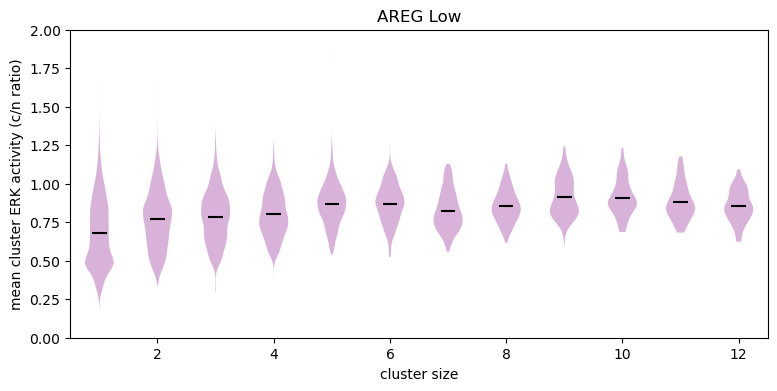

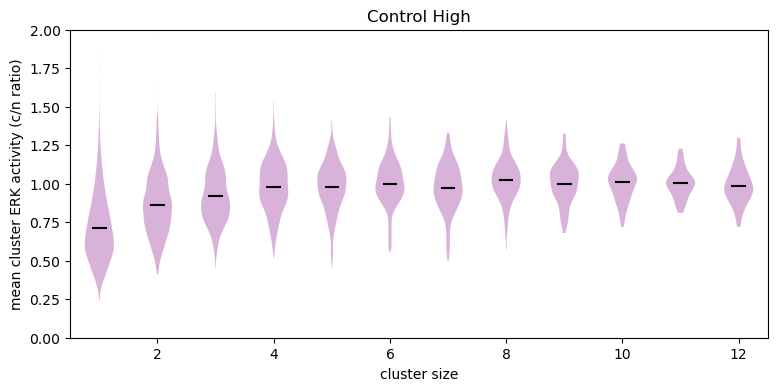

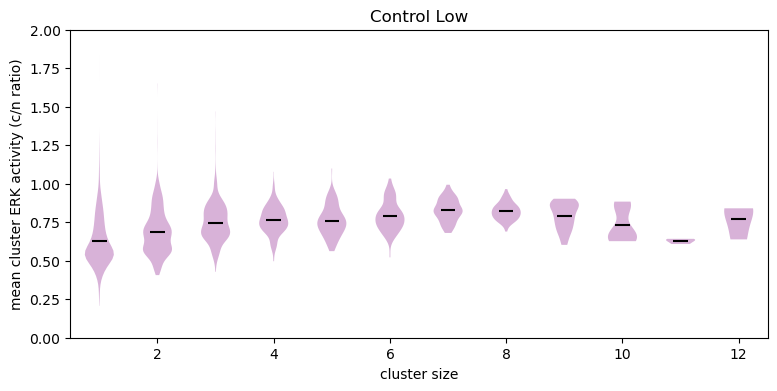

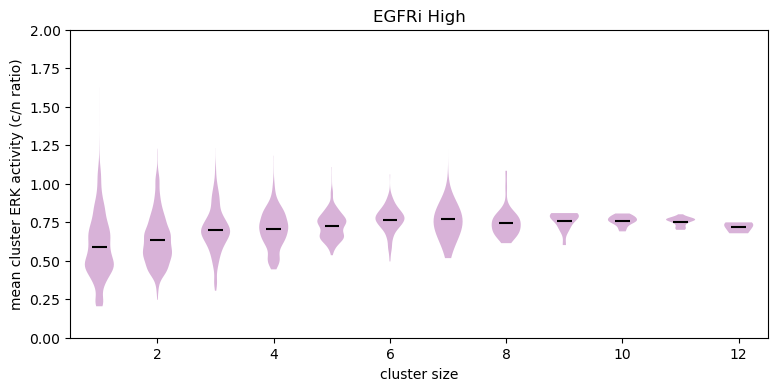

...

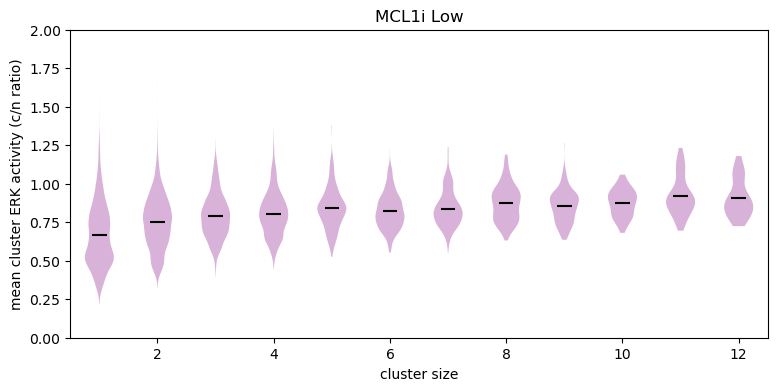

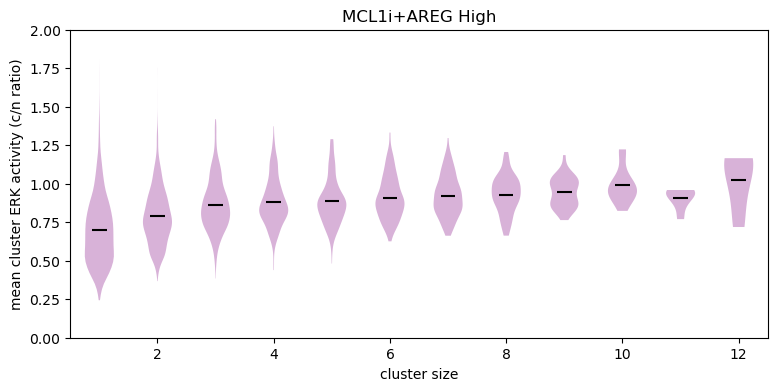

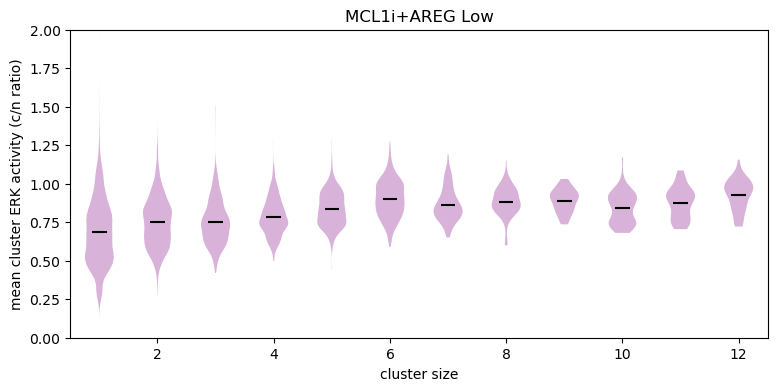

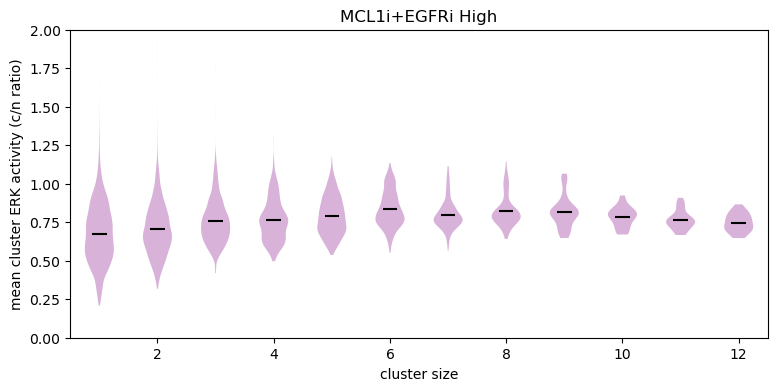

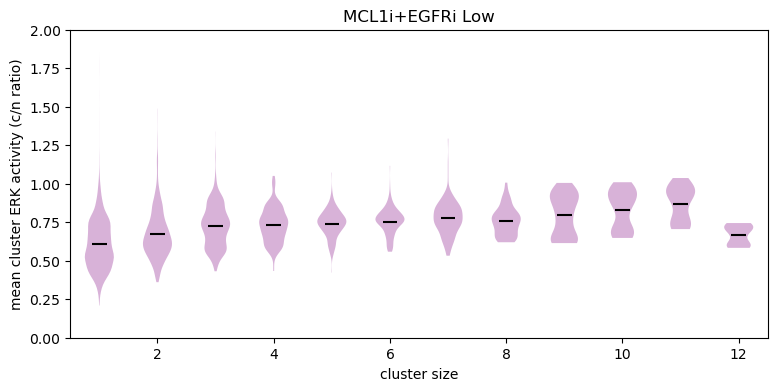

In [114]:
for i_tm in range(nf):
    Smean_csize=Smean_csize_set[i_tm]
    csize=csize_set[i_tm]
    plt.figure(figsize=(9,4))
    ax=plt.gca()
    for i_size in range(np.max(csize)):
        inds=csize==i_size
        setv=Smean_csize[inds]
        setv=setv[np.isfinite(setv)]
        if setv.size>0:
            vplot=ax.violinplot(setv,positions=[i_size],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
            vplot['cmeans'].set_color('black')
            for pc in vplot['bodies']:
                pc.set_facecolor('purple')    
    plt.ylabel('mean cluster ERK activity (c/n ratio)')
    plt.xlabel('cluster size')
    plt.title(tmSet[i_tm])
    plt.ylim(0,2)
    plt.xlim(0.5,12.5)
    plt.savefig(f'{date}/smeans_csize_{data_id}_{tmSet[i_tm]}.png')
    plt.pause(.1)

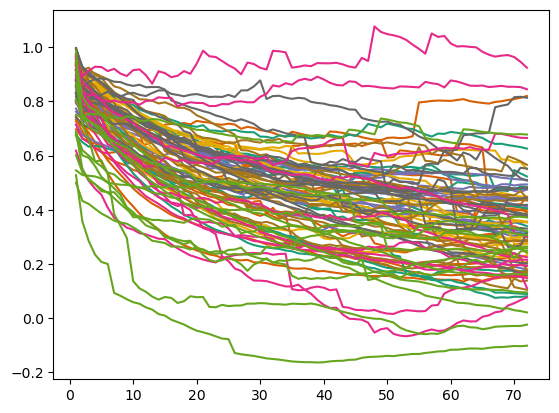

In [39]:
tcfSet=[None]*nmodels
for imodel in indgood_models:
    sctm=modelSet[imodel]
    tcf=sctm.get_tcf(x=sctm.Xpca,minlength=1)
    av_sq=np.sum(np.power(np.nanmean(sctm.Xpca,axis=0),2))
    avsq=np.nanmean(np.power(np.linalg.norm(sctm.Xpca,axis=1),2))
    tcf=(tcf-av_sq)/tcf[0] #auto-correlation
    tcfSet[imodel]=tcf
    plt.plot(np.arange(1,tcf.size+1),tcf,color=colorSet[inds_tmSet_models[imodel]],label=tmSet[inds_tmSet_models[imodel]])

/tmp/ipykernel_201779/1962440446.py:10: RuntimeWarning: Mean of empty slice
  tcf_tm[i_tm]=np.nanmean(tcfs,axis=1)


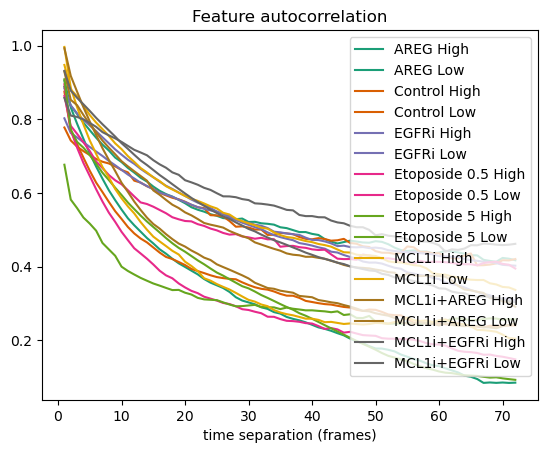

In [40]:
tcf_tm=[None]*nf
tmax=80
for i_tm in range(nf):
    ind_models=indgood_models[inds_tmSet_models[indgood_models]==i_tm]
    tcfs=np.ones((tmax,ind_models.size))*np.nan
    for ii in range(ind_models.size):
        tmax_model=tcfSet[ind_models[ii]].size
        tmax_model=np.min(np.array([tmax,tmax_model]))
        tcfs[0:tmax_model,ii]=tcfSet[ind_models[ii]][0:tmax_model]
    tcf_tm[i_tm]=np.nanmean(tcfs,axis=1)
    plt.plot(np.arange(1,tmax+1),tcf_tm[i_tm],color=colorSet[i_tm],label=tmSet[i_tm])

#plt.ylim(-.1,.3)
plt.title('Feature autocorrelation');plt.xlabel('time separation (frames)');plt.legend(loc='upper right')
plt.savefig(f'{date}/timecorrelations_{data_id}.png')

In [119]:
sctm.Xf_feature_list

array([b'featBoundary-0_msk0img2', b'featBoundary-1_msk0img2',
       b'featBoundary-2_msk0img2', b'featBoundary-3_msk0img2',
       b'featBoundary-4_msk0img2', b'featBoundary-5_msk0img2',
       b'featBoundary-6_msk0img2', b'featBoundary-7_msk0img2',
       b'featBoundary-8_msk0img2', b'featBoundary-9_msk0img2',
       b'featBoundary-10_msk0img2', b'featBoundary-11_msk0img2',
       b'featBoundary-12_msk0img2', b'featBoundary-13_msk0img2',
       b'featBoundary-14_msk0img2', b'featBoundaryCB-0_msk0img0_fmsk',
       b'featBoundaryCB-1_msk0img0_fmsk',
       b'featBoundaryCB-2_msk0img0_fmsk',
       b'featBoundaryCB-3_msk0img0_fmsk',
       b'featBoundaryCB-4_msk0img0_fmsk',
       b'featBoundaryCB-5_msk0img0_fmsk',
       b'featBoundaryCB-6_msk0img0_fmsk',
       b'featBoundaryCB-7_msk0img0_fmsk',
       b'featBoundaryCB-8_msk0img0_fmsk',
       b'featBoundaryCB-9_msk0img0_fmsk',
       b'featBoundaryCB-10_msk0img0_fmsk',
       b'featBoundaryCB-11_msk0img0_fmsk',
       b'featBoundar

In [41]:
#trajectory embedding
trajl=61
ind_cb=np.where(Xf_feature_list==b'featBoundaryCB-0_msk0img0_fmsk')[0][0]
pca.ndim=modelSet[indgood_models[0]].Xpca.shape[1]
Xpcat=np.zeros((0,pca.ndim*trajl))
indtreatment_traj=np.array([]).astype(int)
indstack_traj=np.array([]).astype(int)
indframes_traj=np.array([]).astype(int)
cellinds0_traj=np.array([]).astype(int)
cellinds1_traj=np.array([]).astype(int)
cb_ratio_traj=np.array([])
cratio_erk_traj=np.array([]).astype(float)
z_traj=np.array([]).astype(float)
cratio_erk_full_traj=np.zeros((0,trajl))
cratio_akt_traj=np.array([]).astype(float)
cratio_akt_full_traj=np.zeros((0,trajl))
cb_ratio_full_traj=np.zeros((0,trajl))
dx_full_traj=np.zeros((0,trajl))
dx_traj=np.array([])
beta_traj=np.array([])
alpha_traj=np.array([])
for i in indgood_models:
    print('building trajectory data for model {}...'.format(i))
    modelSet[i].trajectories=all_trajSet[i].copy()
    modelSet[i].trajl=trajl
    modelSet[i].traj=modelSet[i].get_traj_segments(trajl)
    data=modelSet[i].Xpca[modelSet[i].traj,:]
    #datacom=modelSet[i].Xf_com[modelSet[i].traj,:]
    data=data.reshape(modelSet[i].traj.shape[0],modelSet[i].Xpca.shape[1]*trajl)
    #datacom=datacom.reshape(modelSet[i].traj.shape[0],modelSet[i].Xf_com.shape[1]*trajl)
    #data=np.append(data,datacom,axis=1)
    indgood=np.where(np.sum(np.isnan(data),axis=1)==0)[0]
    data=data[indgood,:]
    modelSet[i].traj=modelSet[i].traj[indgood,:]
    Xpcat=np.append(Xpcat,data,axis=0)
    indtreatment_traj=np.append(indtreatment_traj,i*np.ones(data.shape[0]).astype(int))
    indstacks=modelSet[i].cells_imgfileSet[modelSet[i].traj[:,0]]
    indstack_traj=np.append(indstack_traj,indstacks)
    indframes=modelSet[i].cells_frameSet[modelSet[i].traj[:,0]]
    indframes_traj=np.append(indframes_traj,indframes)
    cellinds0=modelSet[i].traj[:,0]
    cellinds0_traj=np.append(cellinds0_traj,cellinds0)
    cellinds1=modelSet[i].traj[:,-1]
    #cc_ratio=modelSet[i].cc_ratio[cellinds1]
    #cc_ratio_traj=np.append(cc_ratio_traj,cc_ratio)
    cellinds1_traj=np.append(cellinds1_traj,cellinds1)
    cratio_erk_traj=np.append(cratio_erk_traj,modelSet[i].x_signal[cellinds1])
    cratio_erk_full_traj=np.append(cratio_erk_full_traj,modelSet[i].x_signal[modelSet[i].traj],axis=0)
    cratio_akt_traj=np.append(cratio_akt_traj,modelSet[i].x_signal_akt[cellinds1])
    cratio_akt_full_traj=np.append(cratio_akt_full_traj,modelSet[i].x_signal_akt[modelSet[i].traj],axis=0)
    cb_ratio_traj=np.append(cb_ratio_traj,modelSet[i].Xf[cellinds1,ind_cb])
    cb_ratio_full_traj=np.append(cb_ratio_full_traj,modelSet[i].Xf[modelSet[i].traj,ind_cb],axis=0)
    z_traj=np.append(z_traj,np.mean(modelSet[i].cellblocks[:,0],axis=1)[cellinds1])
    dx_traj=np.append(dx_traj,modelSet[i].m0_comdx_feat[cellinds1,0])
    beta_traj=np.append(beta_traj,modelSet[i].m0_comdx_feat[cellinds1,1])
    alpha_traj=np.append(alpha_traj,modelSet[i].m0_comdx_feat[cellinds1,2])
    dx_full_traj=np.append(dx_full_traj,modelSet[i].m0_comdx_feat[modelSet[i].traj,0],axis=0)

cellinds0_traj=cellinds0_traj.astype(int)
cellinds1_traj=cellinds1_traj.astype(int)

x=Xpcat #x=np.matmul(Xpcat,np.real(M)) #x=np.concatenate((np.real(np.matmul(Xpcat,M)),np.imag(np.matmul(Xpcat,M))),axis=1) #x=np.concatenate((np.real(phi_X[:,indmodes_M1]),np.imag(phi_X[:,indmodes_M1])),axis=1)
for i in indgood_models:
    modelSet[i].trajectories=all_trajSet[i].copy()

neigen=x.shape[1]
inds_conditions=[None]*nf
for imf in range(nf):
    indmodels=np.intersect1d(indgood_models,np.where(inds_tmSet_models==imf)[0])
    indstm=np.array([])
    for imodel in indmodels:
        indtm=np.where(indtreatment_traj==imodel)
        indstm=np.append(indstm,indtm)
    inds_conditions[imf]=indstm.astype(int).copy()

neigen=x.shape[1]
inds_conditions=[None]*nf
for imf in range(nf):
    indmodels=np.intersect1d(indgood_models,np.where(inds_tmSet_models==imf)[0])
    indstm=np.array([])
    for imodel in indmodels:
        indtm=np.where(indtreatment_traj==imodel)
        indstm=np.append(indstm,indtm)
    inds_conditions[imf]=indstm.astype(int).copy()

#get transitions in the trajectory embedding space
x0set=np.zeros((0,neigen))
x1set=np.zeros((0,neigen))
inds_trajsteps_models=np.array([]).astype(int)
inds_trajsteps=np.zeros((0,2)).astype(int)
for i in indgood_models:
    print('getting flows from model: '+str(i))
    indstm=np.where(indtreatment_traj==i)[0]
    if indstm.size>0:
        modelSet[i].Xtraj=x[indstm,0:neigen]
        indstm_model=indstm-np.min(indstm) #index in model
        modelSet[i].get_trajectory_steps(inds=None,get_trajectories=False,traj=modelSet[i].traj[indstm_model,:],Xtraj=modelSet[i].Xtraj[indstm_model,:])
        x0=modelSet[i].Xtraj0
        x1=modelSet[i].Xtraj1
        x0set=np.append(x0set,x0,axis=0)
        x1set=np.append(x1set,x1,axis=0)
        inds_trajsteps_models=np.append(inds_trajsteps_models,np.ones(x0.shape[0]).astype(int)*i)
        inds_trajsteps=np.append(inds_trajsteps,modelSet[i].inds_trajp1,axis=0)

building trajectory data for model 0...
building trajectory data for model 1...
building trajectory data for model 4...
building trajectory data for model 7...
building trajectory data for model 8...
building trajectory data for model 10...
building trajectory data for model 11...
building trajectory data for model 12...
building trajectory data for model 14...
building trajectory data for model 15...
building trajectory data for model 16...
building trajectory data for model 19...
building trajectory data for model 20...
building trajectory data for model 21...
building trajectory data for model 22...
building trajectory data for model 24...
building trajectory data for model 25...
building trajectory data for model 26...
building trajectory data for model 29...
building trajectory data for model 30...
building trajectory data for model 32...
building trajectory data for model 33...
building trajectory data for model 34...
building trajectory data for model 35...
building trajectory d

#### Data-driven modeling

In [43]:
#Analysis identifiers
date='29aug24'
figid=f'T4_tl{trajl}_{date}'
os.system(f'mkdir -p {date}')

0

In [44]:
x.shape

(678592, 122)

In [45]:
#get microstate clusters
n_clusters=200
clusters_sklearn=sklearn.cluster.KMeans(n_clusters=n_clusters,init='k-means++',n_init=10,max_iter=1000,random_state=0)
clusters_sklearn.fit(x)
clusters=coor.clustering.AssignCenters(clusters_sklearn.cluster_centers_, metric='euclidean') #for back-compatibility with celltraj.model tools

In [ ]:
#check out a umap of the embedding space
#import sklearn
#reducer=umap.UMAP(n_components=2) #, metric='euclidean')
#reducer=sklearn.manifold.TSNE(n_components=2)
#trans = reducer.fit(x.astype(np.float32))
#x_umap=trans.embedding_

#plot umap of the embedding space
fig,ax=plt.subplots(1,2,figsize=(12,6))

ax[0].scatter(x_umap[:,0],x_umap[:,1],s=20,c=cratio_erk_traj,cmap=plt.cm.seismic)
ax[0].set_title('ERK')
ind_clusters=clusters.assign(x)
x_umap_clusters=np.zeros((n_clusters,2))
for iclust in np.unique(ind_clusters):
    indclust=np.where(ind_clusters==iclust)[0]
    x_umap_clusters[iclust,:]=np.mean(x_umap[indclust,:],axis=0)
    ax[0].text(x_umap_clusters[iclust,0],x_umap_clusters[iclust,1],str(iclust))
    ax[0].axis('off')

ax[1].scatter(x_umap[:,0],x_umap[:,1],s=20,c=cratio_akt_traj,cmap=plt.cm.seismic)
ax[1].set_title('AKT')
ind_clusters=clusters.assign(x)
x_umap_clusters=np.zeros((n_clusters,2))
for iclust in np.unique(ind_clusters):
    indclust=np.where(ind_clusters==iclust)[0]
    x_umap_clusters[iclust,:]=np.mean(x_umap[indclust,:],axis=0)
    ax[1].text(x_umap_clusters[iclust,0],x_umap_clusters[iclust,1],str(iclust))
    ax[1].axis('off')

plt.savefig(f'{date}/dMAP_{figid}.png')
plt.show()

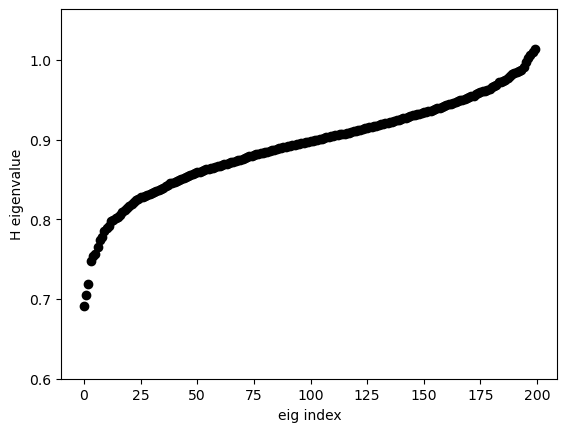

In [48]:
#Markov state model
centers_minima=clusters.clustercenters.copy()
clusters_minima=coor.clustering.AssignCenters(centers_minima, metric='euclidean')
P=model.get_transition_matrix(x0set,x1set,clusters=clusters_minima)
graph = csr_matrix(P>0.)
n_components, labels = connected_components(csgraph=graph, directed=False, return_labels=True)
unique, counts = np.unique(labels, return_counts=True)
icc=unique[np.argmax(counts)]
indcc=np.where(labels==icc)[0]
centers_minima=centers_minima[indcc,:];stateCenters=centers_minima
clusters_minima=coor.clustering.AssignCenters(centers_minima, metric='euclidean')
P=model.get_transition_matrix(x0set,x1set,clusters=clusters_minima)
n_clusters=indcc.size

H=.5*(P+np.transpose(P))+.5j*(P-np.transpose(P))
w,v=np.linalg.eig(H)
w=np.real(w)
indsort=np.argsort(w)
w=w[indsort]
v=v[:,indsort]

plt.clf()
plt.plot(np.arange(n_clusters),w,'ko',label='eigenvalues')
plt.ylim(.6,np.max(w)+.05*np.max(w))
plt.xlabel('eig index')
plt.ylabel('H eigenvalue')
plt.pause(.1)

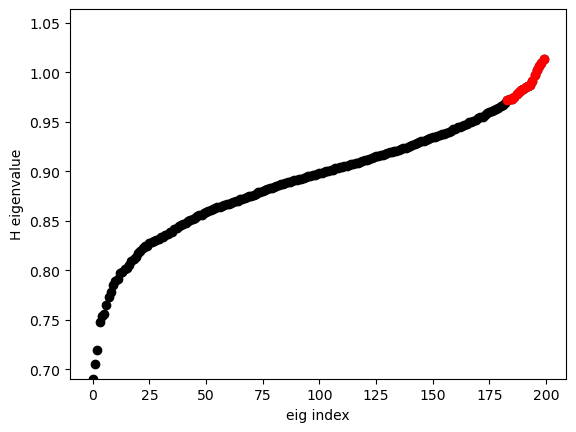

In [51]:
ncomp=17 #number of eigencomponents to keep
vr=np.multiply(w[-ncomp:],np.real(v[:,-ncomp:]))
vi=np.multiply(w[-ncomp:],np.imag(v[:,-ncomp:]))
vkin=np.append(vr,vi,axis=1)
va=np.abs(v[:,-ncomp:])
vkin=np.append(vr,vi,axis=1)
vth=np.arctan2(vr,vi)
plt.clf()
plt.plot(np.arange(n_clusters),w,'ko',label='eigenvalues')
#plt.plot(dense_range,wdense,'k-',label='spline')
plt.plot(np.arange(n_clusters)[-ncomp:],w[-ncomp:],'ro')
plt.ylim(np.min(w),np.max(w)+.05*np.max(w))
plt.xlabel('eig index')
plt.ylabel('H eigenvalue')
plt.savefig(f'{date}/eigenvalues_{figid}.png')
plt.pause(.1)

In [52]:
get_cluster_embedding=True
if get_cluster_embedding:
    reducer=umap.UMAP(n_components=2) #n_neighbors=int(n_clusters),min_dist=0.1, n_components=2, metric='euclidean')
    #reducer=sklearn.manifold.TSNE(n_components=2)
    trans = reducer.fit(vkin)
    x_clusters=trans.embedding_
    np.save(f'{date}/cluster_embedding_nc{n_clusters}_ncomp{ncomp}_{figid}.npy',x_clusters)
else:
    x_clusters=np.load(f'{date}/cluster_embedding_nc{n_clusters}_ncomp{ncomp}_{figid}.npy')

ind_clusters=clusters_minima.assign(x)
x_clusters_all=x_clusters[ind_clusters,:]

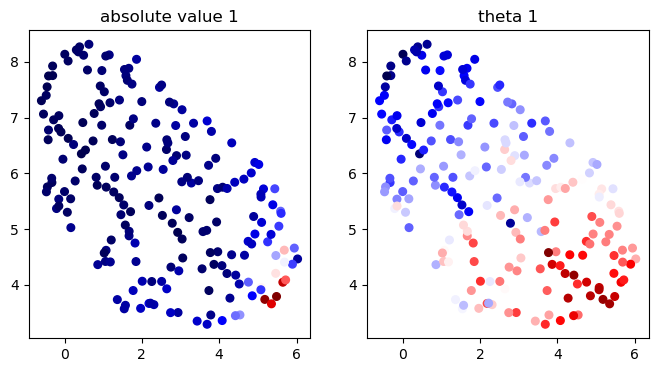

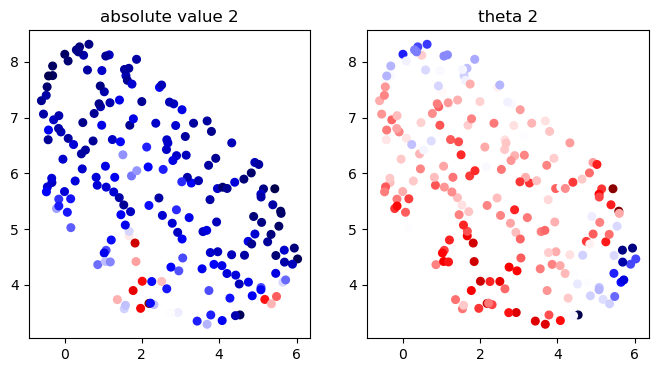

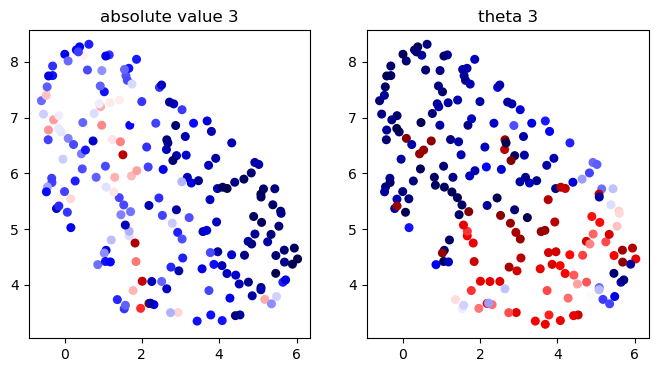

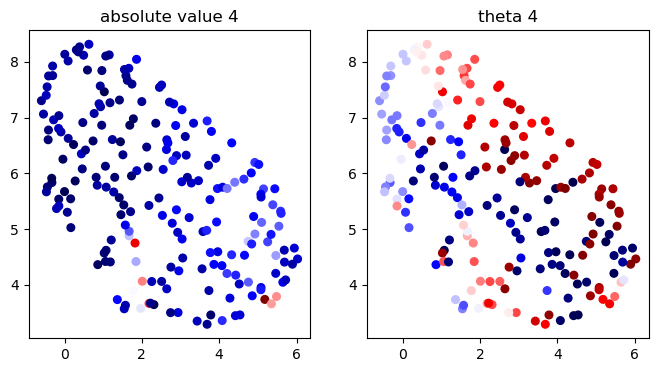

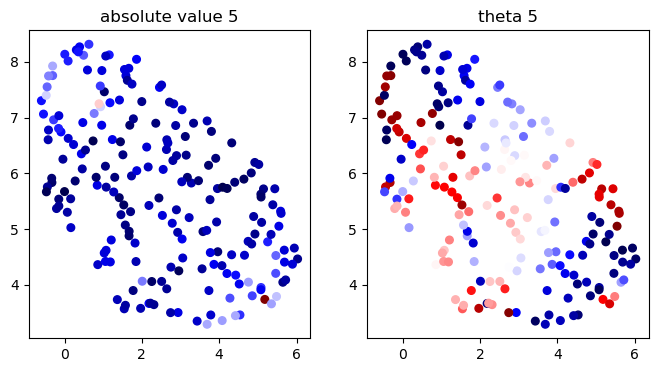

...

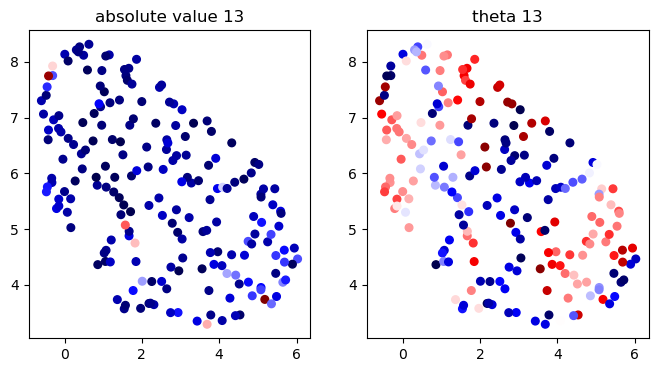

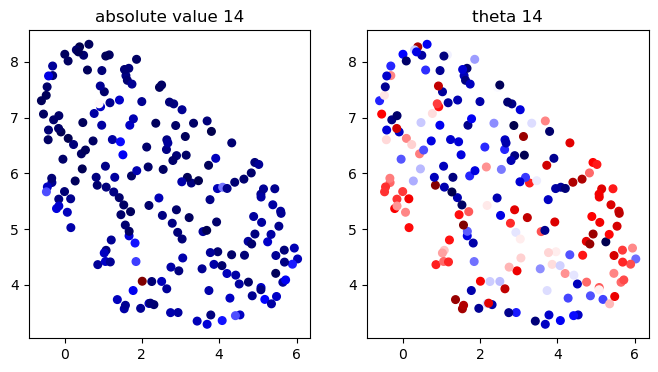

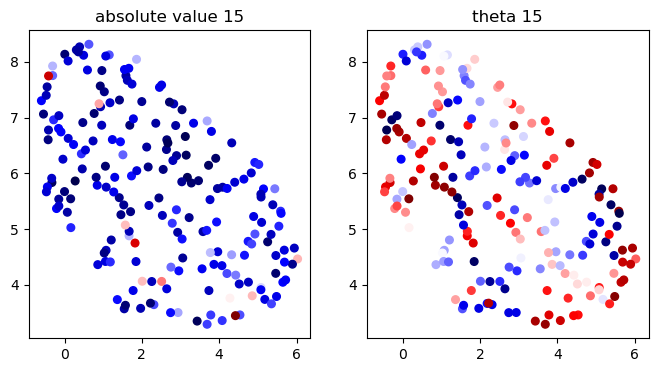

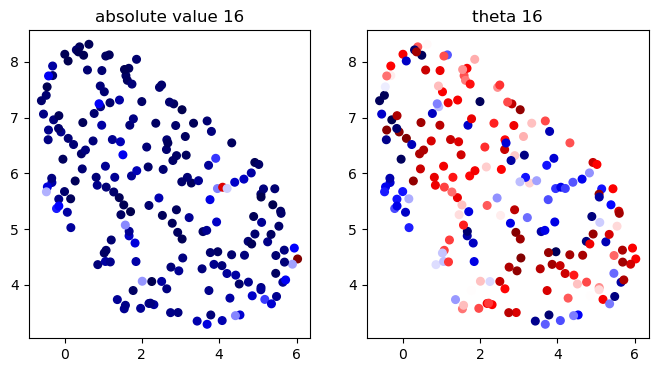

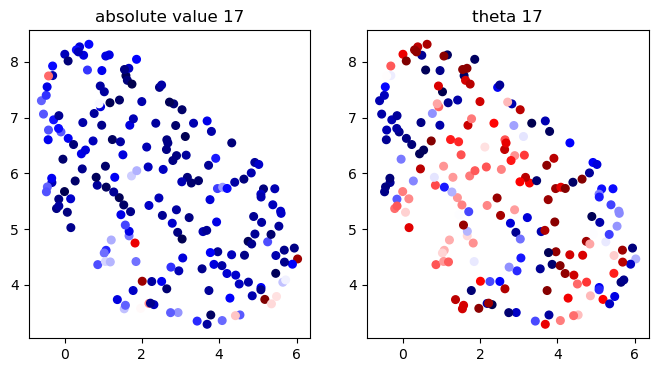

In [53]:
plt.close('all')
for icomp in range(ncomp-1,0-1,-1): #range(ncomp):
    plt.figure(figsize=(8,4))
    plt.subplot(1,2,1);plt.scatter(x_clusters[:,0],x_clusters[:,1],s=30,c=va[:,icomp],cmap=plt.cm.seismic)
    plt.title('absolute value '+str(ncomp-icomp))
    plt.subplot(1,2,2);plt.scatter(x_clusters[:,0],x_clusters[:,1],s=30,c=vth[:,icomp],cmap=plt.cm.seismic)
    plt.title('theta '+str(ncomp-icomp))
    plt.savefig(date+'/componentrth_'+str(ncomp-icomp)+'_H_nc'+str(n_clusters)+'_ncomp'+str(ncomp)+'_'+figid+'.png')

In [54]:
dx_clusters=np.zeros((nf,n_clusters,2))
MtSet=[None]*nf
for i in range(nf):
    indmodels=np.where(inds_tmSet_models==i)[0]
    indstm=np.array([]).astype(int)
    for imodel in indmodels:
        indstm=np.append(indstm,np.where(inds_trajsteps_models==imodel)[0].astype(int))
    x0=x0set[indstm,:]
    x1=x1set[indstm,:]
    Mt=model.get_transition_matrix(x0,x1,clusters_minima)
    MtSet[i]=Mt.copy()
    dxmatrix=np.zeros((n_clusters,n_clusters,2))
    for ii in range(n_clusters):
        for jj in range(n_clusters):
            dxmatrix[ii,jj]=(x_clusters[jj,:]-x_clusters[ii,:])*Mt[ii,jj]
    dx_clusters[i,:,:]=np.sum(dxmatrix,axis=1)

dx_clusters_smooth=np.zeros_like(dx_clusters)
knn=10
for i in range(nf):
    for iclust in range(n_clusters):
        xc=np.array([clusters_minima.clustercenters[iclust,:]])
        dmatr=utilities.get_dmat(clusters_minima.clustercenters,xc) #get closest cells to cluster center
        indr=np.argsort(dmatr[:,0])
        indr=indr[0:knn]
        dx_clusters_smooth[i,iclust,:]=np.mean(dx_clusters[i,indr,:],axis=0)

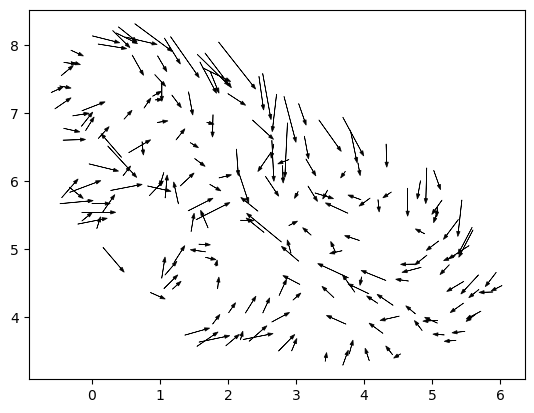

In [55]:
dxsav=np.mean(dx_clusters_smooth,axis=0)
ascale=6.0
ax=plt.gca()
for ic in range(n_clusters):
    ax.arrow(x_clusters[ic,0],x_clusters[ic,1],ascale*dxsav[ic,0],ascale*dxsav[ic,1],head_width=.05,linewidth=.5,color='black',alpha=1.0)

plt.axis('equal')
plt.savefig(date+'/dx_clusters_'+figid+'.png')
plt.savefig(date+'/dx_clusters_'+figid+'.pdf')
plt.pause(.1)

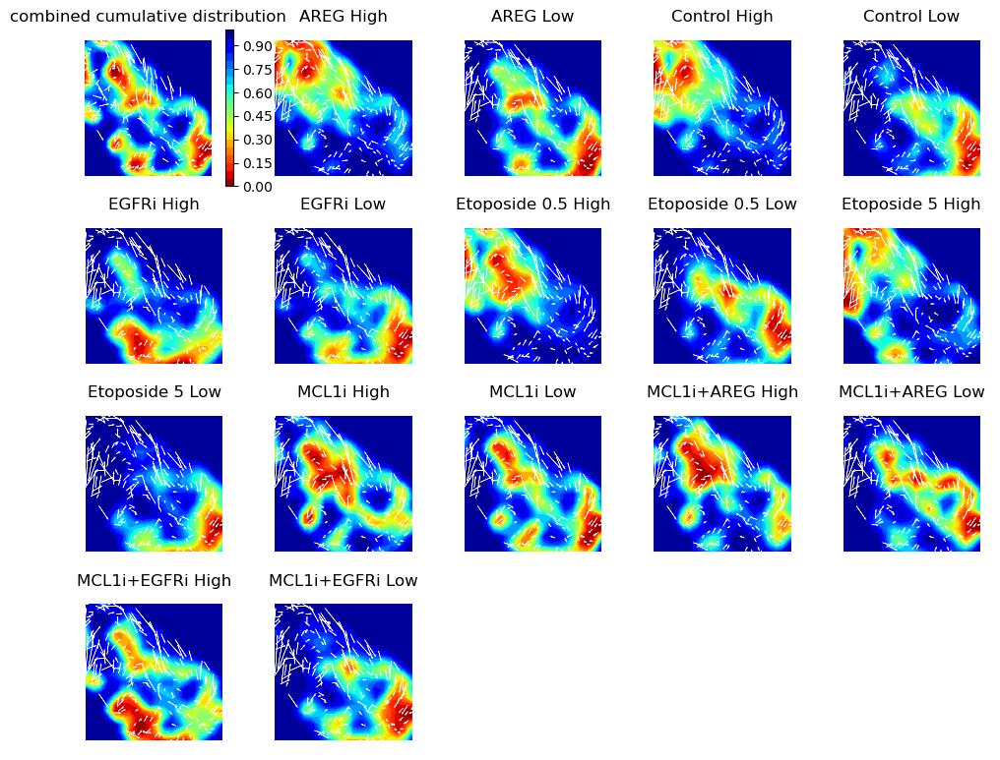

In [56]:
plt.close('all')
nbins=20
fl=0
fu=192 #frames for time window
sml=1
nplots=int(np.ceil(np.sqrt(nf+1)))
plt.figure(figsize=(12,12))
indstw=np.where(np.logical_and(indframes_traj<fu,indframes_traj>fl))[0]
probSet=[None]*nf
plt.subplot(nplots,nplots,1)
prob1,xedges1,yedges1=np.histogram2d(x_clusters_all[indstw,0],x_clusters_all[indstw,1],bins=nbins,density=True)
prob1=scipy.ndimage.gaussian_filter(prob1,sigma=sml)
prob1c=utilities.get_cdist2d(prob1)
xx,yy=np.meshgrid(.5*xedges1[1:]+.5*xedges1[0:-1],.5*yedges1[1:]+.5*yedges1[0:-1])
levels=np.linspace(0,1,21)
cs=plt.contourf(xx,yy,prob1c.T,levels=levels,cmap=plt.cm.jet_r)
cbar=utilities.colorbar(cs)
#cbar.set_label('cumulative probability')
plt.title('combined cumulative distribution')
plt.axis('off')
for ic in range(n_clusters):
    ax=plt.gca()
    ax.arrow(x_clusters[ic,0],x_clusters[ic,1],ascale*dxsav[ic,0],ascale*dxsav[ic,1],head_width=.05,linewidth=.4,color='white',alpha=1.0)
    
for imf in range(nf):
    tm=tmSet[imf]
    indstm=inds_conditions[imf]
    indstwm=np.intersect1d(indstm,indstw)
    prob,xedges2,yedges2=np.histogram2d(x_clusters_all[indstwm,0],x_clusters_all[indstwm,1],bins=[xedges1,yedges1],density=True)
    #prob=prob/np.sum(prob)
    prob=scipy.ndimage.gaussian_filter(prob,sigma=sml)
    probc=utilities.get_cdist2d(prob)
    probSet[imf]=prob.copy()
    plt.subplot(nplots,nplots,imf+2)
    #levels=np.linspace(0,np.max(prob),100)
    cs=plt.contourf(xx,yy,probc.T,levels=levels,cmap=plt.cm.jet_r,extend='both')
    dxf=dx_clusters_smooth[i,:,:]
    ax=plt.gca()
    for ic in range(n_clusters):
        ax.arrow(x_clusters[ic,0],x_clusters[ic,1],ascale*dxf[ic,0],ascale*dxf[ic,1],head_width=.05,linewidth=.4,color='white',alpha=1.0)
    plt.title(tmSet[imf])
    cs.cmap.set_over('darkred')
    plt.axis('off')

plt.savefig(date+'/probflows_'+figid+'.png')

In [57]:
ntraj=x.shape[0]
erk_akt_crosscorr=np.zeros(ntraj)
for i in range(ntraj):
    erk_akt_crosscorr[i]=np.corrcoef(cratio_erk_full_traj[i,:],cratio_akt_full_traj[i,:])[0,1]

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


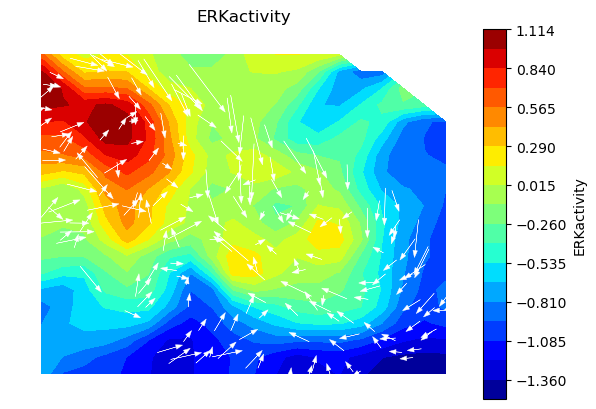

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


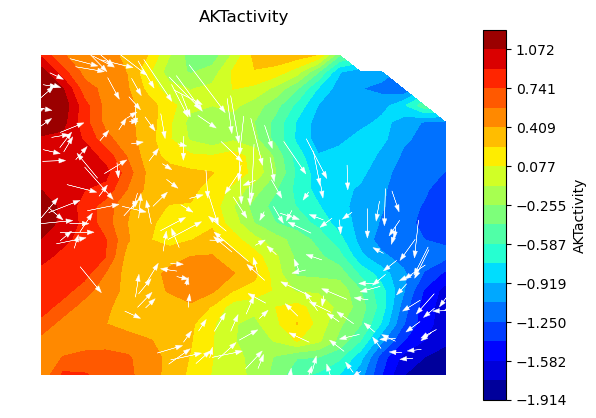

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


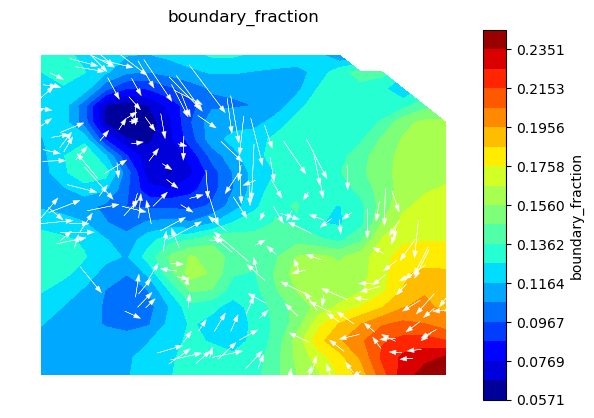

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


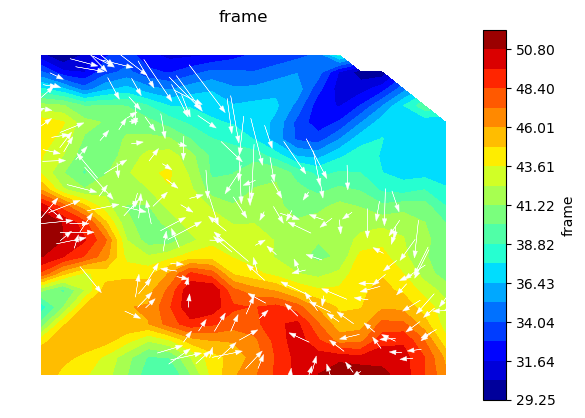

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


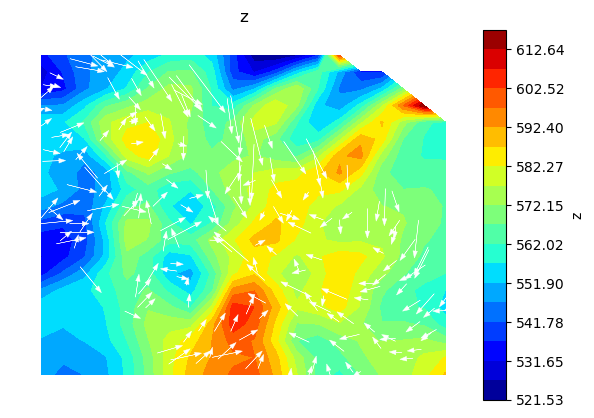

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


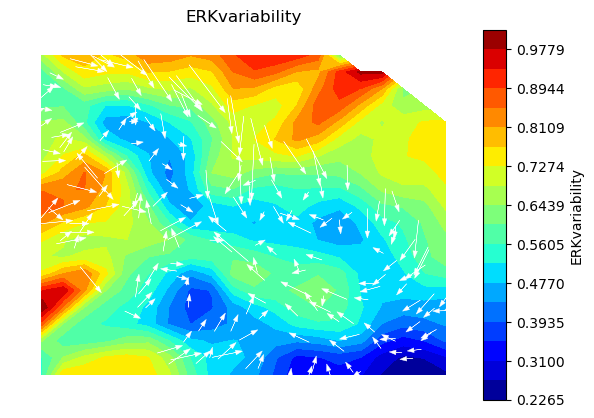

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


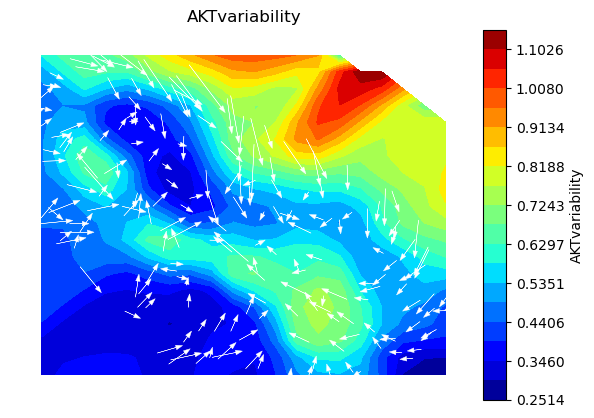

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


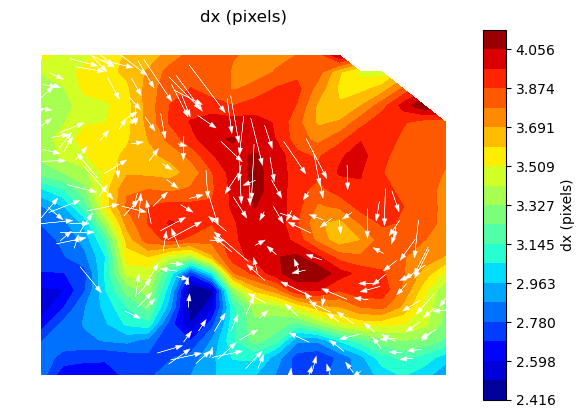

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


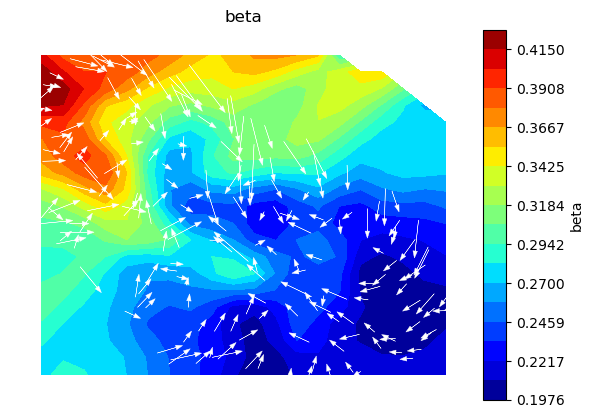

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


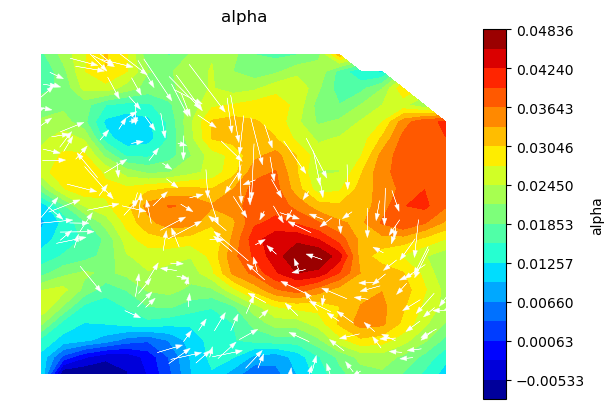

/tmp/ipykernel_201779/1366800584.py:21: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


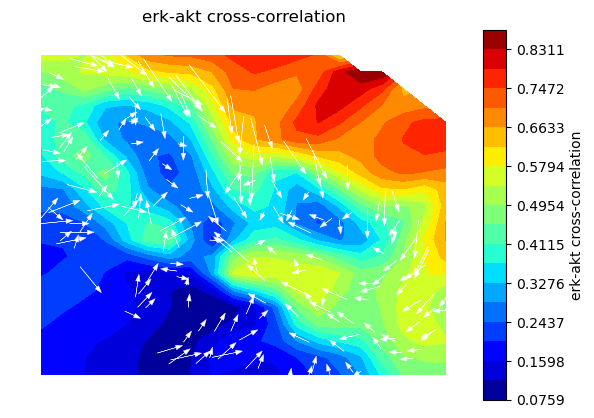

In [58]:
cratio_erk_var_traj=np.std(cratio_erk_full_traj,axis=1)
cratio_akt_var_traj=np.std(cratio_akt_full_traj,axis=1)
#vsetList=[corrc_traj,cb_ratio_traj-cbc_ratio_traj,cbc_ratio_traj,indframes_traj,z_traj,corrc_var_traj,dx_traj]
#captionset=['ERKactivity','normal_boundary_fraction','cancer_boundary_fraction','frame','z','ERKvariability','dx (pixels)']
vsetList=[cratio_erk_traj,cratio_akt_traj,cb_ratio_traj,indframes_traj,z_traj,cratio_erk_var_traj,cratio_akt_var_traj,dx_traj,beta_traj,alpha_traj,erk_akt_crosscorr]
captionset=['ERKactivity','AKTactivity','boundary_fraction','frame','z','ERKvariability','AKTvariability','dx (pixels)','beta','alpha','erk-akt cross-correlation']
#vset=cb_ratio_traj
#vset=cc_ratio_traj
#vset=Xpcat[:,-3]
nf=len(tmSet)
nbins=20
for iv in range(len(vsetList)):
    vset=vsetList[iv]
    indg=np.where(np.logical_and(np.logical_not(np.isnan(vset)),np.logical_not(np.isinf(vset))))[0]
    plt.figure()
    #plt.subplot(4,4,1)
    vdist1,xedges1,yedges1=np.histogram2d(x_clusters_all[indg,0],x_clusters_all[indg,1],bins=nbins,weights=vset[indg])
    vdist1=scipy.ndimage.gaussian_filter(vdist1,sigma=sml)
    norm1,xedges1,yedges1=np.histogram2d(x_clusters_all[indg,0],x_clusters_all[indg,1],bins=[xedges1,yedges1])
    norm1=scipy.ndimage.gaussian_filter(norm1,sigma=sml)
    vdist1=np.divide(vdist1,norm1)
    indnan=np.where(np.isnan(vdist1))
    indgood=np.where(np.logical_and(np.logical_not(np.isnan(vdist1)),np.logical_not(np.isinf(vdist1))))
    xedges1c=.5*(xedges1[1:]+xedges1[0:-1])
    yedges1c=.5*(yedges1[1:]+yedges1[0:-1])
    xx,yy=np.meshgrid(xedges1c,yedges1c)
    levels=np.linspace(np.min(vdist1[indgood]),np.max(vdist1[indgood]),20)
    cs=plt.contourf(xx,yy,vdist1.T,cmap=plt.cm.jet,levels=levels)
    for ic in range(n_clusters):
        ax=plt.gca()
        ax.arrow(x_clusters[ic,0],x_clusters[ic,1],ascale*dxsav[ic,0],ascale*dxsav[ic,1],head_width=.07,linewidth=.3,color='white',alpha=1.0)
    cs.cmap.set_over('darkred')
    cs.cmap.set_under('darkblue')
    cbar=utilities.colorbar(cs)
    cbar.set_label(captionset[iv])
    #cbar.set_label('cell-cell boundary fraction')
    #cbar.set_label('speed')
    #cbar.set_label('beta')
    plt.title(captionset[iv])
    plt.axis('off')
    plt.savefig(date+'/'+captionset[iv]+'_wflows_comb_'+figid+'.png')
    plt.savefig(date+'/'+captionset[iv]+'_wflows_comb_'+figid+'.pdf')
    plt.pause(.4)

[0.005 0.995]
2 states initial, 1 states final
[0.005 0.425 0.57 ]
3 states initial, 2 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
2 states
[27.76143284 31.63417095 26.95869368 36.11281562 44.93776587 44.73416124
 26.71438217 31.66139635 36.23137565 28.82468105 26.02709197 39.76514305
 28.4419194  34.72525373 40.05293787 34.78859

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


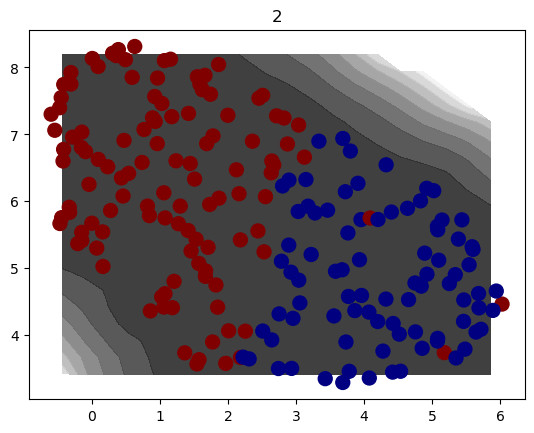

[0.005 0.005 0.225 0.765]
4 states initial, 2 states final
[0.005 0.005 0.02  0.285 0.685]
5 states initial, 2 states final
[0.005 0.005 0.005 0.245 0.255 0.485]
6 states initial, 3 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
3 states
[60.2393824  67.85228666 55.9644936  66.13275596 84.45451669 77.11936656
 48.94569814 75.6504044

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


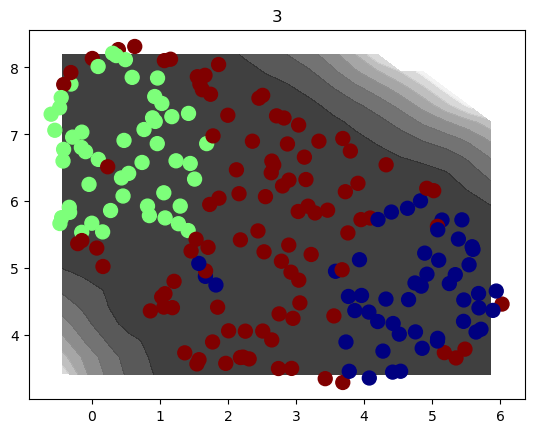

[0.005 0.005 0.005 0.035 0.145 0.23  0.575]
7 states initial, 4 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
4 states
[ 77.66528657  94.25934489  72.92247254  96.01960738 102.0096975
 106.4851041   85.00358359 105.22967621  80.48764395 112.48068025
  78.37213228  96.60328002  88.41422998  85.31585639 100.40307155
 109.9127941 ]


/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


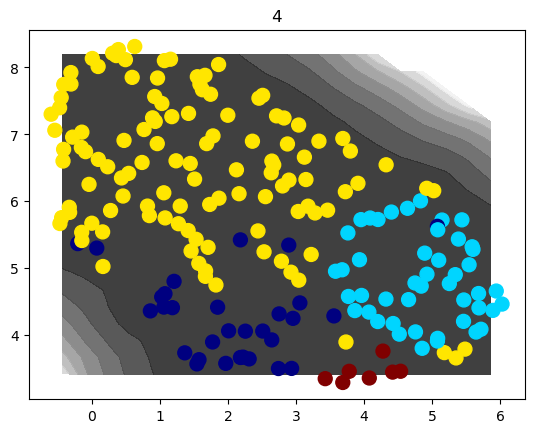

[0.005 0.005 0.005 0.005 0.13  0.235 0.25  0.365]
8 states initial, 4 states final
[0.005 0.005 0.005 0.005 0.01  0.125 0.16  0.195 0.49 ]
9 states initial, 4 states final
[0.005 0.005 0.005 0.005 0.01  0.08  0.115 0.13  0.305 0.34 ]
10 states initial, 5 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
5 states
[105.16605069 110.86434

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


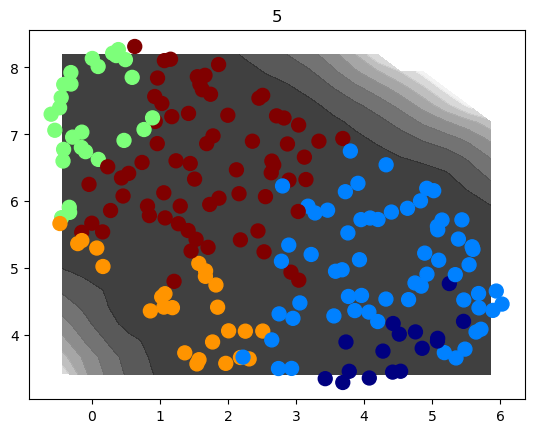

[0.005 0.005 0.005 0.005 0.015 0.015 0.035 0.08  0.17  0.185 0.48 ]
11 states initial, 5 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.02  0.03  0.035 0.17  0.27  0.435]
12 states initial, 4 states final
[0.005 0.005 0.005 0.005 0.01  0.03  0.035 0.08  0.12  0.125 0.14  0.15
 0.29 ]
13 states initial, 7 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood mo

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


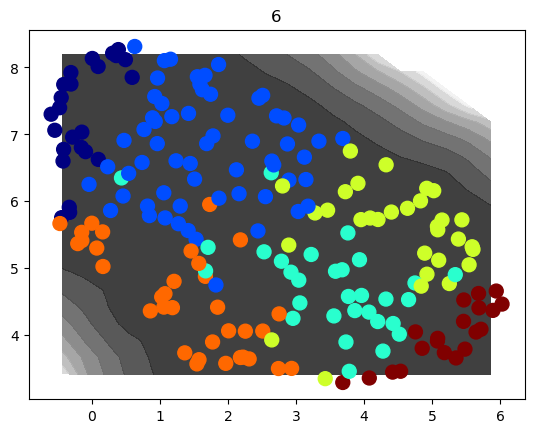

[0.005 0.005 0.005 0.005 0.01  0.01  0.035 0.045 0.05  0.09  0.14  0.165
 0.2   0.235]
14 states initial, 8 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
7 states
[146.05630842 162.81595501 137.95182309 174.87250677 166.16823934
 203.37863938 147.46787489 190.69186852 138.66570532 160.06578184
 130.2258497  184.05308104 162.7730418

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


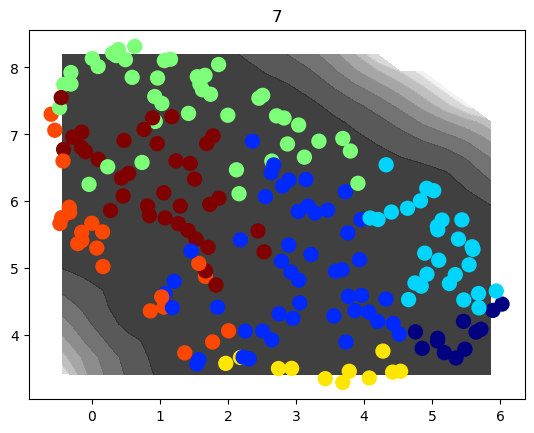

[0.005 0.005 0.005 0.005 0.01  0.01  0.02  0.02  0.04  0.045 0.06  0.095
 0.145 0.19  0.345]
15 states initial, 7 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.02  0.02  0.03  0.04  0.085 0.095
 0.115 0.13  0.17  0.255]
16 states initial, 7 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.015 0.015 0.035 0.055 0.075
 0.12  0.135 0.14  0.165 0.19 ]
17 states initial, 8 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+ARE

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


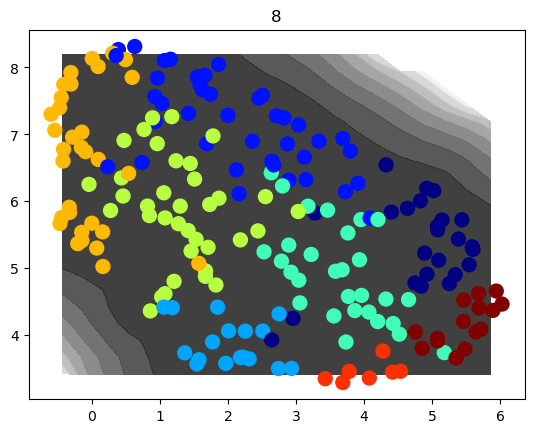

[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.03  0.03  0.05  0.08
 0.09  0.105 0.115 0.12  0.155 0.165]
18 states initial, 8 states final
[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.015 0.035 0.04  0.06
 0.08  0.08  0.09  0.11  0.125 0.125 0.185]
19 states initial, 10 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low
9 sta

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


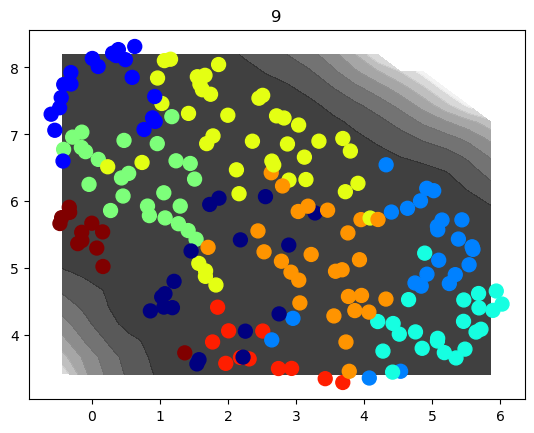

[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.015 0.02  0.02  0.035
 0.045 0.05  0.095 0.1   0.12  0.13  0.135 0.175]
20 states initial, 9 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.015 0.015 0.02  0.025
 0.035 0.035 0.06  0.06  0.09  0.115 0.14  0.15  0.18 ]
21 states initial, 9 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.015 0.025 0.03
 0.04  0.04  0.055 0.08  0.085 0.09  0.1   0.11  0.13  0.14 ]
22 states initial, 10 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


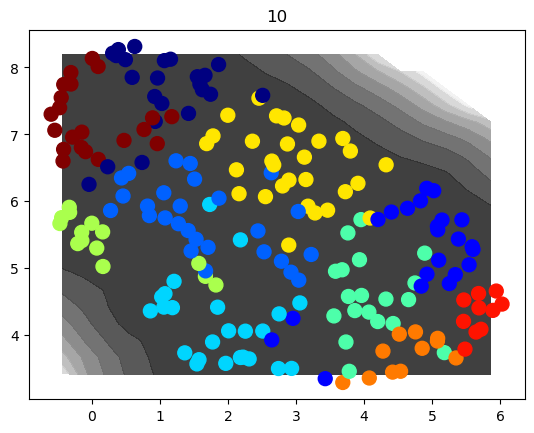

[0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.02  0.025
 0.03  0.04  0.04  0.04  0.065 0.085 0.1   0.11  0.11  0.115 0.15 ]
23 states initial, 10 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.015 0.02  0.025
 0.04  0.04  0.04  0.045 0.055 0.055 0.075 0.085 0.095 0.105 0.105 0.14 ]
24 states initial, 12 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


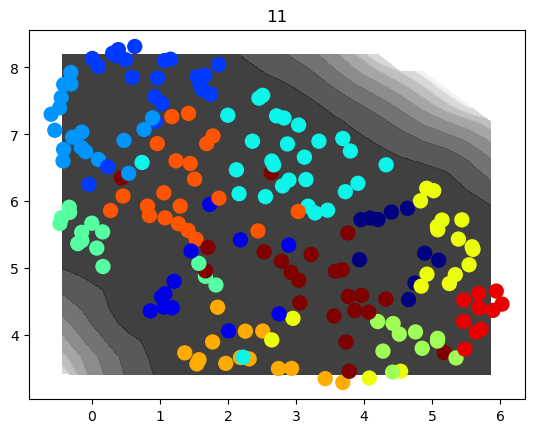

[0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.015 0.015
 0.025 0.03  0.035 0.04  0.05  0.055 0.08  0.085 0.085 0.085 0.09  0.1
 0.14 ]
25 states initial, 11 states final
[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.01  0.015 0.015
 0.015 0.025 0.035 0.055 0.06  0.06  0.065 0.07  0.075 0.08  0.08  0.08
 0.09  0.105]
26 states initial, 12 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building lik

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


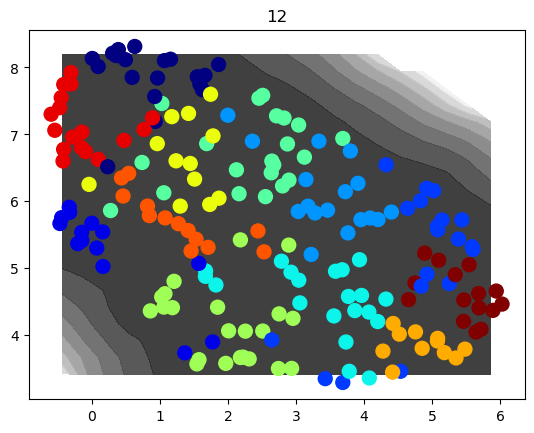

[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01
 0.015 0.025 0.025 0.025 0.025 0.025 0.05  0.055 0.06  0.075 0.09  0.095
 0.105 0.105 0.145]
27 states initial, 9 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.015
 0.015 0.015 0.02  0.025 0.03  0.04  0.045 0.05  0.055 0.07  0.075 0.08
 0.08  0.095 0.105 0.11 ]
28 states initial, 11 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.015 0.015
 0.015 0.015 0.02  0.02  0.03  0.035 0.04  0.04  0.05  0.05  0.065 0.065
 0.07  0.08  0.1   0.1   0.11 ]
29 states initial, 12 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01
 0.015 0.015 0.015 0.025 0.025 0.03  0.035 0.045 0.055 0.055 0.06  0.06
 0.06  0.065 0.08  0.08  0.1   0.1  ]
30 states initial, 12 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.015
 0.015 0.015 0.015 0.02  0.02  0.025 0.03  0.035 0.035 0.045 0.05  0.05
 0.055 0.06  0.075 0

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


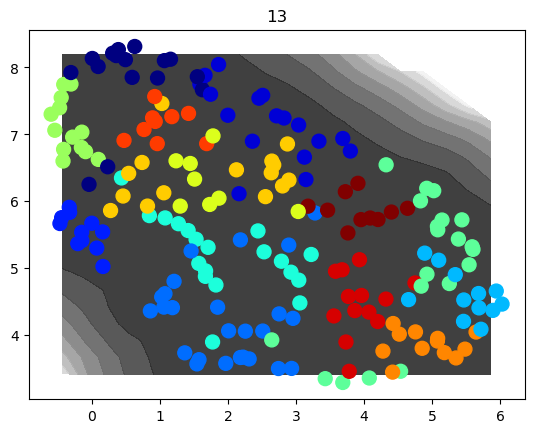

[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01
 0.01  0.01  0.01  0.015 0.025 0.025 0.03  0.03  0.03  0.03  0.035 0.05
 0.055 0.055 0.055 0.055 0.075 0.075 0.08  0.09  0.095]
33 states initial, 11 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01
 0.01  0.01  0.01  0.015 0.02  0.02  0.025 0.025 0.03  0.03  0.035 0.035
 0.035 0.04  0.04  0.045 0.06  0.06  0.075 0.075 0.11  0.12 ]
34 states initial, 12 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.01
 0.01  0.01  0.015 0.015 0.015 0.02  0.02  0.025 0.03  0.03  0.03  0.035
 0.035 0.04  0.04  0.04  0.05  0.055 0.065 0.07  0.07  0.09  0.125]
35 states initial, 12 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.01  0.01  0.01  0.01  0.015 0.015 0.015 0.015 0.02  0.025 0.03  0.03
 0.03  0.035 0.035 0.035 0.04  0.055 0.06  0.065 0.07  0.08  0.105 0.125]
36 states initial, 11 states final
[0.005 0.005 0.005 0.

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


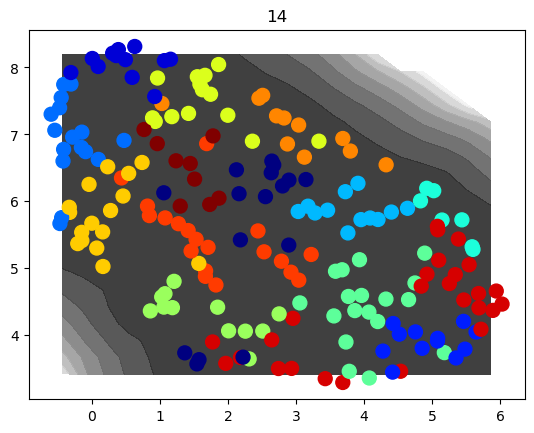

[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.01  0.01  0.01  0.01  0.015 0.015 0.015 0.015 0.02  0.02
 0.025 0.03  0.035 0.035 0.035 0.04  0.045 0.05  0.05  0.055 0.06  0.06
 0.065 0.065 0.07  0.07 ]
40 states initial, 14 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.01  0.01  0.01  0.01  0.01  0.015 0.015 0.015 0.015 0.015 0.02  0.02
 0.025 0.025 0.025 0.03  0.035 0.035 0.04  0.04  0.045 0.05  0.05  0.055
 0.055 0.06  0.06  0.07  0.075]
41 states initial, 13 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.01  0.01  0.01  0.01  0.015 0.015 0.02  0.02  0.02  0.02
 0.025 0.03  0.03  0.035 0.035 0.035 0.035 0.04  0.04  0.045 0.045 0.045
 0.05  0.05  0.05  0.055 0.065 0.07 ]
42 states initial, 15 states final
building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood mode

/tmp/ipykernel_201779/2906006139.py:33: RuntimeWarning: divide by zero encountered in log
  plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)


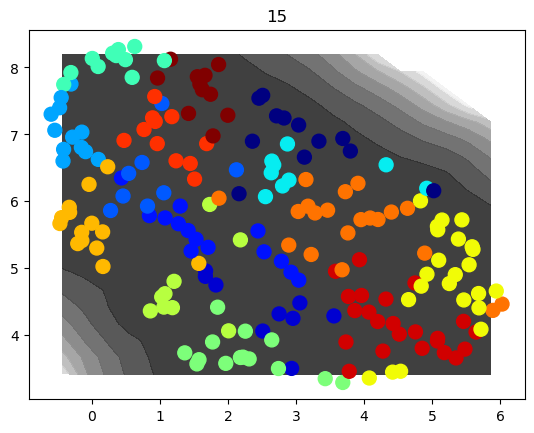

[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.01  0.01  0.02
 0.02  0.02  0.025 0.025 0.03  0.035 0.035 0.04  0.04  0.04  0.05  0.05
 0.055 0.055 0.06  0.06  0.06  0.065 0.07 ]
43 states initial, 14 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.01  0.01  0.01  0.015 0.02
 0.02  0.02  0.025 0.025 0.025 0.03  0.03  0.03  0.03  0.03  0.035 0.035
 0.04  0.045 0.045 0.06  0.07  0.07  0.07  0.085]
44 states initial, 10 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.01  0.01  0.015 0.015 0.015
 0.015 0.015 0.02  0.025 0.025 0.03  0.03  0.03  0.035 0.035 0.035 0.04
 0.04  0.045 0.045 0.05  0.05  0.06  0.065 0.065 0.07 ]
45 states initial, 13 states final
[0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005 0.005
 0.005 0.005 0.005 

KeyboardInterrupt: 

In [59]:
plt.close('all')
plt.clf()
nstateSet=[2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,18,20,22,24,28,30] #,30,40]
nS=len(nstateSet)
scoreSet_states=[None]*nS
nstates_initial=nstateSet[0]
pcut_final=.03
indc_x0set=clusters_minima.assign(x0set);indc_x1set=clusters_minima.assign(x1set)
for istate in range(len(nstateSet)):
    MtSet_test=[None]*nf
    nstates=nstateSet[istate]
    scoreSet=np.zeros(nf)
    #clusters_v = KMeans(n_clusters=nstates,init='k-means++',n_init=1000,max_iter=1000)
    #clusters_v.fit(vkin)
    #states=clusters_v.labels_
    states,nstates_initial=model.get_kineticstates(vkin,nstates,nstates_initial=nstates_initial,pcut_final=pcut_final,seed=0,return_nstates_initial=True,cluster_ninit=100)
    for imf in range(nf):
        print('building likelihood model for '+tmSet[imf])
        indmodels=np.where(inds_tmSet_models==imf)[0]
        indmodels=np.intersect1d(indmodels,indgood_models)
        indstm=np.array([]).astype(int)
        for i in indmodels: #[:-1]:
            indstm=np.append(indstm,np.where(inds_trajsteps_models==i)[0])
        MtSet_test[imf]=model.get_transition_matrix_CG(x0set[indstm,:],x1set[indstm,:],clusters=clusters_minima,states=states)
        scoreSet[imf]=model.get_kscore(MtSet_test[imf])
        #scoreSet[imf]=model.get_path_entropy_2point(states[indc_x0set],states[indc_x1set],MtSet_test[imf])
    print(str(nstates)+' states')
    print(scoreSet)
    nstates_initial=nstates_initial+1
    #np.savetxt(f'{date}_scoreSet_{figid}_nS{nstates}.dat',scoreSet)
    scoreSet_states[istate]=scoreSet
    plt.clf()
    plt.contourf(xx,yy,-np.log(prob1.T),cmap=plt.cm.gray,alpha=0.8)
    plt.scatter(x_clusters[:,0],x_clusters[:,1],s=100,c=states,cmap=plt.cm.jet)
    plt.title(str(nstates))
    plt.pause(2)
    #plt.savefig(f'{date}/clustertest_{figid}_{nstates}.png')

IndexError: list index out of range

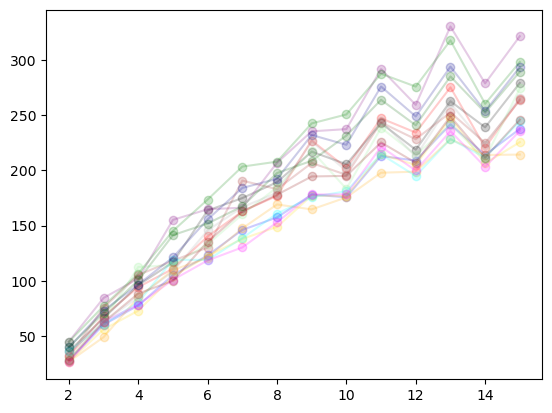

In [60]:
scoreSet_statearray=np.zeros((nS,nf))
for istate in range(len(nstateSet)):
    try:
        scoreSet_statearray[istate,:]=scoreSet_states[istate]
    except:
        pass

plt.close('all')
#colorSet=['red','gold','green','blue','black','red','gold','green','blue','black','brown','orange','purple']
colorSet=['blue','red','gold','black','purple','green','orange','brown','cyan','lightgreen','magenta','darkblue','darkred','darkgray','darkgreen']
plt.clf()
for imf in range(nf):
    plt.plot(nstateSet,scoreSet_statearray[:,imf],'o-',color=colorSet[imf],label=tmSet[imf],alpha=.2)

plt.plot(nstateSet,np.nanmean(scoreSet_statearray,axis=1),'o--',color='black',linewidth=2)
plt.yscale('log')
#plt.ylabel(r'path entropy $-\langle log(p_{ij})\rangle$')
plt.ylabel(r'kinetic score ($\sum_l \tau_l$)')
plt.xlabel('number of states');plt.pause(.1)
plt.savefig(f'{date}/scoreset_{figid}.png')

In [118]:
get_kstates=True
nstates_final=13
#nstates_final=13 #for production
pcut_final=.03 #for prediction
#pcut_final=.02 #for production
nstates_initial=nstates_final
stateCenters=x_clusters
if get_kstates:
    stateSet=model.get_kineticstates(vkin,nstates_final,nstates_initial=nstates_initial,pcut_final=pcut_final,seed=0,return_nstates_initial=False,cluster_ninit=100)
    objFile='stateSet_'+figid+'_nS'+str(nstates_final)+'.obj'
    objFileHandler=open(objFile,'wb')
    states_object=[clusters_minima,stateSet]
    pickle.dump(states_object,objFileHandler,protocol=4)
    objFileHandler.close()
    #stateSet=get_kineticstates(wctm,nstates_final,P=MtSet[4],clusters_minima=clusters_minima,pcut_final=.01,ncomp=ncomp) #treatment specific
else:
    objFile='stateSet_'+figid+'_nS'+str(nstates_final)+'.obj'
    objFileHandler=open(objFile,'rb')
    states_object=pickle.load(objFileHandler)
    clusters_minima=states_object[0]
    stateSet=states_object[1]
    objFileHandler.close()

nstates=np.unique(stateSet).size; n_states=nstates
state_centers_minima=np.zeros((n_states,2))
for i in range(n_states):
    indstate=np.where(stateSet==i)[0]
    state_centers_minima[i,:]=np.median(stateCenters[indstate,:],axis=0)

[0.005 0.005 0.005 0.005 0.01  0.03  0.035 0.08  0.12  0.125 0.14  0.15
 0.29 ]
13 states initial, 7 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.035 0.045 0.05  0.09  0.14  0.165
 0.2   0.235]
14 states initial, 8 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.02  0.02  0.04  0.045 0.06  0.095
 0.145 0.19  0.345]
15 states initial, 7 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.02  0.02  0.03  0.04  0.085 0.095
 0.115 0.13  0.17  0.255]
16 states initial, 7 states final
[0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.015 0.015 0.035 0.055 0.075
 0.12  0.135 0.14  0.165 0.19 ]
17 states initial, 8 states final
[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.03  0.03  0.05  0.08
 0.09  0.105 0.115 0.12  0.155 0.165]
18 states initial, 8 states final
[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.01  0.015 0.035 0.04  0.06
 0.08  0.08  0.09  0.11  0.125 0.125 0.185]
19 states initial, 10 states final
[0.005 0.005 0.005 0.005 0.005 0.01  0.01  0.015 0.015 0.02  0.02  0.03

In [120]:
#state_order=np.argsort(state_centers_minima[:,0])
#state_order=np.arange(nstates).astype(int)
state_order=[11,9,6,5,1,0,2,7,4,3,8,10,12,13]
stateSet_ordered=np.ones_like(stateSet)*-1
for istate in range(nstates):
    stateSet_ordered[stateSet==state_order[istate]]=istate

stateSet=stateSet_ordered

nstates=np.unique(stateSet).size; n_states=nstates
state_centers_minima=np.zeros((n_states,2))
for i in range(n_states):
    indstate=np.where(stateSet==i)[0]
    state_centers_minima[i,:]=np.median(stateCenters[indstate,:],axis=0)

inds_states=[None]*n_states
for i in range(n_states):
    indstate=np.where(stateSet[ind_clusters]==i)[0]
    inds_states[i]=indstate

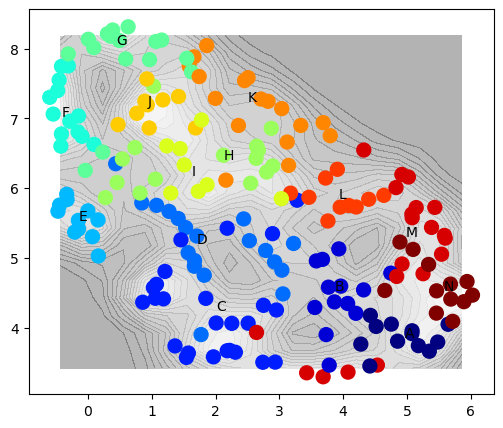

In [121]:
import string
nbins=prob1.shape[0]
state_labels=np.array(list(string.ascii_uppercase))[0:nstates]
plt.close('all');plt.figure(figsize=(6,5))
plt.clf()
pts=np.array([xx.flatten(),yy.flatten()]).T
#indpts=clusters_minima.assign(pts)
#states=stateSet[indpts]
#states=states[prob1.flatten()>np.min(prob1[prob1>0])]
#pts=pts[prob1.flatten()>np.min(prob1[prob1>0]),:]
plt.contourf(xx,yy,prob1.T,cmap=plt.cm.gray,levels=20,alpha=.3)
#plt.scatter(tateSet=model.get_kineticstates(vkin,nstates_final,nstates_initial=nstates_initial,pcut_final=pcut_final,seed=0,return_nstates_initial=False,cluster_ninit=500)ts[:,0],pts[:,1],s=10,c=states,cmap=plt.cm.jet,marker='.',alpha=0.5)
plt.scatter(x_clusters[:,0],x_clusters[:,1],s=100,c=stateSet,cmap=plt.cm.jet)
#for ic in range(n_clusters):
#    ax=plt.gca()
#    ax.arrow(x_clusters[ic,0],x_clusters[ic,1],dxsav[ic,0],dxsav[ic,1],head_width=.1,linewidth=.2,color='white',alpha=1.0)

for istate in range(nstates):
    plt.text(state_centers_minima[istate,0],state_centers_minima[istate,1],str(state_labels[istate]))


plt.savefig(date+'/kineticstates_'+figid+'_nS_'+str(nstates)+'.png')
plt.savefig(date+'/kineticstates_'+figid+'_nS_'+str(nstates)+'.pdf')
plt.pause(.1)

In [122]:
MtSet=[None]*nf
MtSetCG=[None]*nf
for imf in range(nf):
    print('building likelihood model for '+tmSet[imf])
    indmodels=np.where(inds_tmSet_models==imf)[0]
    indmodels=np.intersect1d(indmodels,indgood_models)
    indstm=np.array([]).astype(int)
    for i in indmodels: #[:-1]:
        indstm=np.append(indstm,np.where(inds_trajsteps_models==i)[0])
    MtSet[imf]=model.get_transition_matrix(x0set[indstm,:],x1set[indstm,:],clusters=clusters_minima);
    MtSetCG[imf]=model.get_transition_matrix_CG(x0set[indstm,:],x1set[indstm,:],clusters=clusters_minima,states=stateSet);

building likelihood model for AREG High
building likelihood model for AREG Low
building likelihood model for Control High
building likelihood model for Control Low
building likelihood model for EGFRi High
building likelihood model for EGFRi Low
building likelihood model for Etoposide 0.5 High
building likelihood model for Etoposide 0.5 Low
building likelihood model for Etoposide 5 High
building likelihood model for Etoposide 5 Low
building likelihood model for MCL1i High
building likelihood model for MCL1i Low
building likelihood model for MCL1i+AREG High
building likelihood model for MCL1i+AREG Low
building likelihood model for MCL1i+EGFRi High
building likelihood model for MCL1i+EGFRi Low


In [123]:
nf=len(tmSet)
nwindow=12
maxframe=np.max(sctm.cells_frameSet)
time_inds=np.arange(nwindow,maxframe,nwindow).astype(int)
state_probs_times=np.zeros((nf,n_states,time_inds.size))
ntimes=time_inds.size
for i_tm in range(nf):
    itimes=0
    for itt in time_inds:
        fl=itt-nwindow
        fu=itt+nwindow
        indstw=np.where(np.logical_and(indframes_traj<fu,indframes_traj>fl))[0]
        indstm=inds_conditions[i_tm]
        indstwm=np.intersect1d(indstm,indstw)
        x0=x[indstwm,:]
        indc0=stateSet[clusters_minima.assign(x0)]
        statesc,counts=np.unique(indc0,return_counts=True)
        state_probs_times[i_tm,statesc,itimes]=counts/np.sum(counts)
        itimes=itimes+1



iframe=84
itime=np.argmin(np.abs(time_inds-iframe))
state_probs=state_probs_times[:,:,itime]

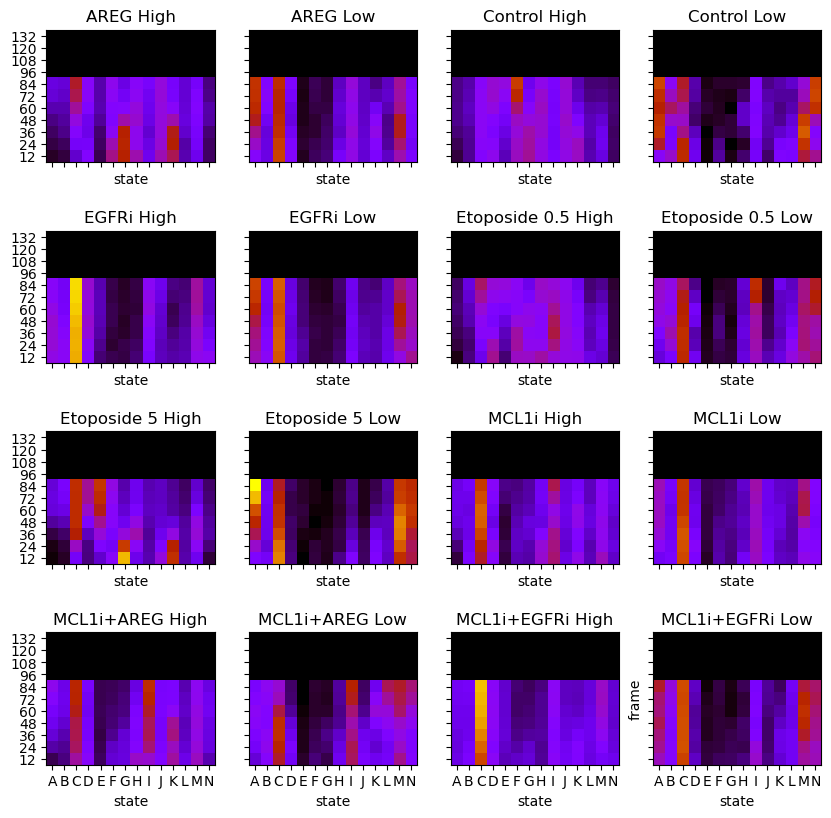

In [124]:
nplots=int(np.ceil(np.sqrt(nf)))
fig,axs=plt.subplots(nplots,nplots,sharex=True,sharey=True,figsize=(10,10))
axs=axs.flatten()
for i_tm in range(nf):
    ax=axs[i_tm]
    ax.imshow(state_probs_times[i_tm,:,:].T,origin='lower',cmap=plt.cm.gnuplot,clim=(np.min(state_probs_times),np.max(state_probs_times)))
    #ax=plt.gca()
    ax.set_yticks(np.arange(time_inds.size))
    ax.set_xticks(np.arange(nstates))
    ax.set_xticklabels(np.array(state_labels))
    ax.set_yticklabels(time_inds)
    ax.set_xlabel('state');plt.ylabel('frame')
    #cbar=plt.colorbar()
    #cbar.set_label('state probabilities')
    ax.set_title(tmSet[i_tm])

plt.savefig(date+f'/stateprobs_times_{figid}_nS{n_states}.png');

[Text(0, 0, 'AREG High'),
 Text(0, 1, 'AREG Low'),
 Text(0, 2, 'Control High'),
 Text(0, 3, 'Control Low'),
 Text(0, 4, 'EGFRi High'),
 Text(0, 5, 'EGFRi Low'),
 Text(0, 6, 'Etoposide 0.5 High'),
 Text(0, 7, 'Etoposide 0.5 Low'),
 Text(0, 8, 'Etoposide 5 High'),
 Text(0, 9, 'Etoposide 5 Low'),
 Text(0, 10, 'MCL1i High'),
 Text(0, 11, 'MCL1i Low'),
 Text(0, 12, 'MCL1i+AREG High'),
 Text(0, 13, 'MCL1i+AREG Low'),
 Text(0, 14, 'MCL1i+EGFRi High'),
 Text(0, 15, 'MCL1i+EGFRi Low')]

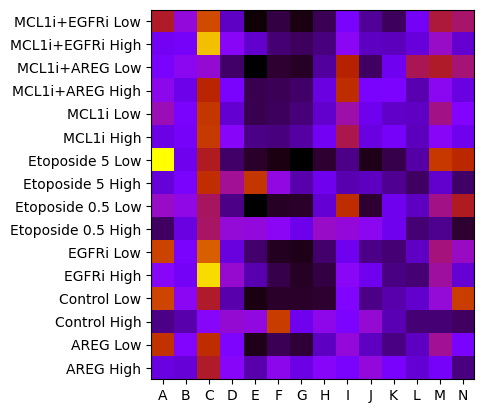

In [126]:
plt.clf()
plt.imshow(state_probs,origin='lower',cmap=plt.cm.gnuplot)
ax=plt.gca()
ax.set_yticks(np.arange(nf))
ax.set_xticks(np.arange(nstates))
ax.set_xticklabels(np.array(state_labels))
ax.set_yticklabels(tmSet)

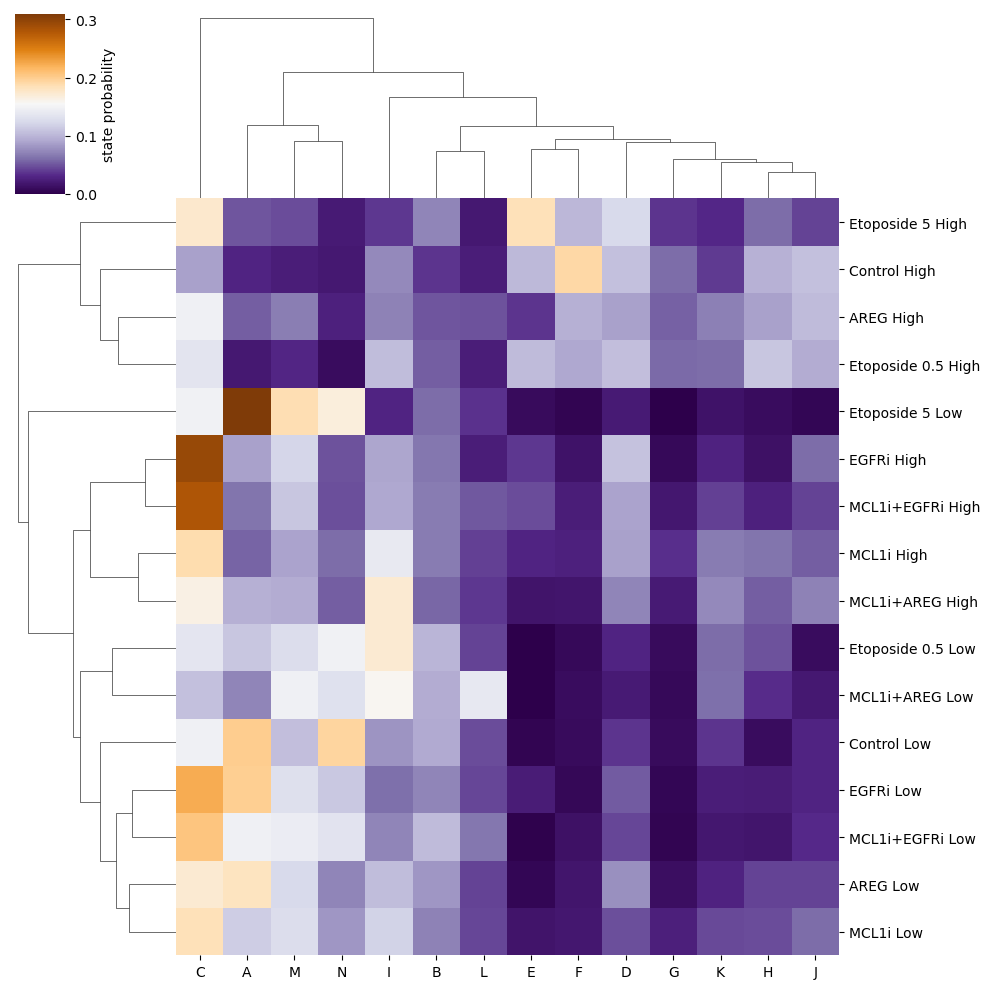

In [127]:
stateprob_df=pandas.DataFrame(data=state_probs,index=tmSet,columns=state_labels)
hmap = sns.clustermap(stateprob_df,cmap="PuOr_r",cbar_kws={'label': 'state probability'})

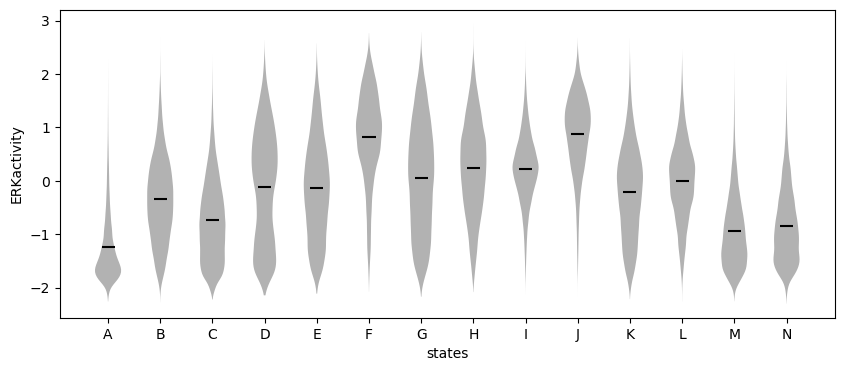

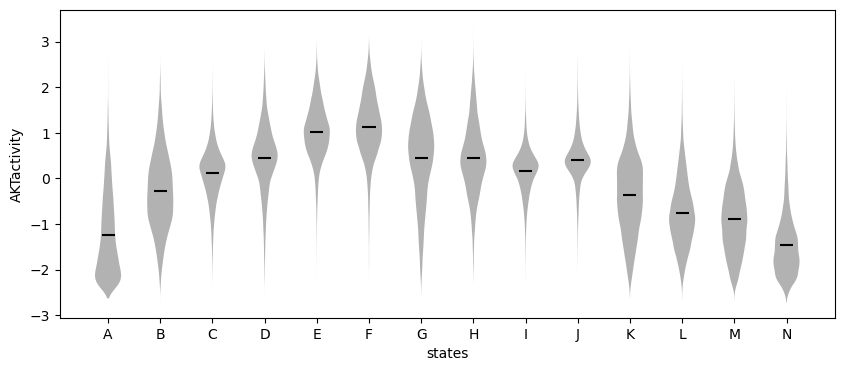

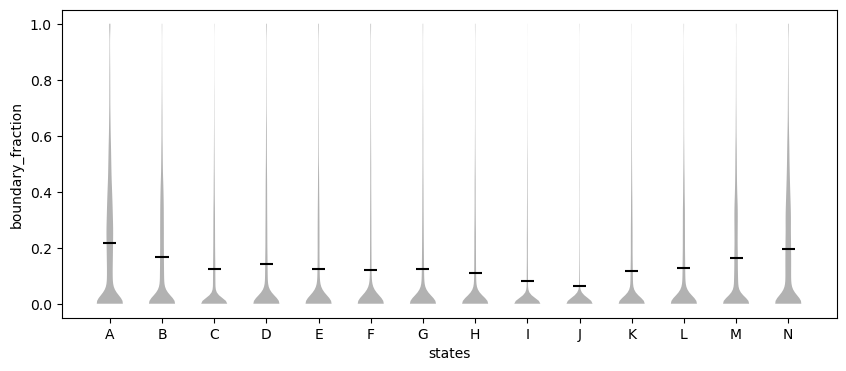

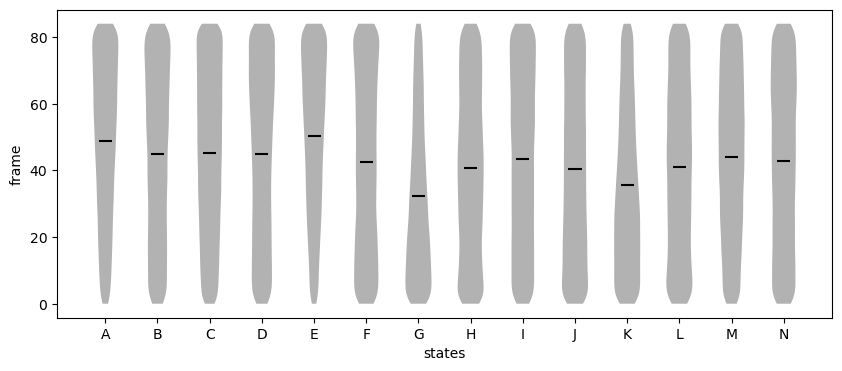

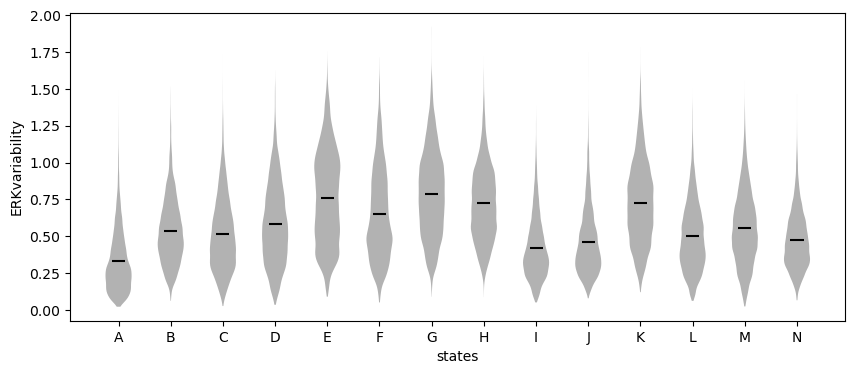

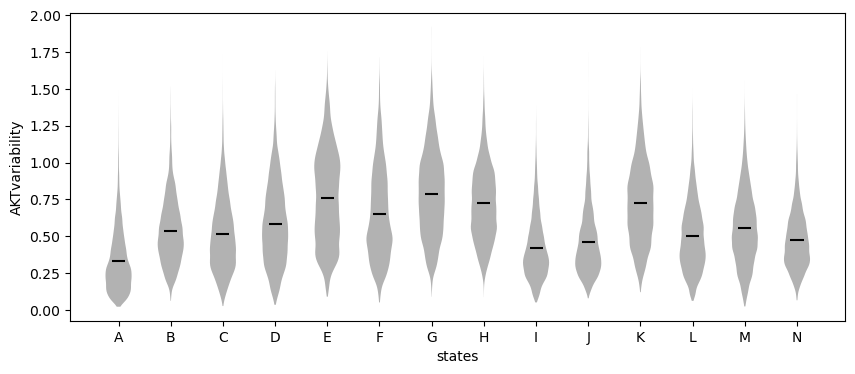

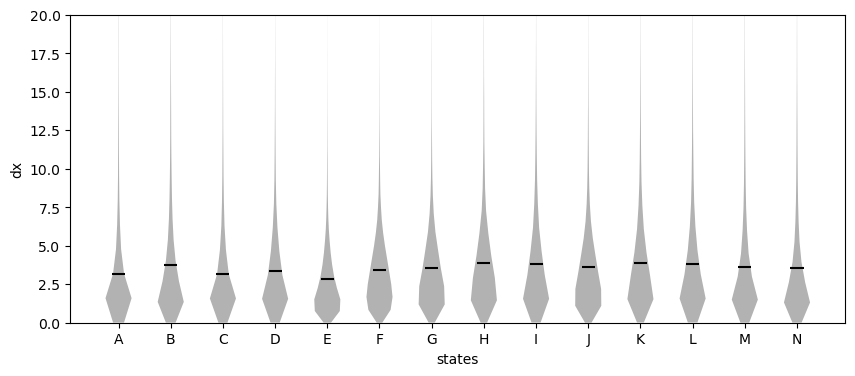

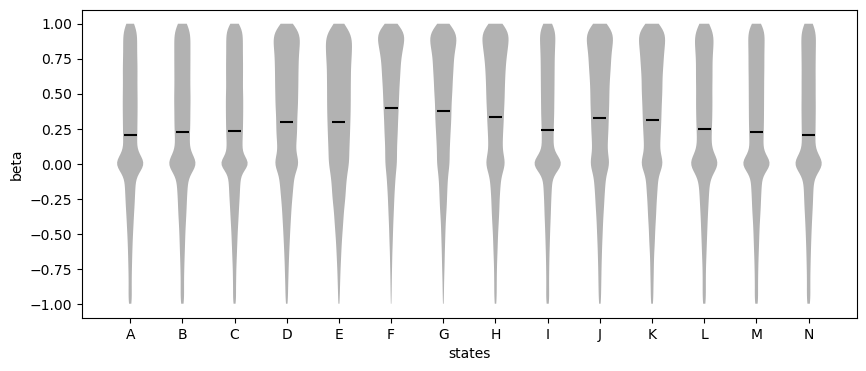

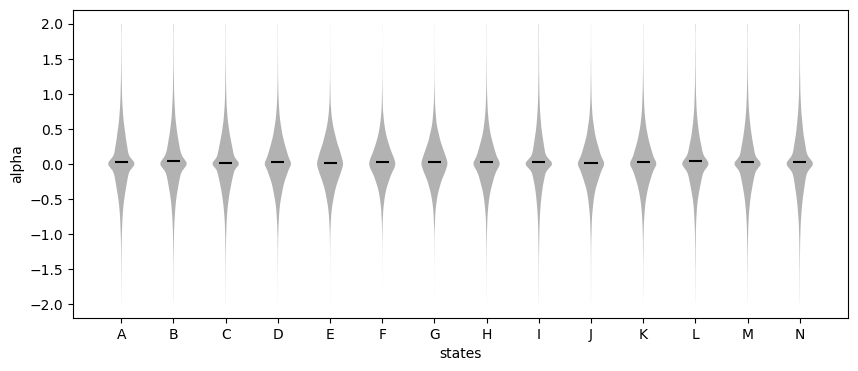

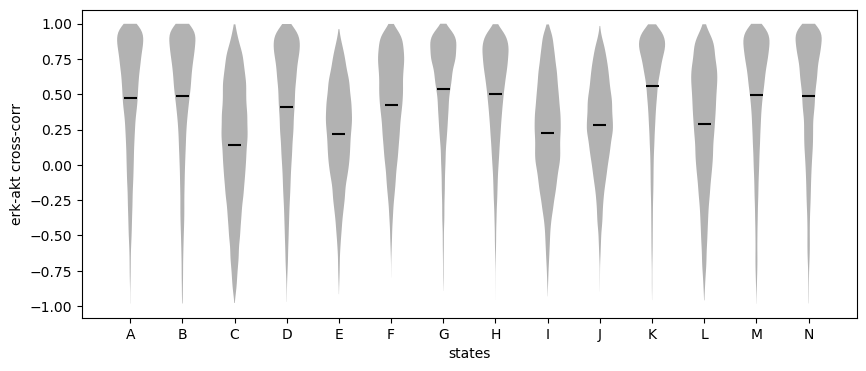

In [128]:
plt.clf()
plt.close('all')
vsetList=[cratio_erk_traj,cratio_akt_traj,cb_ratio_traj,indframes_traj,cratio_erk_var_traj,cratio_erk_var_traj,dx_traj,beta_traj,alpha_traj,erk_akt_crosscorr]
captionset=['ERKactivity','AKTactivity','boundary_fraction','frame','ERKvariability','AKTvariability','dx','beta','alpha','erk-akt cross-corr']
for iv in range(len(vsetList)):
    vset=vsetList[iv]
    plt.figure(figsize=(10,4))
    ax=plt.gca()
    for i in range(n_states):
        setv=vset[inds_states[i]]
        setv=setv[np.isfinite(setv)]
        vplot=ax.violinplot(setv,positions=[i+1],showmeans=True,showextrema=False) #,quantiles=[.05,.95])
        vplot['cmeans'].set_color('black')
        for pc in vplot['bodies']:
            pc.set_facecolor('black')
            #pc.set_edgecolor('black')
            #pc.set_alpha(1)
    ax.set_xticks(range(1,n_states+1))
    ax.set_xticklabels(state_labels)
    #plt.ylabel('log2(nuc/cyto cc-ratio)')
    #plt.ylabel(r'cell-cell local alignment $\langle \hat{v}_1 \cdot \hat{v}_2 \rangle$')
    #plt.ylabel('speed (z-score)')
    #plt.ylabel('nuc/cyt cc-ratio')
    plt.ylabel(captionset[iv])
    plt.xlabel('states')
    if captionset[iv]=='dx':
        plt.ylim(0,20)
    #plt.savefig(date+'/'+captionSet[iv]+'_tearplot_'+figid+'.png')
    plt.savefig(date+'/'+captionset[iv]+'_tearplot_'+figid+'.pdf')
    plt.pause(.5)

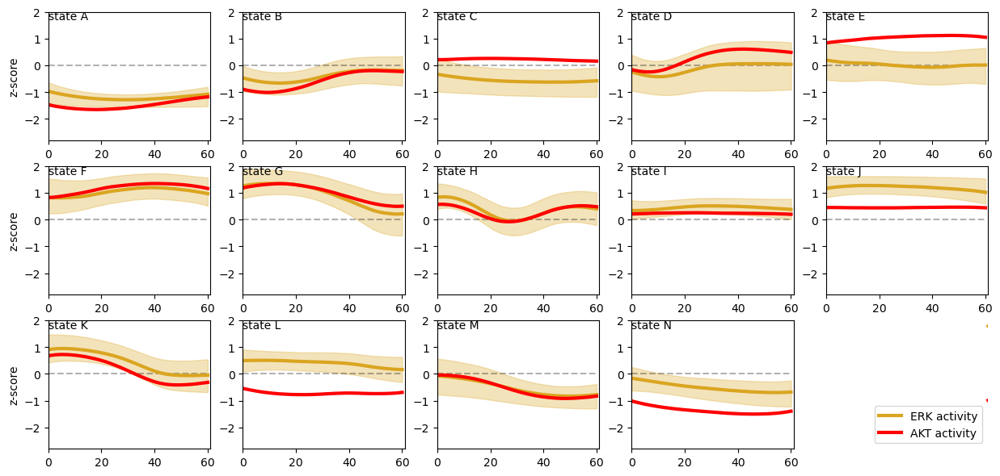

In [134]:
plt.figure(figsize=(15,12))
frames=np.arange(trajl)
cb_ratio_full_traj=imprep.znorm(cb_ratio_full_traj)
erk_traj=imprep.znorm(cratio_erk_full_traj)
akt_traj=imprep.znorm(cratio_akt_full_traj)
dx_full_traj=imprep.znorm(dx_full_traj)
hplots=5;vplots=5;
for istate in range(nstates):
    plt.subplot(vplots,hplots,istate+1)
    ax=plt.gca()
    #plt.plot(frames,np.mean(cb_ratio_full_traj[inds_states[istate],:],axis=0),color='blue',alpha=.25,linewidth=3,label='fraction neighbors')
    #ulim=np.percentile(cb_ratio_full_traj[inds_states[istate],:],75,axis=0)
    #llim=np.percentile(cb_ratio_full_traj[inds_states[istate],:],25,axis=0)
    #ax.fill_between(frames,llim,ulim,color='blue',alpha=.3)
    #plt.plot(frames,np.nanmean(dx_full_traj[inds_states[istate],:],axis=0),color='green',alpha=.25,linewidth=3,label='motility')
    plt.plot(frames,np.zeros_like(frames),'k--',alpha=.3)
    plt.plot(frames,np.mean(erk_traj[inds_states[istate],:],axis=0),color='goldenrod',linewidth=3,label='ERK activity')
    plt.plot(frames,np.mean(akt_traj[inds_states[istate],:],axis=0),color='red',linewidth=3,label='AKT activity')
    ulim=np.percentile(erk_traj[inds_states[istate],:],75,axis=0)
    llim=np.percentile(erk_traj[inds_states[istate],:],25,axis=0)
    ax.fill_between(frames,llim,ulim,color='goldenrod',alpha=.3)
    plt.ylim(-2.8,2);
    plt.xlim(0,trajl)
    plt.text(0,1.7,f'state {state_labels[istate]}')
    if (istate+1)%hplots==1:
        plt.ylabel('z-score')
    if istate+1>(hplots*(hplots-1)):
        plt.xlabel('frame')
    if istate+1==nstates:
        plt.subplot(vplots,hplots,istate+2)
        #plt.plot(frames,np.mean(dx_full_traj[inds_states[istate],:],axis=0),color='green',alpha=.25,linewidth=3,label='motility')
        #plt.plot(frames,np.mean(cb_ratio_full_traj[inds_states[istate],:],axis=0),color='blue',alpha=.25,linewidth=3,label='fraction neighbors')
        plt.plot(frames,np.mean(erk_traj[inds_states[istate],:],axis=0),color='goldenrod',linewidth=3,label='ERK activity')
        plt.plot(frames,np.mean(akt_traj[inds_states[istate],:],axis=0),color='red',linewidth=3,label='AKT activity')
        plt.xlim(-100,0)
        plt.legend(loc='lower right')
        plt.axis('off')

plt.savefig(date+'/signaling_neighbors_'+figid+'.png')
plt.savefig(date+'/signaling_neighbors_'+figid+'.pdf')
plt.pause(.1)

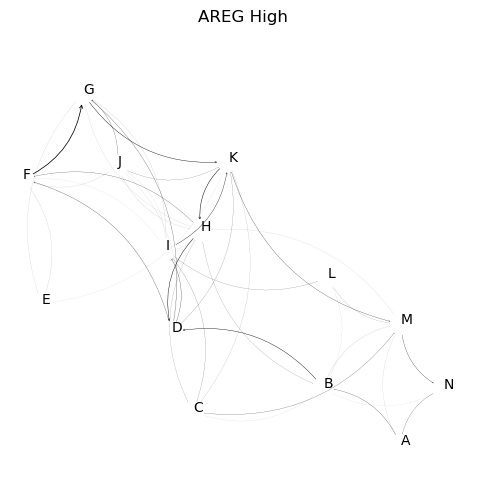

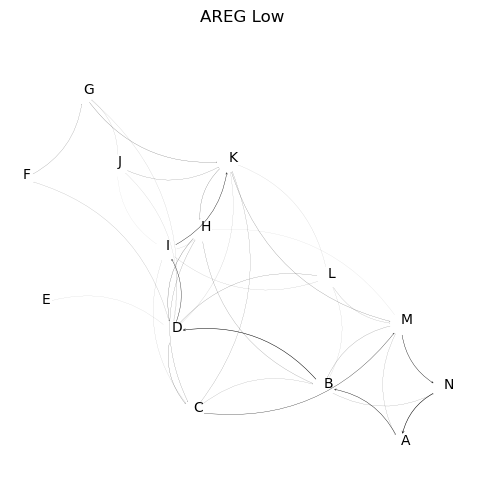

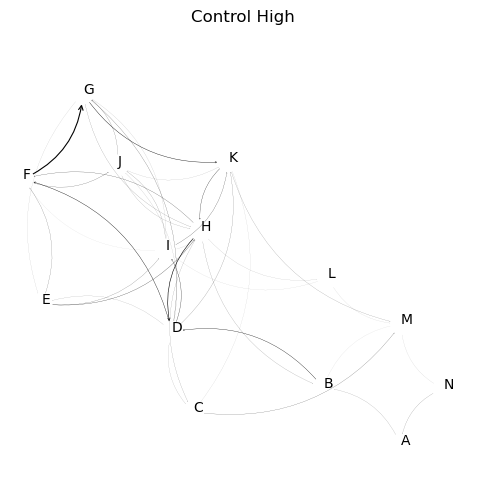

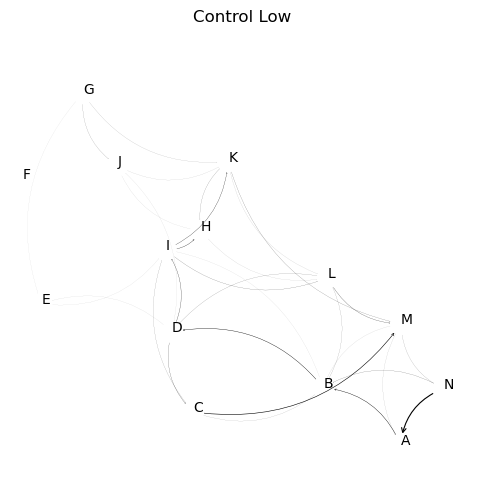

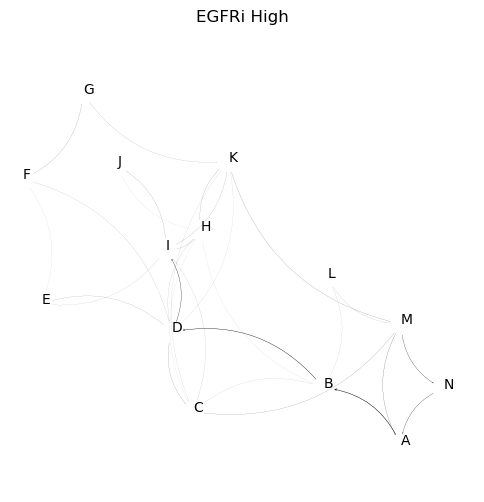

...

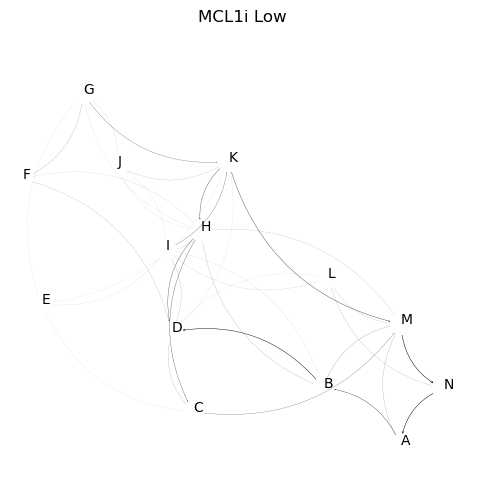

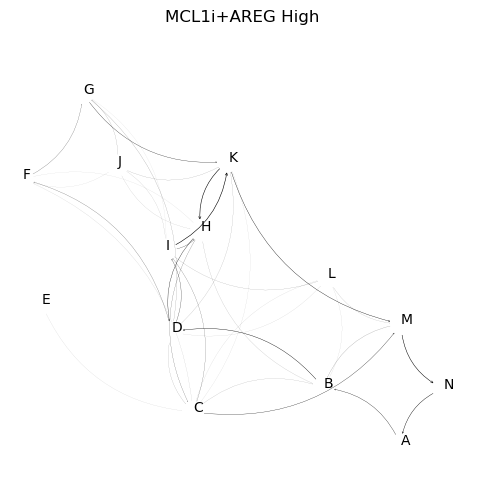

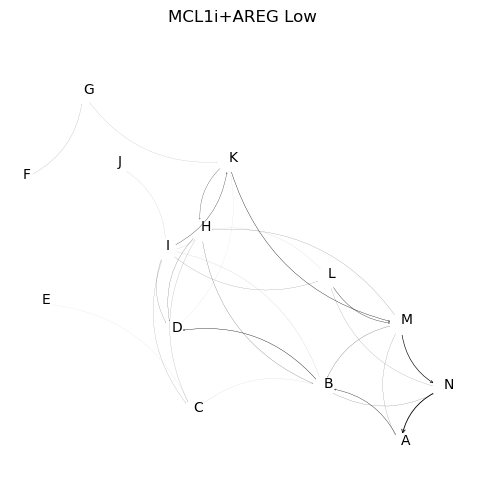

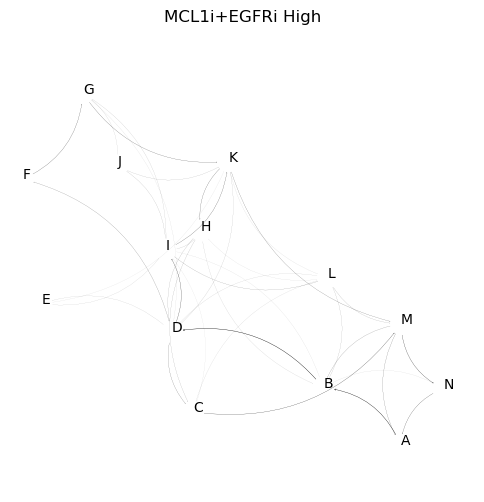

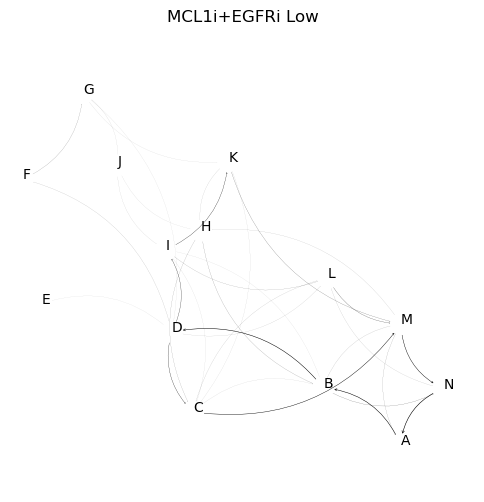

In [130]:
pcut=.001
fcut=.0001
rad=.3
mscale=2200
arrowstyle='->'
lws=200.
sh=8
state_centers=state_centers_minima
fl=0
fu=180
indstw_all=np.where(np.logical_and(indframes_traj<fu,indframes_traj>fl))[0]
xmin=np.min(x_clusters[:,0])
xmax=np.max(x_clusters[:,0])
ymin=np.min(x_clusters[:,1])
ymax=np.max(x_clusters[:,1])
#MtSet=[None]*nf
for i in range(nf):
    plt.figure(figsize=(6,6))
    #plt.subplot(4,4,i+2)
    indmodels=np.where(inds_tmSet_models==i)[0]
    indstm=np.array([]).astype(int)
    for imodel in indmodels:
        indstm=np.append(indstm,np.where(inds_trajsteps_models==imodel)[0].astype(int))
    x0=x0set[indstm,:]
    x1=x1set[indstm,:]
    Mt=model.get_transition_matrix_CG(x0,x1,clusters_minima,stateSet)
    #MtSet[i]=Mt.copy()
    #Mt=MtSet[i]
    ax=plt.gca()
    for j in range(n_states):
        for k in range(n_states):
            fluxjk=state_probs[i,j]*Mt[j,k]
            fluxkj=state_probs[i,k]*Mt[k,j]
            flux=fluxjk-fluxkj
            #flux=fluxjk
            if j<k and flux>fcut and state_probs[i,j]>pcut: #Mt[j,k]>pcut:
                arrow = matplotlib.patches.FancyArrowPatch((state_centers[j,0], state_centers[j,1]), (state_centers[k,0], state_centers[k,1]),shrinkA=sh,shrinkB=sh,mutation_scale=mscale*flux,color='black',arrowstyle=arrowstyle,connectionstyle='arc3,rad='+str(rad),lw=lws*flux,joinstyle='miter',capstyle='butt') #note j and k flipped because drawing arrow at tail
                ax.add_patch(arrow)
            if j>k and flux>fcut and state_probs[i,j]>pcut: #Mt[j,k]>pcut:
                arrow = matplotlib.patches.FancyArrowPatch((state_centers[j,0], state_centers[j,1]), (state_centers[k,0], state_centers[k,1]),shrinkA=sh,shrinkB=sh,mutation_scale=mscale*flux,color='black',arrowstyle=arrowstyle,connectionstyle='arc3,rad='+str(rad),lw=lws*flux,joinstyle='miter',capstyle='butt')
                ax.add_patch(arrow)
        plt.text(state_centers[j,0],state_centers[j,1],state_labels[j],color='black',ma='center')
    plt.xlim(xmin,xmax)
    plt.ylim(ymin,ymax+.5)
    plt.axis('off')
    plt.title(tmSet[i])
    plt.savefig(date+'/networkflux_'+figid+'_nS'+str(nstates)+'_'+tmSet[i]+'.png')
    plt.savefig(date+'/networkflux_'+figid+'_nS'+str(nstates)+'_'+tmSet[i]+'.pdf')
    plt.pause(.1)

/tmp/ipykernel_201779/748654729.py:46: RuntimeWarning: invalid value encountered in divide
  vdist1=np.divide(vdist1,norm1)


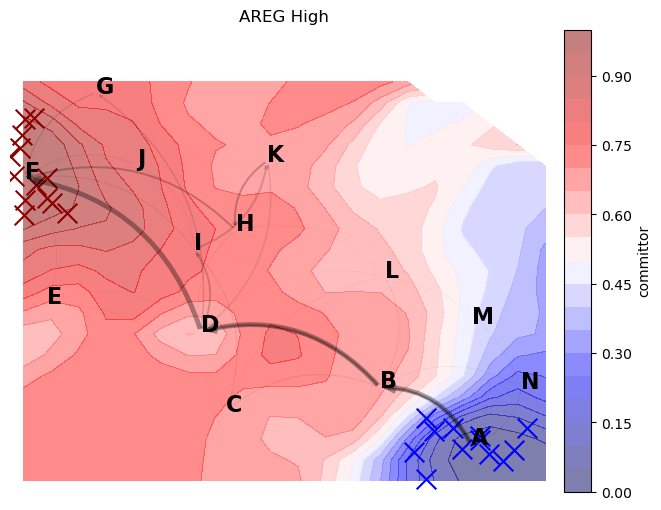

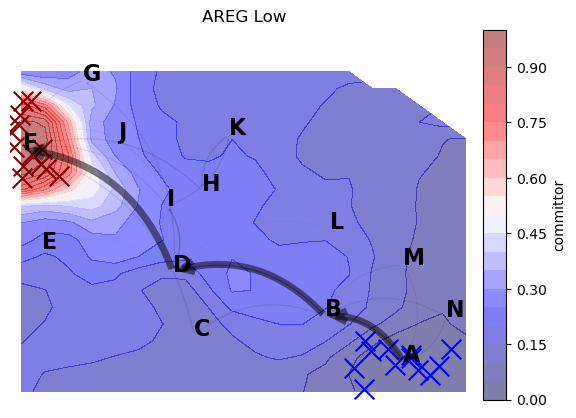

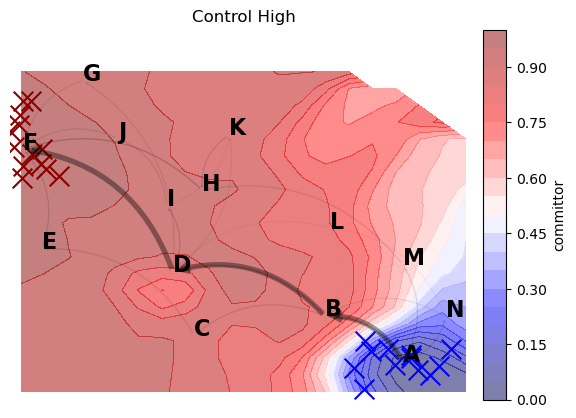

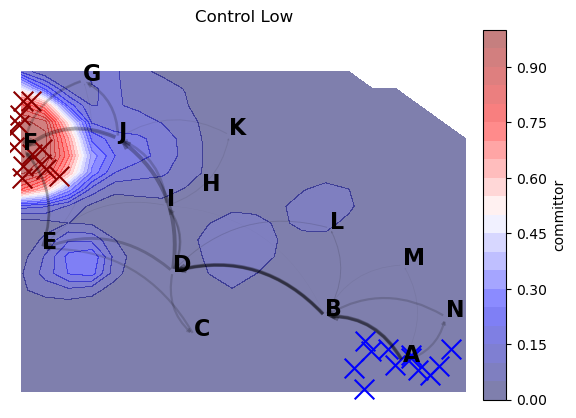

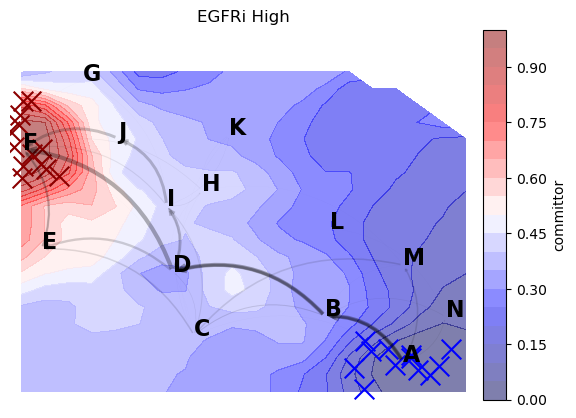

...

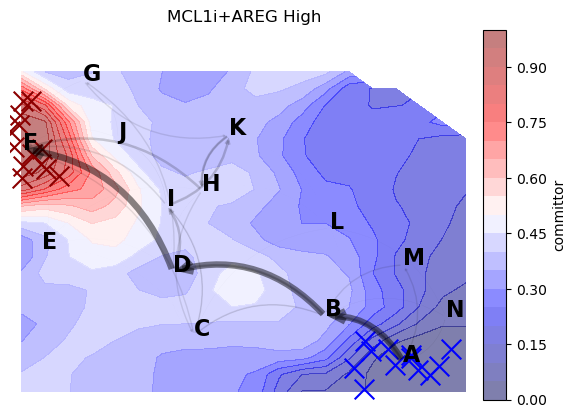

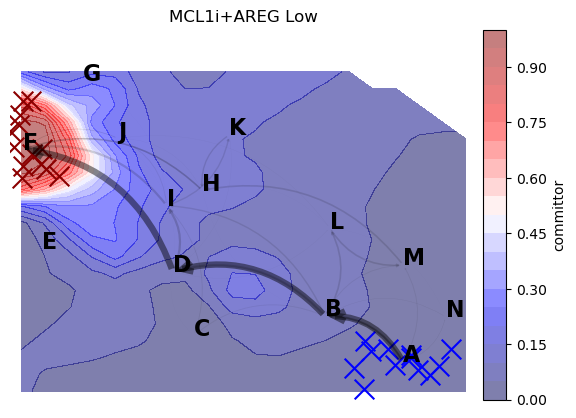

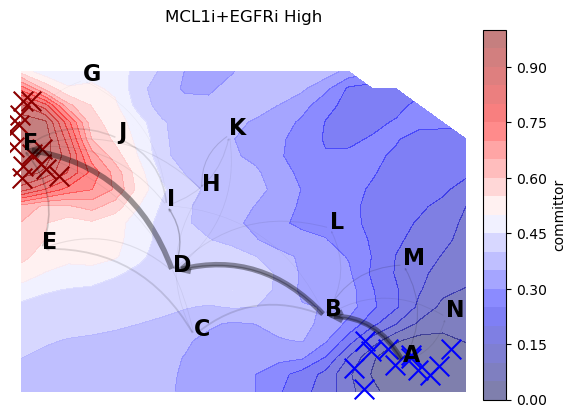

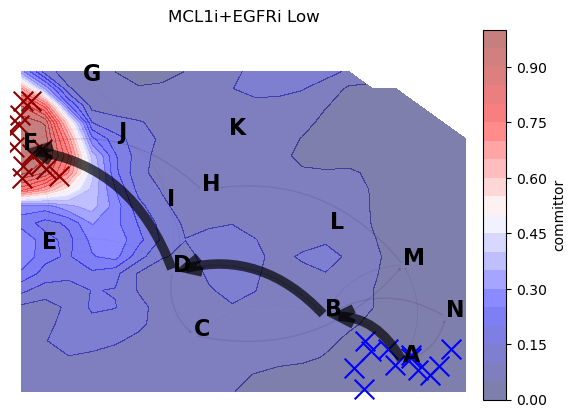

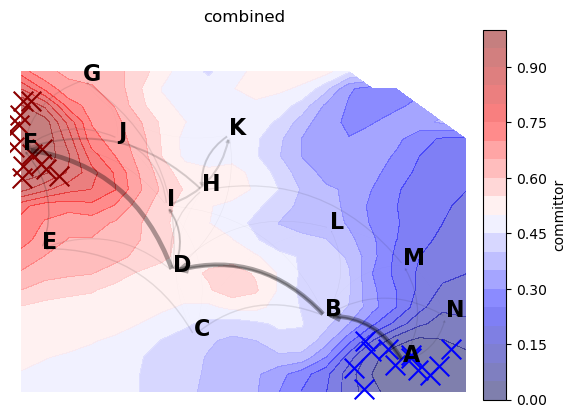

In [131]:
MtCG=model.get_transition_matrix_CG(x0set,x1set,clusters=clusters_minima,states=stateSet);
pcut=.05
fcut=0.
rad=.3
mscale=40.
arrowstyle='->'
lws=10.
sh=2
state_centers=state_centers_minima
commsize=100
xmin=np.min(x_clusters[:,0])
xmax=np.max(x_clusters[:,0])
ymin=np.min(x_clusters[:,1])
ymax=np.max(x_clusters[:,1])
plt.figure(figsize=(7.5,6))
stateA=[0]#,2,3]; 
stateB=[5]
indSource=np.array([]).astype(int)
for isource in stateA:
    inds=np.where(stateSet==isource)[0]
    indSource=np.append(indSource,inds)

indTargets=np.array([]).astype(int)
for itargets in stateB:
    inds=np.where(stateSet==itargets)[0]
    indTargets=np.append(indTargets,inds)

for i in range(nf+1):
    #plt.subplot(4,4,i+2)
    plt.clf()
    if i<nf:
        Tmatrix=MtSet[i]
    else:
        Tmatrix=P
    indNotTargets=np.setdiff1d(range(Tmatrix.shape[0]),indTargets)
    indNotSource=np.setdiff1d(range(Tmatrix.shape[0]),indSource)
    prob=prob1
    levels=np.linspace(np.min(prob[prob>0]),np.max(prob),20)
    #plt.contourf(xx,yy,prob.T,levels=levels,cmap=plt.cm.gray_r,alpha=0.8)
    q=model.get_committor(Tmatrix,indTargets,indSource,conv=1.e-5)
    #plt.scatter(x_clusters[:,0],x_clusters[:,1],s=100,c=q,cmap=plt.cm.gist_heat,marker='o',vmin=0.,vmax=1.)
    vdist1,xedges1,yedges1=np.histogram2d(x_clusters[:,0],x_clusters[:,1],bins=nbins,weights=q.flatten())
    vdist1=scipy.ndimage.gaussian_filter(vdist1,sigma=sml)
    norm1,xedges1,yedges1=np.histogram2d(x_clusters[:,0],x_clusters[:,1],bins=[xedges1,yedges1])
    norm1=scipy.ndimage.gaussian_filter(norm1,sigma=sml)
    vdist1=np.divide(vdist1,norm1)
    indnan=np.where(np.isnan(vdist1))
    indgood=np.where(np.logical_and(np.logical_not(np.isnan(vdist1)),np.logical_not(np.isinf(vdist1))))
    xedges1c=.5*(xedges1[1:]+xedges1[0:-1])
    yedges1c=.5*(yedges1[1:]+yedges1[0:-1])
    xx1,yy1=np.meshgrid(xedges1c,yedges1c)
    levels=np.linspace(0,1,21) #np.min(vdist1[indgood]),np.max(vdist1[indgood]),20)
    cs=plt.contourf(xx,yy,vdist1.T,cmap=plt.cm.seismic,levels=levels,alpha=0.5)
    cbar=utilities.colorbar(cs)
    cbar.set_label('committor')
    plt.scatter(x_clusters[indTargets,0],x_clusters[indTargets,1],s=200,c='darkred',marker='x')
    plt.scatter(x_clusters[indSource,0],x_clusters[indSource,1],s=200,c='blue',marker='x')
    #pts=np.array([xx1.flatten(),yy1.flatten()]).T
    #indpts=clusters_2d.assign(pts)
    #states=stateSet[indpts]
    #plt.contour(xx,yy,states.reshape(nbins,nbins),levels=np.arange(nstates),colors='black')
    try:
        if i<nf:
            TmatrixCG=MtSetCG[i]
        else:
            TmatrixCG=MtCG
        tpt=msmtools.flux.tpt(TmatrixCG,stateA,stateB)
        pathways=tpt.pathways()
        paths=pathways[0]
        capacities=pathways[1]
        ax=plt.gca()
        for ipath in range(-1,-len(paths)-1,-1):
            statepath=paths[ipath]
            colorpath=capacities[ipath]/np.sum(capacities)
            for ipath in range(statepath.size-1):
                j=statepath[ipath]
                k=statepath[ipath+1]
                arrow = matplotlib.patches.FancyArrowPatch((state_centers[j,0], state_centers[j,1]), (state_centers[k,0], state_centers[k,1]),shrinkA=sh,shrinkB=sh,mutation_scale=mscale*colorpath,color='black',arrowstyle=arrowstyle,connectionstyle='arc3,rad='+str(rad),lw=lws*colorpath,joinstyle='miter',capstyle='butt',alpha=colorpath) #note j and k flipped because drawing arrow at tail
                ax.add_patch(arrow)
        for j in range(n_states):
            scolor=tpt.committor[j]+.01
            #plt.scatter(state_centers[j,0],state_centers[j,1],s=commsize,c=plt.cm.gist_heat(scolor),alpha=0.3)
            plt.text(state_centers[j,0],state_centers[j,1],state_labels[j],color='black',weight='bold',fontsize=16,ma='center')
        plt.xlim(xmin,xmax)
        plt.ylim(ymin,ymax+.5)
        plt.axis('off')
        if i<nf:
            plt.title(tmSet[i])
            tstr=tmSet[i]
        else:
            plt.title('combined')
            tstr='combined'
        #plt.savefig(f'{date}/pathways_happytosad_{figid}_{tstr}_nS{nstates}.png')
        #plt.savefig(f'{date}/pathways_happytosad_{figid}_{tstr}_nS{nstates}.pdf')
        plt.pause(5)
    except Exception as e:
        print(e)

q_states=np.zeros(nstates)
for istate in range(nstates):
    indstate=np.where(stateSet==istate)[0]
    q_states[istate]=np.mean(q[indstate,0])

state_order=np.argsort(q_states)

In [395]:
def manual_fate_validation(self,indcells,fate_attr,trajl_future=2,trajl_past=2,restart=True,val_tracks=True,rep_channel=2,bf_channel=0,nuc_channel=1,msk_channel=0,pathto='./',save_pic=False,boundary_expansion=[1,40,40],save_attr=True,save_h5=False,overwrite=False):
    """
    Manually validates cell fate by reviewing images and tracking data for individual cells over time. 
    Provides an interactive validation interface to assess whether cells follow a specific fate or not.

    Parameters
    ----------
    indcells : array-like of int
        Indices of cells to review for fate validation.
    fate_attr : str
        The name of the fate attribute being reviewed and validated.
    trajl_future : int, optional
        Number of future frames to include in the trajectory review (default is 2).
    trajl_past : int, optional
        Number of past frames to include in the trajectory review (default is 2).
    restart : bool, optional
        Whether to restart validation from the beginning (default is True). If False, previously reviewed cells are re-evaluated.
    val_tracks : bool, optional
        If True, validates the cell tracking in addition to fate validation (default is True).
    rep_channel : int, optional
        The channel used for representation images (default is 2).
    bf_channel : int, optional
        The bright-field channel (default is 0).
    nuc_channel : int, optional
        The nucleus channel (default is 1).
    msk_channel : int, optional
        The mask channel used for cell identification (default is 0).
    pathto : str, optional
        The path to save images if `save_pic` is True (default is './').
    save_pic : bool, optional
        Whether to save the images for each validated cell (default is False).
    boundary_expansion : list of int, optional
        The number of pixels to expand the boundary of the cell block in the image (default is [1, 40, 40]).
    save_attr : bool, optional
        Whether to save the validated attributes during the process (default is True).
    save_h5 : bool, optional
        Whether to save the updated attributes to an HDF5 file (default is False).
    overwrite : bool, optional
        Whether to overwrite existing data when saving to HDF5 (default is False).

    Returns
    -------
    vals_fate : ndarray of int
        Validated fate values for each cell. 1 indicates fate, 0 indicates not fate, and -1 indicates unclear or indeterminate fate.
    inds_fate : ndarray of int
        Indices of the cells that were confirmed to follow the fate of interest.

    Notes
    -----
    - This function provides an interactive review interface, where users can manually validate the fate and tracking of cells.
    - It allows users to interactively break cell lineage links if necessary and stores the results of each review session.
    - The images and masks for each cell across its past and future trajectory are visualized for validation.

    Examples
    --------
    >>> vals_fate, inds_fate = model.manual_fate_validation(indcells, 'apoptosis', trajl_future=3, trajl_past=3, save_pic=True, pathto='/output/images')
    >>> print(f'Validated fates for {len(inds_fate)} cells.')
    """
    nc=indcells.size
    setattr(self,f'indreviewed_{fate_attr}',indcells)
    if hasattr(self,f'vals_{fate_attr}') and restart:
        inds_fate=getattr(self,f'inds_{fate_attr}')
        vals_fate=getattr(self,f'vals_{fate_attr}')
        istart=vals_fate.size
        print(f'restarting from {istart} of {indcells.size}')
        if istart==indcells.size:
            print('all indices reviewed, run with restart=False to redo')
            return vals_fate,inds_fate
    else:
        inds_fate=np.array([]).astype(int)
        vals_fate=np.array([]).astype(int)
        istart=0
    cblocks=np.zeros((indcells.size,self.ndim,2)).astype(int)
    cell_trajs=[None]*nc
    for icb in range(nc):
        icell=indcells[icb]
        cblock=self.cellblocks[icell,...].copy()
        if boundary_expansion is not None:
            cblock[:,0]=cblock[:,0]-boundary_expansion
            cblock[:,0][cblock[:,0]<0]=0
            cblock[:,1]=cblock[:,1]+boundary_expansion
            indreplace=np.where(cblock[:,1]>self.image_shape)[0]
            cblock[:,1][indreplace]=self.image_shape[indreplace]
        cblocks[icb,...]=cblock
        cell_trajs[icb]=self.get_cell_trajectory(icell)
    for iic in range(istart,nc):
        cell_traj=cell_trajs[iic]
        ic=indcells[iic]
        icells_tree=np.array([ic])
        n_frame=self.cells_indimgSet[ic]
        img=self.get_image_data(n_frame)
        msk=self.get_mask_data(n_frame)
        cblock=cblocks[iic,...]
        imgc_test,mskc_relabeled=self.get_cell_data(ic,boundary_expansion=boundary_expansion,relabel_mskchannels=[msk_channel]) #get first cell image
        if self.ndim==3:
            imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
            mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
            imgc=np.flip(imgc,axis=0);mskc=np.flip(mskc,axis=0);mskc_relabeled=np.flip(mskc_relabeled,axis=0);
        if self.ndim==2:
            imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            mskc_relabeled=mskc_relabeled[np.newaxis,...]
        imgs=[None]*(trajl_past+trajl_future+1)
        msks=[None]*(trajl_past+trajl_future+1)
        imgs[0]=imgc
        msks[0]=mskc
        nzset=[imgs[0].shape[0]]
        #print(f'setting {0}')
        for ipast in range(1,trajl_past+1):
            img=self.get_image_data(n_frame-trajl_past+ipast)
            msk=self.get_mask_data(n_frame-trajl_past+ipast)
            cblock=cblocks[iic,...]
            if self.ndim==3:
                imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
                mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
                imgc=np.flip(imgc,axis=0);mskc=np.flip(mskc,axis=0);
            if self.ndim==2:
                imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
                mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            imgs[ipast]=imgc
            if cell_traj.size>(trajl_past+1-ipast):
                icell_global_past=cell_traj[-trajl_past-1+ipast]
                icell_local_past=self.cells_labelidSet[icell_global_past]
            else:
                icell_local_past=np.inf
            msks[ipast]=mskc==icell_local_past
            #print(f'setting {ipast}')
            #print(np.unique(msks[ipast]))
            nzset.append(imgs[ipast].shape[0])
        for ifuture in range(1,trajl_future+1):
            icells_future=np.array([]).astype(int)
            for ic_tree in icells_tree:
                inds_children=get_cell_children(self,ic_tree)
                icells_future=np.append(icells_future,inds_children)
            #print(icells_future)
            icells_tree=icells_future.copy()
            icells_future_local=self.cells_labelidSet[icells_future]
            img=self.get_image_data(n_frame+ifuture)
            msk=self.get_mask_data(n_frame+ifuture)
            cblock=cblocks[iic,...]
            if self.ndim==3:
                imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
                mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
                imgc=np.flip(imgc,axis=0);mskc=np.flip(mskc,axis=0);
            if self.ndim==2:
                imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
                mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            imgs[ifuture+trajl_past]=imgc
            mskc[np.logical_not(np.isin(mskc,icells_future_local))]=0
            msks[ifuture+trajl_past]=mskc
            nzset.append(imgs[ifuture+trajl_past].shape[0])
            #print(f'setting {ifuture+trajl_past}')
        nzmax=np.max(nzset)
        if nzmax<3:
            nz_plots=3
        else:
            nz_plots=nzmax
        vertsize=2*nz_plots
        ny_plots=trajl_future+trajl_past+1
        hsize=3*ny_plots
        #fig=plt.figure(figsize=(12,vertsize))
        fig,ax=plt.subplots(nz_plots,ny_plots,figsize=(hsize,vertsize))
        for iz in range(nz_plots):
            for iy in range(ny_plots):
                ax[iz,iy].axis('off')
        image_order=np.arange(1,trajl_past+1).tolist()+[0]+np.arange(trajl_past+1,trajl_past+trajl_future+1).tolist()
        colors=['darkred']*(trajl_past)+['red']+['darkred']*(trajl_future)
        alphas=[0.1]*(trajl_past)+[1.]+[.5]*(trajl_future)
        colors_all=['red']*(trajl_past)+['black']+['blue']*(trajl_future)
        alphas_all=[1.]*(trajl_past)+[.33]+[1.]*(trajl_future)
        for iy in range(len(image_order)):
            il=image_order[iy]
            print(f'trajl: {len(imgs)} il: {il}')
            nz=imgs[il].shape[0]
            for iz in range(nz):
                img_rep=imprep.znorm(imgs[il][iz,:,:,rep_channel])
                img_bf=imprep.znorm(imgs[il][iz,:,:,bf_channel])
                img_nuc=imprep.znorm(imgs[il][iz,:,:,nuc_channel])
                msk_cyto=mskc_relabeled[iz,:,:,msk_channel]==ic
                msk_all=msks[il][iz,:,:,msk_channel]
                ax[iz,iy].imshow(img_bf,cmap=plt.cm.binary,clim=(-3,3))
                if np.percentile(img_nuc,99)>1:
                    cs=ax[iz,iy].contour(img_nuc,cmap=plt.cm.BuPu,levels=np.linspace(1,np.percentile(img_nuc,99),4),alpha=.2)
                    cs.cmap.set_over('purple')
                #if np.percentile(img_rep,99)>1:
                    #cs=ax[iz,il].contour(img_rep,cmap=plt.cm.YlOrBr_r,levels=np.linspace(1,np.percentile(img_rep,99),4),alpha=.2)
                    #cs.cmap.set_over('yellow')
                ax[iz,iy].contour(msk_all,levels=np.unique(msk_all),colors=colors_all[iy],alpha=alphas_all[iy],linewidths=.8)
                ax[iz,iy].contour(msk_cyto,colors=colors[iy],alpha=alphas[iy])
                #ax[iz,il].contour(msk_all,levels=np.unique(msk_all),colors='blue')#,alpha=.33)
                ax[iz,iy].axis('off')
                ax[iz,iy].set_title('cell '+str(iic)+' of '+str(nc))
            #plt.pause(.5)
            titlestr='fate validation: '
        imgfile=f'{pathto}/{fate_attr}_cell{iic}.png'
        if save_pic:
            plt.savefig(imgfile)
        plt.show()
        inpstatus=True
        while inpstatus:
            if val_tracks:
                vtrack = input("track validation (1 all good, -2 to break past link, 2 to break future link, 0 to break both):\n")
                try:
                    vtrack=int(vtrack)
                    inpstatus=False
                except:
                    print('invalid input')
                if vtrack!=1:
                    iS=self.cells_indimgSet[ic]
                    if vtrack==-2 or vtrack==0:
                        print(f'breaking past linkage for cell {ic}')
                        self.linSet[iS][self.cells_indSet[ic]]=-1
                    if vtrack==2 or vtrack==0:
                        icells_children=get_cell_children(self,ic)
                        for ic_child in icells_children:
                            msk0=np.max(mskc_relabeled[...,msk_channel],axis=0)
                            msk1=np.max(msks[trajl_past+1][...,msk_channel],axis=0)                                
                            fig1=plt.figure()
                            plt.contour(msk0,colors='black')
                            plt.contour(msk1,levels=np.unique(msk1),colors='blue',alpha=.5)
                            plt.contour(msk1==self.cells_labelidSet[ic_child],colors='red')
                            plt.show()
                            vbreak = input("break the linkage to the red cell? (y or n)\n")
                            if vbreak=='y':
                                print(f'breaking future linkage to cell {ic_child}')
                                self.linSet[iS+1][self.cells_indSet[ic_child]]=-1
                            plt.close(fig1)
            vfate = input("fate validation (q to quit, -1 can't tell, 0 not fate, 1 is fate):\n")
            if vfate=='q':
                if save_h5:
                    attribute_list=[f'inds_{fate_attr}',f'vals_{fate_attr}',f'indreviewed_{fate_attr}']
                    self.save_to_h5(f'/cell_data_m{self.mskchannel}/',attribute_list,overwrite=overwrite)
                    if val_tracks:
                        attribute_list=['linSet']
                        self.save_to_h5(f'/cell_data_m{self.mskchannel}/',attribute_list,overwrite=overwrite)
                return vals_fate,inds_fate
            try:
                vfate=int(vfate)
                inpstatus=False
            except:
                print('invalid input')
        vals_fate=np.append(vals_fate,vfate)
        if vfate==1:
            inds_fate=np.append(inds_fate,ic)
        titlestr=titlestr+' '+str(vfate)
        clear_output(wait=True)
        if save_attr:
            setattr(self,f'inds_{fate_attr}',inds_fate)
            setattr(self,f'vals_{fate_attr}',vals_fate)
    if save_h5:
        attribute_list=[f'inds_{fate_attr}',f'vals_{fate_attr}',f'indreviewed_{fate_attr}']
        self.save_to_h5(f'/cell_data_m{self.mskchannel}/',attribute_list,overwrite=overwrite)
        if val_tracks:
            attribute_list=['linSet']
            self.save_to_h5(f'/cell_data_m{self.mskchannel}/',attribute_list,overwrite=overwrite)
    return vals_fate,inds_fate

In [497]:
import importlib; importlib.reload(trajectory)
sctm_test=trajectory.Trajectory(h5filename=modelList[16],data_list=['/cell_data_m0'])
sctm_test.mskchannel=0

loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5
interpreting image as xyc
loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5:/cell_data_m0


In [478]:
modelSet[16].h5filename

'/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5'

[17537 17536 17535 ...   485   470   469]
[ 60  67  71  77  80  82  87  88  88  90  96  96  97  98 112 120 134 136]
setting 0
setting 1
[False  True]
setting 2
[False  True]
setting 3
setting 4


mkdir: cannot create directory ‘./29aug24/death_val_m12/’: File exists


trajl: 5 il: 1
trajl: 5 il: 2
trajl: 5 il: 0
trajl: 5 il: 3
trajl: 5 il: 4


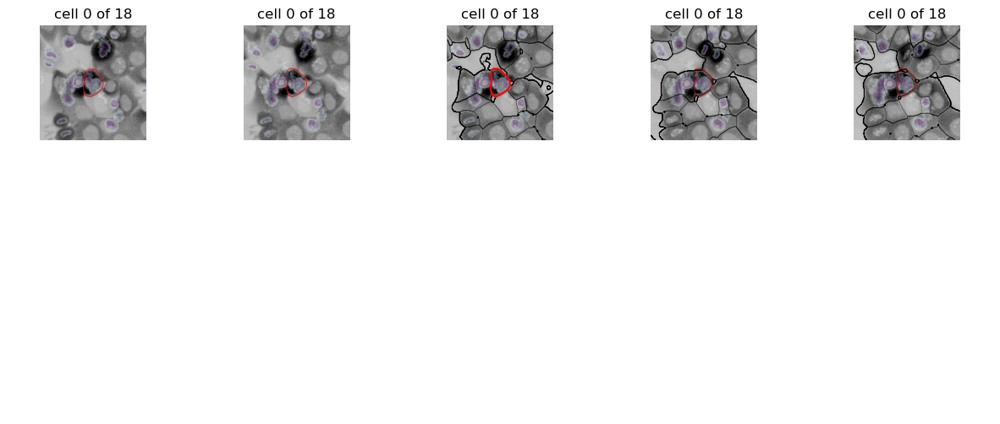

fate validation (q to quit, -1 can't tell, 0 not fate, 1 is fate):
 q


ValueError: not enough values to unpack (expected 2, got 0)

In [286]:
trajl_future=2
trajl_past=2
fu=np.max(sctm.cells_frameSet-trajl_future)
fl=trajl_past
i_tm=np.where(np.array(tmSet)=='Control High')[0][0]
indmodels=np.where(inds_tmSet_models==i_tm)[0]
indmodels=np.intersect1d(indmodels,indgood_models)
x_clusters_maybedeath=np.zeros((0,2)).astype(int)
vals_death_set=[None]*indmodels.size
inds_death_set=[None]*indmodels.size
for iimodel in range(indmodels.size):
    imodel=indmodels[iimodel]
    sctm_fate=modelSet[imodel]
    inds_last=np.array([]).astype(int)
    inds_xtraj=np.where(indtreatment_traj==imodel)[0]
    for itraj in range(len(sctm_fate.trajectories)):
        ic_last=sctm_fate.trajectories[itraj][-1]
        if sctm_fate.cells_frameSet[ic_last] != np.max(sctm_fate.cells_frameSet):
            inds_last=np.append(inds_last,ic_last)
    indstw=np.where(np.logical_and(sctm_fate.cells_frameSet[inds_last]<fu,sctm_fate.cells_frameSet[inds_last]>fl))[0]
    inds_last=inds_last[indstw]
    print(inds_last)
    inds_last_model,inds_common_xtraj,inds_common_last=np.intersect1d(cellinds1_traj[inds_xtraj],inds_last,return_indices=True)
    inds_last=inds_last[inds_common_last]
    print(sctm_fate.cells_frameSet[inds_last])
    deathval_dir=f'./{date}/death_val_m{imodel}/'
    os.system(f'mkdir {deathval_dir}')
    vals_death_set[iimodel],inds_death_set[iimodel]=manual_fate_validation(sctm,inds_last,trajl_past=trajl_past,trajl_future=trajl_future,rep_channel=erk_img_channel,bf_channel=erk_img_channel,nuc_channel=nuc_img_channel,msk_channel=cyto_msk_channel,pathto=deathval_dir,save_pic=True,boundary_expansion=[70,70])
    inds_common_xtraj=inds_common_xtraj[np.where(vals_death_set[iimodel]==1)[0]]
    x_clusters_maybedeath=np.append(x_clusters_maybedeath,x_clusters_all[inds_xtraj[inds_common_xtraj],:],axis=0)    

plt.scatter(x_clusters_maybedeath[:,0],x_clusters_maybedeath[:,1],s=20,color='black',marker='.',alpha=.4)

In [487]:
imodel=16
cells_nchildren=sctm_test.get_cells_nchildren()

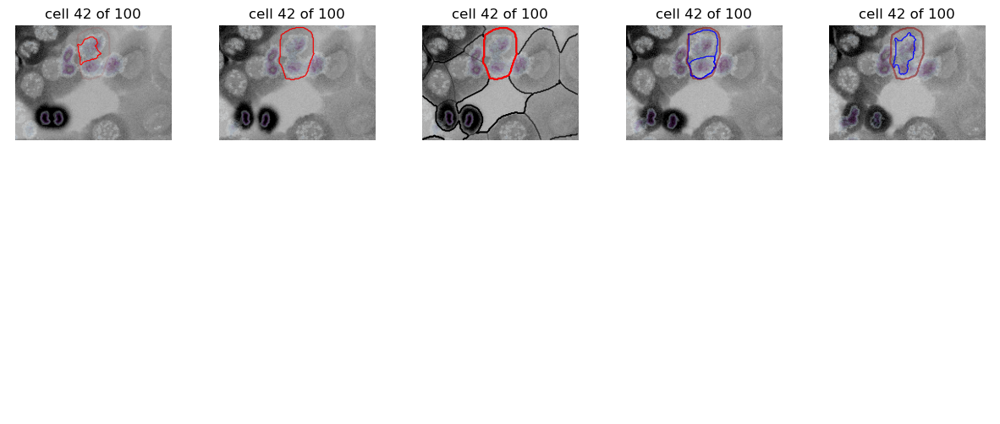

track validation (1 all good, -2 to break past link, 2 to break future link, 0 to break both):
 2


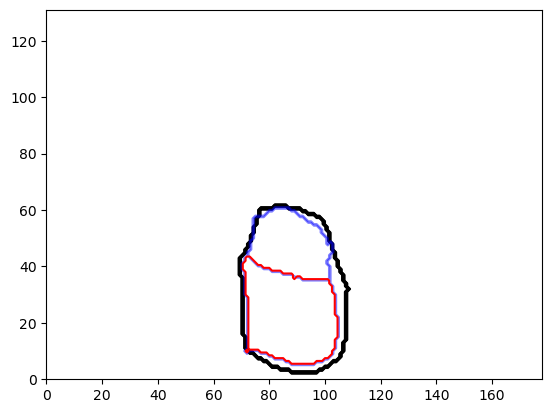

break the linkage to the red cell? (y or n)
 n


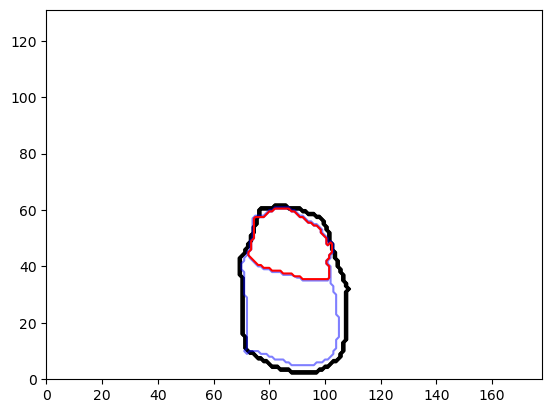

break the linkage to the red cell? (y or n)
 y


breaking future linkage to cell 18014


fate validation (q to quit, -1 can't tell, 0 not fate, 1 is fate):
 q


saving attributes ['inds_division', 'vals_division', 'indreviewed_division'] to /cell_data_m0/ in /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5
overwrote existing and saved inds_division to /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5//cell_data_m0/
overwrote existing and saved vals_division to /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5//cell_data_m0/
overwrote existing and saved indreviewed_division to /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5//cell_data_m0/
saving attributes ['linSet'] to /cell_data_m0/ in /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5
setting an array element with a sequence. The requested array has an inhomogeneous shap

In [498]:
inds_parents=np.where(cells_nchildren>1)[0]
div_val_dir=f'./{date}/div_val_m{imodel}'
os.system(f'mkdir {div_val_dir}')
vals_div_set,inds_div_set=sctm_test.manual_fate_validation(inds_parents[1000:1100],'division',restart=True,trajl_past=trajl_past,trajl_future=trajl_future,rep_channel=erk_img_channel,bf_channel=erk_img_channel,nuc_channel=nuc_img_channel,msk_channel=cyto_msk_channel,pathto=div_val_dir,save_pic=True,boundary_expansion=[70,70],save_h5=True,overwrite=True)

In [468]:
def get_cell_sandwich(self,ic,msk_channel=0,boundary_expansion=None,trajl_past=1,trajl_future=1):
    """
    Extracts a sequence of image and mask "sandwiches" for a given cell, including past and future frames.

    This function creates a set of 2D or 3D image and mask stacks for a specified cell, tracking the cell 
    across multiple frames into the past and future. It includes boundary expansion around the cell if specified 
    and gathers the images and masks for the cell trajectory. The function is useful for analyzing the temporal 
    behavior of a cell within its local neighborhood.

    Parameters
    ----------
    ic : int
        Index of the target cell.
    msk_channel : int, optional
        Channel of the mask image where the cell is identified (default is 0).
    boundary_expansion : int or None, optional
        Number of pixels to expand the boundary around the cell block (default is None, no expansion).
    trajl_past : int, optional
        Number of past frames to include in the sandwich (default is 1).
    trajl_future : int, optional
        Number of future frames to include in the sandwich (default is 1).

    Returns
    -------
    imgs : list of ndarray
        A list of image stacks (2D or 3D) for each frame in the trajectory sandwich.
    msks : list of ndarray
        A list of binary masks corresponding to the same frames in `imgs`, where the cell and its descendants 
        are highlighted.

    Notes
    -----
    - The function retrieves the cell trajectory from the current frame, including both past and future cells, 
      as well as their children in future frames.
    - The images and masks are collected and returned in two separate lists, with the past, present, and future 
      frames in sequential order.
    - The function supports both 2D and 3D image data based on the dimensions of the input data.

    Examples
    --------
    >>> imgs, msks = model.get_cell_sandwich(ic=42, boundary_expansion=10, trajl_past=2, trajl_future=2)
    >>> print(f'Retrieved {len(imgs)} images and masks for cell 42 across past and future frames.')
    """
    cblock=self.cellblocks[ic,...].copy()
    if boundary_expansion is not None:
        cblock[:,0]=cblock[:,0]-boundary_expansion
        cblock[:,0][cblock[:,0]<0]=0
        cblock[:,1]=cblock[:,1]+boundary_expansion
        indreplace=np.where(cblock[:,1]>self.image_shape)[0]
        cblock[:,1][indreplace]=self.image_shape[indreplace]
    cell_traj=self.get_cell_trajectory(ic)
    icells_tree=np.array([ic])
    n_frame=self.cells_indimgSet[ic]
    img=self.get_image_data(n_frame)
    msk=self.get_mask_data(n_frame)
    if self.ndim==3:
        imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
        mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
    if self.ndim==2:
        imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
        mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
    imgs=[None]*(trajl_past+trajl_future+1)
    msks=[None]*(trajl_past+trajl_future+1)
    imgs[0]=imgc
    msks[0]=mskc==self.cells_labelidSet[ic]
    for ipast in range(1,trajl_past+1):
        img=self.get_image_data(n_frame-trajl_past+ipast-1)
        msk=self.get_mask_data(n_frame-trajl_past+ipast-1)
        if self.ndim==3:
            imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
            mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
        if self.ndim==2:
            imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
        imgs[ipast]=imgc
        if cell_traj.size>(trajl_past+1-ipast):
            icell_global_past=cell_traj[-trajl_past-1+ipast-1]
            icell_local_past=self.cells_labelidSet[icell_global_past]
        else:
            icell_local_past=np.inf
        msks[ipast]=mskc==icell_local_past
        print([icell_global_past,ic])
    for ifuture in range(1,trajl_future+1):
        icells_future=np.array([]).astype(int)
        for ic_tree in icells_tree:
            inds_children=get_cell_children(self,ic_tree)
            icells_future=np.append(icells_future,inds_children)
        #print(icells_future)
        icells_tree=icells_future.copy()
        icells_future_local=self.cells_labelidSet[icells_future]
        img=self.get_image_data(n_frame+ifuture)
        msk=self.get_mask_data(n_frame+ifuture)
        if self.ndim==3:
            imgc=img[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
            mskc=msk[cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],cblock[2,0]:cblock[2,1],...]
        if self.ndim==2:
            imgc=img[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
            mskc=msk[np.newaxis,cblock[0,0]:cblock[0,1],cblock[1,0]:cblock[1,1],...]
        imgs[ifuture+trajl_past]=imgc
        msks[ifuture+trajl_past]=np.isin(mskc,icells_future_local)
    return imgs,msks

[41419, 42000]


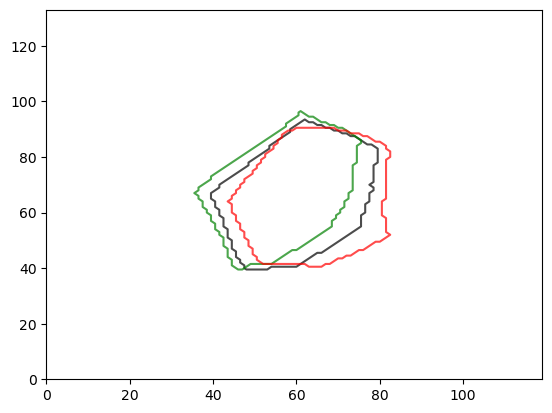

In [473]:
imgs,msks=get_cell_sandwich(sctm,42000,msk_channel=0,boundary_expansion=[40,40],trajl_past=1,trajl_future=1)
plt.contour(msks[0][0,...,0],colors='black',alpha=.7)
plt.contour(msks[1][0,...,0],colors='green',alpha=.7)
plt.contour(msks[2][0,...,0],colors='red',alpha=.7)

In [472]:
len(msks)

3

In [413]:
np.unique(msks[2])

array([0, 6], dtype=int16)

In [406]:
imgs,msks=get_cell_sandwich(sctm,10000)

In [212]:
trajl_future=2
trajl_past=2
fu=np.max(sctm.cells_frameSet-trajl_future)
fl=trajl_past
i_tm=np.where(np.array(tmSet)=='Control High')[0][0]
indmodels=np.where(inds_tmSet_models==i_tm)[0]
indmodels=np.intersect1d(indmodels,indgood_models)
x_clusters_maybedivision=np.zeros((0,2)).astype(int)
vals_division_set=[None]*indmodels.size
inds_division_set=[None]*indmodels.size
for iimodel in range(indmodels.size):
    imodel=indmodels[iimodel]
    sctm_fate=modelSet[imodel]
    inds_last=np.array([]).astype(int)
    inds_xtraj=np.where(indtreatment_traj==imodel)[0]
    for itraj in range(len(sctm_fate.trajectories)):
        ic_last=sctm_fate.trajectories[itraj][-1]
        if sctm_fate.cells_frameSet[ic_last] != np.max(sctm_fate.cells_frameSet):
            inds_last=np.append(inds_last,ic_last)
    indstw=np.where(np.logical_and(sctm_fate.cells_frameSet[inds_last]<fu,sctm_fate.cells_frameSet[inds_last]>fl))[0]
    inds_last=inds_last[indstw]
    print(inds_last)
    inds_last_model,inds_common_xtraj,inds_common_last=np.intersect1d(cellinds1_traj[inds_xtraj],inds_last,return_indices=True)
    inds_last=inds_last[inds_common_last]
    print(sctm_fate.cells_frameSet[inds_last])
    deathval_dir=f'./{date}/death_val_m{imodel}/'
    os.system(f'mkdir {deathval_dir}')
    vals_death_set[iimodel],inds_death_set[iimodel]=manual_fate_validation(sctm,inds_last,trajl_past=trajl_past,trajl_future=trajl_future,rep_channel=erk_img_channel,bf_channel=erk_img_channel,nuc_channel=nuc_img_channel,msk_channel=cyto_msk_channel,pathto=deathval_dir,save_pic=True,boundary_expansion=[70,70])
    inds_common_xtraj=inds_common_xtraj[np.where(vals_death_set[iimodel]==1)[0]]
    x_clusters_maybedeath=np.append(x_clusters_maybedeath,x_clusters_all[inds_xtraj[inds_common_xtraj],:],axis=0)    

plt.scatter(x_clusters_maybedeath[:,0],x_clusters_maybedeath[:,1],s=20,color='black',marker='.',alpha=.4)

In [804]:
import importlib;importlib.reload(trajectory)

<module 'trajectory' from '/home/groups/ZuckermanLab/copperma/cell/celltraj/celltraj/trajectory.py'>

In [306]:
def get_cells_nchildren(self):
    """
    Compute the number of children for each cell across all frames.

    This function calculates the number of child cells each parent cell has across consecutive time frames. 
    The result is an array where each element corresponds to the number of child cells for a given parent 
    cell in the next frame. Cells with no children will have a count of 0.

    Returns
    -------
    cells_nchildren : ndarray
        An array where each element represents the number of child cells for each cell 
        in the dataset. The indices correspond to the cell indices in `self.cells_indSet`.

    Notes
    -----
    - The function iterates through all time frames (`nt`) to determine the lineage of each cell 
      using the `linSet` attribute, which holds the lineage information between frames.
    - Cells that are not tracked between frames (i.e., not assigned a child in the next frame) 
      will have a count of 0 children.
    - The method assumes that `linSet`, `cells_indSet`, and `cells_indimgSet` are properly initialized 
      and populated.

    Examples
    --------
    >>> cell_children_counts = model.get_cells_nchildren()
    >>> print(f'Number of children for each cell: {cell_children_counts}')
    """
    cells_nchildren=np.zeros(self.cells_indSet.size).astype(int)
    for iS in range(1,self.nt):
        indt1=np.where(self.cells_indimgSet==iS)[0]
        indt0=np.where(self.cells_indimgSet==iS-1)[0]
        lin1=linSet[iS].copy()
        inds_tracked,counts_tracked=np.unique(lin1,return_counts=True)
        if inds_tracked[0]==-1:
            inds_tracked=inds_tracked[1:]
            counts_tracked=counts_tracked[1:]
        cells_nchildren[indt0[inds_tracked]]=counts_tracked
    return cells_nchildren

In [314]:
def get_cell_children(self,icell):
    """
    Get the child cells for a given cell in the next frame.

    This function identifies the child cells of a given parent cell `icell` by tracking the lineage data 
    across consecutive frames. The lineage is determined from the parent cell's index and the lineage set 
    for the next frame.

    Parameters
    ----------
    icell : int
        The index of the cell for which to find the children.

    Returns
    -------
    ind_children : ndarray
        An array of indices representing the child cells of the given cell `icell` in the next frame.

    Notes
    -----
    - The function looks at the current frame of `icell` and identifies its child cells in the subsequent frame
      using the lineage tracking set (`linSet`).
    - This method assumes that the lineage set (`linSet`) and cell indexing (`cells_indimgSet`, `cells_indSet`) 
      are properly initialized and populated.

    Examples
    --------
    >>> cell_index = 10
    >>> children = model.get_cell_children(cell_index)
    >>> print(f'Children of cell {cell_index}: {children}')
    """
    iS=self.cells_indimgSet[icell]
    icell_frame=self.cells_indSet[icell]
    indt1=np.where(self.cells_indimgSet==iS+1)[0]
    lin1=self.linSet[iS+1]
    ind_children_frame=np.where(lin1==icell_frame)[0]
    ind_children=indt1[ind_children_frame]
    return ind_children

In [316]:
i1=np.where(cells_nchildren==2)[0][0]
get_cell_children(sctm,i1)

array([688, 689])

In [819]:
sctm.cells_indSet.shape

(85915,)

In [243]:
sctm=trajectory.Trajectory(h5filename=modelSet[16].h5filename,data_list=['cell_data_m0'])
sctm.mskchannel=0
sctm.get_frames()
sctm.get_cell_index(verbose=True,save_h5=True,overwrite=True)
ntrans=[1,1,1]
maxt=[0.,0.,0.]
tf_matrix_set=sctm.get_stack_trans(mskchannel=sctm.mskchannel,ntrans=ntrans,maxt=maxt,dist_function=utilities.get_pairwise_distance_sum,save_h5=True,overwrite=True,do_global=False) #,contact_transform=True,r0=100.,d0=100.,n=6,m=12)
clear_output(wait=True)
x=sctm.get_cell_positions(mskchannel=sctm.mskchannel,save_h5=True,overwrite=True)
clear_output(wait=True)
tf_matrix_set_pad,pad_dims=imprep.get_registration_expansions(sctm.tf_matrix_set,sctm.nx,sctm.ny)

loading cells from frame 0
loading cells from frame 1
loading cells from frame 2
loading cells from frame 3
loading cells from frame 4
loading cells from frame 5
loading cells from frame 6
loading cells from frame 7
loading cells from frame 8
loading cells from frame 9
loading cells from frame 10
loading cells from frame 11
loading cells from frame 12
loading cells from frame 13
loading cells from frame 14
loading cells from frame 15
loading cells from frame 16
loading cells from frame 17
loading cells from frame 18
loading cells from frame 19
loading cells from frame 20
loading cells from frame 21
loading cells from frame 22
loading cells from frame 23
loading cells from frame 24
loading cells from frame 25
loading cells from frame 26
loading cells from frame 27
loading cells from frame 28
loading cells from frame 29
loading cells from frame 30
loading cells from frame 31
loading cells from frame 32
loading cells from frame 33
loading cells from frame 34
loading cells from frame 35
lo

In [1010]:
import scipy.sparse as sp
from scipy.sparse.csgraph import connected_components

def construct_sparse_trajectory_matrix(self):
    """
    Construct a sparse adjacency matrix for cell linkages across frames, excluding untracked cells.

    Parameters
    ----------
    linSet : list of numpy arrays
        A list where each entry is an array of local indices corresponding to linkages between frames.
        linSet[i] contains the linkages from frame i to frame i-1.

    Returns
    -------
    sparse_matrix : scipy.sparse.csr_matrix
        A sparse adjacency matrix where an entry at (i, j) indicates a linkage from global cell i to global cell j.
    """
    if not hasattr(self,'linSet'):
        print('run tracking first, need lineage information in linSet')
        return 1
        
    n_frames = len(linSet)  # The total number of frames
    n_cells_total = self.ncells_total

    # Row and column indices for the sparse matrix
    rows = []
    cols = []

    # Iterate over the frames and construct linkages between cells in adjacent frames
    for frame in range(1, n_frames):  # Start from frame 1 (frame 0 has no incoming links)
        current_frame_cells = np.where(self.cells_frameSet == frame)[0]
        previous_frame_cells = np.where(self.cells_frameSet == frame - 1)[0]

        for local_idx, global_idx in enumerate(current_frame_cells):
            linked_indices = linSet[frame][local_idx]  # Get linkages to the previous frame
            
            # Skip untracked cells (marked as -1)
            if linked_indices == -1:
                continue

            global_idx_previous = previous_frame_cells[linked_indices]  # Convert to global index of the previous frame
            
            # Add the connections to the sparse matrix (row -> current, col -> previous)
            rows.append(global_idx)
            cols.append(global_idx_previous)

    # Flatten the lists
    rows = np.array(rows)
    cols = np.array(cols)

    # Construct a sparse adjacency matrix
    data = np.ones(len(rows))
    sparse_matrix = sp.csr_matrix((data, (rows, cols)), shape=(n_cells_total, n_cells_total))

    return sparse_matrix

def extract_trajectories_from_graph(sparse_matrix):
    """
    Extract unique trajectories by first finding connected components, then processing each component
    to separate branches by tracing from endpoints backwards.

    Optimized to avoid modifying the sparse matrix and recalculating degrees repeatedly.

    Parameters
    ----------
    sparse_matrix : scipy.sparse.csr_matrix
        The sparse adjacency matrix representing the cell linkages.

    Returns
    -------
    trajectories : list of numpy arrays
        A list where each entry is a numpy array of global indices, representing a unique trajectory.
    """

    # Step 1: Find connected components in the graph
    n_components, labels = connected_components(sparse_matrix, directed=False)

    # Step 2: Initialize a list to hold all unique trajectories
    trajectories = []

    # Step 3: Process each connected component
    for component in range(n_components):
        if component%100==0:
            print(f'extracting trajectories from {component} of {n_components} connected components')
        # Get the global indices for cells in this component
        component_indices = np.where(labels == component)[0]

        # Create a subgraph for the current component
        subgraph = sparse_matrix[component_indices, :][:, component_indices]

        # Precompute in-degrees and out-degrees for the subgraph
        out_degrees = subgraph.sum(axis=1).A1  # Number of outgoing links per cell
        in_degrees = subgraph.sum(axis=0).A1  # Number of incoming links per cell

        # Step 4: Find endpoints (cells with no outgoing edges)
        endpoints = component_indices[out_degrees == 0]

        # Step 5: Keep track of visited cells and backtracked cells
        visited = np.zeros_like(component_indices, dtype=bool)
        backtracked = np.zeros_like(component_indices, dtype=bool)

        # Step 6: Trace back each trajectory starting from endpoints
        for endpoint in endpoints:
            if visited[np.where(component_indices == endpoint)[0]]:
                continue  # Skip if already visited

            trajectory = []
            current_cell = endpoint

            # Trace backwards until no more incoming links or a visited cell is found
            while current_cell is not None:
                trajectory.append(current_cell)
                backtracked[np.where(component_indices == current_cell)[0]] = True

                # Find the incoming cell
                incoming_links = subgraph[np.where(component_indices == current_cell)[0],:].nonzero()[0]
                if len(incoming_links) == 0 or visited[incoming_links[0]]:
                    break  # Stop if no more incoming links or already visited (but mark common point)
                current_cell = component_indices[incoming_links[0]]

            # Reverse the trajectory so it goes from earliest to latest frame
            trajectory.reverse()

            # Convert to numpy array and store the trajectory
            trajectories.append(np.array(trajectory, dtype=int))

            # After tracing the branch, mark all cells as visited only after the trajectory is complete
            for cell in trajectory:
                visited[np.where(component_indices == cell)[0]] = True

    return trajectories


def get_unique_trajectories(self):
    """
    Main function to construct the sparse matrix and extract unique trajectories.

    Parameters
    ----------
    linSet : list of numpy arrays
        List where each entry is a numpy array containing linkages for each frame.
    n_frames : int
        Number of frames in the dataset.
    n_cells_per_frame : int
        Number of cells per frame.

    Returns
    -------
    trajectories : list of lists
        A list of all unique trajectories across frames.
    """
    # Step 1: Construct the sparse matrix
    sparse_matrix = construct_sparse_trajectory_matrix(self)

    # Step 2: Extract the unique trajectories from the sparse matrix graph
    trajectories = extract_trajectories_from_graph(self,sparse_matrix)

    return trajectories

In [1002]:
component_indices = np.where(labels == 1)[0]
#print(component_indices)
subgraph = sparse_matrix[component_indices, :][:, component_indices]
subgraph.todense()

matrix([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0

In [1008]:
incoming_links = subgraph[np.where(component_indices == 686)[0],:].nonzero()[0]

In [1009]:
incoming_links

array([0], dtype=int32)

In [1011]:
traj_matrix=construct_sparse_trajectory_matrix(sctm_test)

In [1012]:
trajectories=extract_trajectories_from_graph(traj_matrix)

extracting trajectories from 0 of 2514 connected components
extracting trajectories from 100 of 2514 connected components
extracting trajectories from 200 of 2514 connected components
extracting trajectories from 300 of 2514 connected components
extracting trajectories from 400 of 2514 connected components
extracting trajectories from 500 of 2514 connected components
extracting trajectories from 600 of 2514 connected components
extracting trajectories from 700 of 2514 connected components
extracting trajectories from 800 of 2514 connected components
extracting trajectories from 900 of 2514 connected components
extracting trajectories from 1000 of 2514 connected components
extracting trajectories from 1100 of 2514 connected components
extracting trajectories from 1200 of 2514 connected components
extracting trajectories from 1300 of 2514 connected components
extracting trajectories from 1400 of 2514 connected components
extracting trajectories from 1500 of 2514 connected components
extr

In [980]:
len(sctm_test.trajectories)

6629

In [1013]:
len(trajectories)

2514

In [1016]:
trajectories[1000]

array([14127])

In [827]:
trajectories_graph = get_unique_trajectories(sctm)

In [960]:
sctm_test.get_unique_trajectories()

tracked cell 610, 33 tracks, 100 left
tracked cell 27, 1 tracks, 0 left


In [950]:
sys.path.insert(0,'/mnt/c/Users/copperma/OneDrive/Documents/cell/celltraj/celltraj')
import importlib;importlib.reload(trajectory)

<module 'trajectory' from '/mnt/c/Users/copperma/OneDrive/Documents/cell/celltraj/celltraj/trajectory.py'>

In [961]:
sctm_test=trajectory.Trajectory(h5filename=modelSet[16].h5filename,data_list=['cell_data_m0'])
sctm_test.mskchannel=0

loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5
interpreting image as xyc
loading /home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy16.h5:cell_data_m0


In [962]:
sctm_test.get_unique_trajectories(save_h5=True,overwrite=True)

tracked cell 85823, 79 tracks, 79900 left
tracked cell 85729, 31 tracks, 72400 left
tracked cell 85707, 135 tracks, 70200 left
tracked cell 85645, 133 tracks, 64000 left
tracked cell 85571, 104 tracks, 57100 left
tracked cell 85549, 119 tracks, 55500 left
tracked cell 82921, 1 tracks, 39700 left
tracked cell 81825, 1 tracks, 39300 left
tracked cell 80066, 1 tracks, 38100 left
tracked cell 79572, 1 tracks, 38000 left
tracked cell 78310, 2 tracks, 37800 left
tracked cell 77510, 1 tracks, 37300 left
tracked cell 76638, 18 tracks, 36500 left
tracked cell 75630, 1 tracks, 35900 left
tracked cell 73154, 2 tracks, 34500 left
tracked cell 72300, 122 tracks, 34000 left
tracked cell 72057, 14 tracks, 33900 left
tracked cell 71411, 1 tracks, 33600 left
tracked cell 68549, 10 tracks, 32100 left
tracked cell 68028, 1 tracks, 31900 left
tracked cell 67340, 3 tracks, 31200 left
tracked cell 66962, 3 tracks, 31100 left
tracked cell 64987, 4 tracks, 29900 left
tracked cell 64500, 1 tracks, 29500 left
t

In [817]:
start=time.time()
sctm_test.get_unique_trajectories(cell_inds=np.arange(10000,20000).astype(int))
end=time.time()
print(f'elapsed time {end-start:.3f} seconds')

tracked cell 19975, 9 tracks, 9600 left
tracked cell 19937, 32 tracks, 9100 left
tracked cell 19664, 31 tracks, 5500 left
tracked cell 19611, 31 tracks, 4800 left
tracked cell 19587, 31 tracks, 4500 left
tracked cell 19484, 31 tracks, 3200 left
tracked cell 19436, 31 tracks, 2500 left
tracked cell 18136, 2 tracks, 1500 left
tracked cell 15958, 1 tracks, 1000 left
tracked cell 15040, 1 tracks, 800 left
tracked cell 14566, 9 tracks, 700 left
tracked cell 14069, 1 tracks, 600 left
tracked cell 12946, 1 tracks, 400 left
tracked cell 11772, 1 tracks, 200 left
tracked cell 10025, 1 tracks, 0 left
elapsed time 3.484 seconds


In [956]:
sctm_test.trajectories

[array([  15,   36,   55,   73,   90,  107,  125,  144,  162,  183,  201,
         219,  239,  257,  274,  295,  314,  336,  355,  375,  394,  413,
         432,  456,  473,  492,  509,  527,  547,  566,  584,  602,  623,
         644,  662,  679,  696,  714,  731,  749,  770,  789,  806,  826,
         848,  866,  886,  905,  923,  941,  960,  977,  997, 1015, 1033,
        1050, 1064, 1080, 1096, 1113, 1130, 1146, 1163, 1183, 1203, 1223,
        1242, 1259, 1277, 1295, 1311, 1329, 1348, 1366, 1383, 1398, 1415,
        1431, 1448, 1464, 1480, 1498, 1514, 1529, 1546, 1562, 1579, 1595,
        1611, 1630, 1645, 1662, 1679, 1697, 1717, 1734, 1752, 1770, 1789,
        1806, 1824, 1841, 1859, 1878, 1896, 1914, 1932, 1951, 1970, 1990,
        2009, 2027, 2046, 2067, 2088, 2109, 2130, 2149, 2166, 2184, 2204,
        2224, 2247, 2265, 2287, 2307, 2326, 2345, 2364, 2383, 2408, 2427,
        2445, 2463, 2482, 2502, 2522, 2543, 2563, 2584, 2606, 2626, 2647,
        2667, 2686]),
 array([1430, 14

In [816]:
start=time.time()
sctm_test.get_unique_trajectories2(cell_inds=np.arange(10000,20000).astype(int))
end=time.time()
print(f'elapsed time {end-start:.3f} seconds')

9600 cells left to track
9100 cells left to track
5500 cells left to track
4800 cells left to track
4500 cells left to track
3200 cells left to track
2500 cells left to track
1500 cells left to track
1000 cells left to track
800 cells left to track
700 cells left to track
600 cells left to track
400 cells left to track
200 cells left to track
0 cells left to track
elapsed time 2.768 seconds


In [244]:
linSet=sctm.get_lineage_min_otcost(distcut=30.,border_resolution=1.333)

scaling border to [0.5026256564141036, 0.5026256564141036]
frame 1 cell 253 ot min 259 at 19.96643691607029 centroid min 240 at 16.738916502053282
frame 1 cell 606 ot min 589 at 21.892143945070142 centroid min 602 at 17.315040116302963
frame 1 tracked 667 of 688 cells
frame 2 cell 23 ot min 23 at 16.989595795959655 centroid min 44 at 14.512382897943102
frame 2 cell 92 ot min 79 at 21.566989913684683 centroid min 99 at 21.53072759607253
frame 2 cell 98 ot min 106 at 10.97217544560837 centroid min 115 at 9.104488763327085
frame 2 cell 342 ot min 331 at 25.982005274737027 centroid min 357 at 25.65940178030949
frame 2 tracked 662 of 676 cells
frame 3 cell 258 ot min 242 at 16.95368279945869 centroid min 254 at 16.93318823147674
frame 3 cell 352 ot min 347 at 12.828060214549769 centroid min 358 at 12.652474239880558
frame 3 cell 587 ot min 569 at 26.918031050455813 centroid min 582 at 25.00256180411955
frame 3 tracked 669 of 681 cells
frame 4 cell 341 ot min 332 at 9.145241752696466 centroi

In [245]:
sctm.cell_labelidSet

AttributeError: 'Trajectory' object has no attribute 'cell_labelidSet'

In [194]:
sctm.h5filename

'/home/groups/CEDAR/copperma/dyn-cell-sys/vaibhav/20240620_T4density2D_MCL1_N2/20240620_T4density2D_MCL1_N2_xy25.h5'

In [196]:
inds_tmSet_models[25]

1

In [509]:
border_scale

[0.335, 0.335]

In [702]:
label=sctm.get_mask_data(100)[...,0]
self=sctm

In [703]:
border_scale=None
border_resolution=1.
if border_scale is None:
    border_scalexy=self.micron_per_pixel/border_resolution
if self.ndim==3:
    border_scale=[border_scalexy*self.zscale,border_scalexy,border_scalexy] 
else:
    border_scale=[border_scalexy,border_scalexy]

In [800]:
start=time.time()
border_dict=spatial.get_border_dict(label,scale=border_scale,return_nnindex=True,return_nnvector=True,return_curvature=True)
end=time.time()
print(f'elapsed time: {(start-end):.2f}')

cell 1, pixels 407
knn: 20 npts: 41
cell 2, pixels 297
knn: 20 npts: 42
cell 3, pixels 201
knn: 20 npts: 39
cell 4, pixels 757
knn: 20 npts: 73
cell 5, pixels 638
knn: 20 npts: 80
cell 6, pixels 588
knn: 20 npts: 87
knn: 21 npts: 87
cell 7, pixels 279
knn: 20 npts: 48
cell 8, pixels 236
knn: 20 npts: 39
cell 9, pixels 345
knn: 20 npts: 46
cell 10, pixels 527
knn: 20 npts: 75
cell 11, pixels 396
knn: 20 npts: 53
cell 12, pixels 376
knn: 20 npts: 62
cell 13, pixels 268
knn: 20 npts: 47
cell 14, pixels 547
knn: 20 npts: 72
cell 15, pixels 522
knn: 20 npts: 82
knn: 20 npts: 82
cell 16, pixels 873
knn: 20 npts: 98
knn: 24 npts: 98
cell 17, pixels 528
knn: 20 npts: 83
knn: 20 npts: 83
cell 18, pixels 506
knn: 20 npts: 83
knn: 20 npts: 83
cell 19, pixels 568
knn: 20 npts: 69
cell 20, pixels 466
knn: 20 npts: 80
cell 21, pixels 282
knn: 20 npts: 51
cell 22, pixels 605
knn: 20 npts: 93
knn: 23 npts: 93
cell 23, pixels 512
knn: 20 npts: 93
knn: 23 npts: 93
cell 24, pixels 239
knn: 20 npts: 52
ce

IndexError: index 18 is out of bounds for axis 0 with size 18

In [801]:
ray.shutdown()

In [772]:
rscale=.1;knn=20;msk=label==311;return_curvature=True

In [773]:
border=skimage.segmentation.find_boundaries(msk,mode='inner')
ind=np.where(border)
border_pts=np.array(ind).astype(float).T
npts=border_pts.shape[0]
border_pts=np.concatenate((border_pts,np.zeros((border_pts.shape[0],1))),axis=1)
rand_dx=np.array([np.random.normal(loc=0.,scale=rscale,size=npts),np.random.normal(loc=0.,scale=rscale,size=npts),np.zeros(npts)]).T

In [774]:
cloud=PyntCloud(pd.DataFrame(data=border_pts+rand_dx,columns=['x','y','z']))

In [775]:
        k_neighbors = cloud.get_neighbors(k=knn)
        ev = cloud.add_scalar_field("eigen_decomposition", k_neighbors=k_neighbors)
        w = np.array([cloud.points[ev[0]],cloud.points[ev[1]],cloud.points[ev[2]]]).T
        v = np.array([[cloud.points[ev[3]],cloud.points[ev[4]],cloud.points[ev[5]]],[cloud.points[ev[6]],cloud.points[ev[7]],cloud.points[ev[8]]],[cloud.points[ev[9]],cloud.points[ev[10]],cloud.points[ev[11]]]]).T
        if msk.ndim==3:
            border_pts_trans=border_pts+2.*v[:,2,:]
        if msk.ndim==2:
            border_pts_trans=border_pts+4.*v[:,1,:]
        ind_trans=border_pts_trans.astype(int)
        for iax in range(msk.ndim): #border_pts.shape[1]):
            inds_max=ind_trans[:,iax]>msk.shape[iax]-1
            ind_trans[inds_max,iax]=msk.shape[iax]-1
            inds_min=ind_trans[:,iax]<0
            ind_trans[inds_min,iax]=0
        if msk.ndim==3:
            infacing_normals=msk[ind_trans[:,0],ind_trans[:,1],ind_trans[:,2]]
            n = v[:,2,:]
        elif msk.ndim==2:
            infacing_normals=msk[ind_trans[:,0],ind_trans[:,1]]
            n = v[:,1,:]
        n[infacing_normals,:]=-1.*n[infacing_normals,:]
        if return_curvature:
            if msk.ndim==3:
                c=np.divide(w[:,2],np.sum(w,axis=1))
            elif msk.ndim==2:
                c=np.divide(w[:,1],np.sum(w,axis=1))
            pts_nnmean=np.mean(border_pts[k_neighbors,:],axis=1)
            dn=np.sum(np.multiply(border_pts-pts_nnmean,n),axis=1)
            c[dn<0]=-1.*c[dn<0]

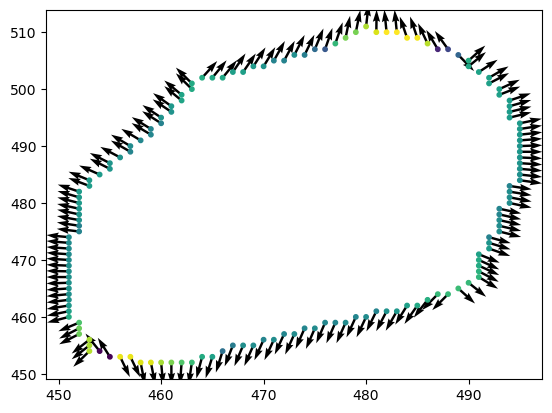

In [776]:
plt.scatter(border_pts[:,0],border_pts[:,1],s=2,c=c,marker='.')
plt.quiver(border_pts[:,0],border_pts[:,1],v[:,1,0],v[:,1,1])
plt.scatter(border_pts[:,0],border_pts[:,1],s=40,c=c,marker='.')

In [799]:
import importlib;importlib.reload(spatial)

<module 'spatial' from '/home/copperma/anaconda3/envs/cellpose_celltraj_env/lib/python3.8/site-packages/spatial.py'>

In [787]:
border_pts[:,0:2].shape

(150, 2)

In [788]:
n

array([[-9.68047467e-01, -2.50767025e-01,  0.00000000e+00],
       [-9.79924621e-01, -1.99368344e-01,  0.00000000e+00],
       [-9.88167377e-01, -1.53379384e-01,  0.00000000e+00],
       [-9.92861230e-01, -1.19275222e-01,  0.00000000e+00],
       [-9.95757590e-01, -9.20153355e-02,  0.00000000e+00],
       [-9.97918870e-01, -6.44820081e-02,  0.00000000e+00],
       [-9.99439838e-01, -3.34665679e-02,  0.00000000e+00],
       [-9.99999929e-01,  3.76908967e-04,  0.00000000e+00],
       [-9.99751949e-01,  2.22719603e-02,  0.00000000e+00],
       [-9.99145258e-01,  4.13370817e-02,  0.00000000e+00],
       [-9.97983418e-01,  6.34751714e-02,  0.00000000e+00],
       [-9.97589839e-01,  6.93866997e-02,  0.00000000e+00],
       [-9.97470544e-01,  7.10810353e-02,  0.00000000e+00],
       [-9.96378311e-01,  8.50309492e-02,  0.00000000e+00],
       [-9.95481265e-01,  9.49581592e-02,  0.00000000e+00],
       [-8.89105216e-01, -4.57702868e-01,  0.00000000e+00],
       [-8.89105216e-01, -4.57702868e-01

In [668]:
w

array([[ 70.41897432,  22.51488832,   0.        ],
       [ 70.74115708,  22.49684679,   0.        ],
       [ 72.34236493,  21.45580778,   0.        ],
       [ 72.34236493,  21.45580778,   0.        ],
       [ 74.7315161 ,  20.4071726 ,   0.        ],
       [ 81.07142618,  17.1948374 ,   0.        ],
       [ 70.74115708,  22.49684679,   0.        ],
       [ 81.07142618,  17.1948374 ,   0.        ],
       [ 85.53076308,  15.62038884,   0.        ],
       [ 85.53076308,  15.62038884,   0.        ],
       [ 85.53076308,  15.62038884,   0.        ],
       [ 72.12317625,  21.22297354,   0.        ],
       [ 85.53076308,  15.62038884,   0.        ],
       [ 96.16165007,  12.32517051,   0.        ],
       [ 70.9352682 ,  22.17357246,   0.        ],
       [101.9482745 ,  11.07552056,   0.        ],
       [106.76250386,  10.03935414,   0.        ],
       [113.57759479,   8.42879606,   0.        ],
       [ 72.12317625,  21.22297354,   0.        ],
       [120.23260442,   8.25364

In [584]:
v

array([[[ 0.48709422, -0.87334942,  0.        ],
        [ 0.87334942,  0.48709422, -0.        ],
        [ 0.        ,  0.        ,  1.        ]],

       [[ 0.48709422, -0.87334942,  0.        ],
        [ 0.87334942,  0.48709422, -0.        ],
        [ 0.        ,  0.        ,  1.        ]],

       [[ 0.33032108, -0.94386863,  0.        ],
        [ 0.94386863,  0.33032108, -0.        ],
        [ 0.        ,  0.        ,  1.        ]],

       ...,

       [[ 0.16663313, -0.98601896,  0.        ],
        [ 0.98601896,  0.16663313, -0.        ],
        [ 0.        ,  0.        ,  1.        ]],

       [[ 0.26990015, -0.96288832,  0.        ],
        [ 0.96288832,  0.26990015, -0.        ],
        [ 0.        ,  0.        ,  1.        ]],

       [[ 0.37421878, -0.92734045,  0.        ],
        [ 0.92734045,  0.37421878, -0.        ],
        [ 0.        ,  0.        ,  1.        ]]])

In [585]:
w

array([[1.39663864e+01, 2.45158232e+00, 0.00000000e+00],
       [1.39663864e+01, 2.45158232e+00, 0.00000000e+00],
       [1.47137302e+01, 2.12220732e+00, 0.00000000e+00],
       [1.57115347e+01, 1.81190278e+00, 0.00000000e+00],
       [1.70132124e+01, 1.33053760e+00, 0.00000000e+00],
       [1.82996646e+01, 9.46429146e-01, 0.00000000e+00],
       [1.38835669e+01, 2.47580806e+00, 0.00000000e+00],
       [2.01092532e+01, 5.58715504e-01, 0.00000000e+00],
       [2.13467200e+01, 2.58748768e-01, 0.00000000e+00],
       [2.25652628e+01, 2.94112185e-01, 0.00000000e+00],
       [2.31179296e+01, 1.28164186e-01, 0.00000000e+00],
       [1.45617318e+01, 2.16873700e+00, 0.00000000e+00],
       [2.33438182e+01, 8.97755073e-02, 0.00000000e+00],
       [2.33438182e+01, 8.97755073e-02, 0.00000000e+00],
       [1.59015053e+01, 1.65318223e+00, 0.00000000e+00],
       [2.29737620e+01, 1.47331797e-01, 0.00000000e+00],
       [2.28500069e+01, 1.34368121e-01, 0.00000000e+00],
       [2.28500069e+01, 1.34368

In [607]:
n[39,:]

array([-0., -0., -1.])

In [606]:
np.where(n[:,0]==0.)

(array([39, 41, 43, 45, 47, 49]),)

In [594]:
npts=border_pts.shape[0]

In [608]:
w[39,:]

array([21.25,  0.  ,  0.  ])

In [621]:
rand_dx=np.array([np.random.normal(loc=0.,scale=0.1,size=npts),np.random.normal(loc=0.,scale=0.1,size=npts),np.random.normal(loc=0.,scale=0.1,size=npts)]).T

In [615]:
rand_dx.shape

(162, 3)

In [622]:
border_pts=border_pts+rand_dx

In [611]:
border_pts[39,:]

array([ 1.44024654e+02,  7.90825409e+02, -4.77902800e-02])

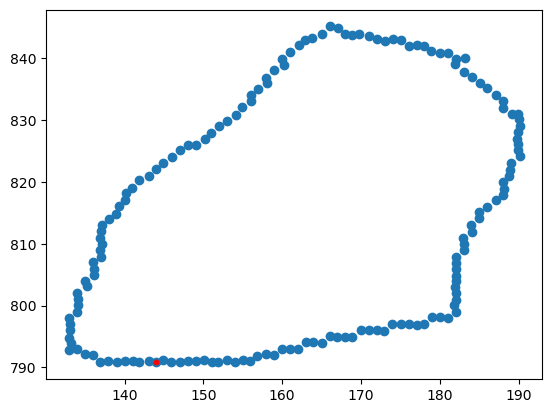

In [613]:
plt.scatter(border_pts[:,0],border_pts[:,1])
plt.scatter(border_pts[39,0],border_pts[39,1],s=10,c='red')